<div style="background-color:#0a2b45; color:white; padding:25px; border-radius:10px; 
            text-align:center; font-family:'Segoe UI', sans-serif;">

  <h1 style="margin-bottom:8px;">Amazing International Airlines Inc. ✈️</h1>
  <h3 style="margin-top:0; font-style:italic; font-weight:normal; color:#aad8e6;">
    Final Preprocessing, Clustering and Profiling 
  </h3>

  <hr style="width:60%; border:1px solid #2fa6c9; margin:15px auto;">

  <p style="margin:5px 0; font-size:15px;">
    <b>Group 4</b> - Data Mining Project (2025/2026)
  </p>
  <p style="margin:0; font-size:13px; color:#b5c6d0;">
    Master in Data Science and Advanced Analytics - Nova Information Management School
  </p>
</div>

<br>

<div style="background-color:#132e3e; color:#e2e8f0; padding:15px 20px; border-left:5px solid #2fa6c9; 
            border-radius:6px; font-family:'Segoe UI', sans-serif; font-size:14px;">

  <b>👩‍💻 Project Authors</b><br>
  Pedro Santos - 20250399 - <a href="mailto:20250399@novaims.unl.pt" style="color:#80d0e0;">20250399@novaims.unl.pt</a><br>
  Miguel Correia - 20250381 - <a href="mailto:20250381@novaims.unl.pt" style="color:#80d0e0;">20250381@novaims.unl.pt</a><br>
  Pedro Fernandes - 20250418 - <a href="mailto:20250418@novaims.unl.pt" style="color:#80d0e0;">20250418@novaims.unl.pt</a><br>
  Tiago Duarte - 20250360 - <a href="mailto:20250360@novaims.unl.pt" style="color:#80d0e0;">20250360@novaims.unl.pt</a>
</div>

<div style="text-align:right; font-size:12px; color:#9ca3af;">
  Last updated: January 2026
</div>


In [1]:
import pandas as pd
import numpy as np
from collections import Counter
from math import ceil, pi

import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import RegularPolygon, Circle
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib import colors as mpl_colors

from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, estimate_bandwidth, MeanShift
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.base import clone
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.neighbors import NearestNeighbors

from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from scipy.spatial.distance import squareform

from minisom import MiniSom

import plotly.graph_objects as go

from itertools import product
import warnings
warnings.filterwarnings('ignore')

%config InlineBackend.figure_format = 'retina'
sns.set_style("whitegrid")
sns.set_palette("deep")  

plt.rcParams['figure.figsize'] = (10, 6)
plt.rcParams['font.size'] = 10

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

np.random.seed(42)

Now we will use the merged dataset to analyse possible clusters

In [2]:
df = pd.read_csv('data/Customer_Flights_merged.csv')
pd.set_option('display.max_columns', None)
df.set_index('Loyalty#', inplace=True)
df.head()


,Province or State,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType,IsActive,Tenure,TotalFlights,TotalFlightsWithCompanions,TotalPointsAccumulated,TotalPointsRedeemed,RedeemRatio,Flights_January,Flights_February,Flights_March,Flights_April,Flights_May,Flights_June,Flights_July,Flights_August,Flights_September,Flights_October,Flights_November,Flights_December,Flights_2019,Flights_2020,Flights_2021
Loyalty#,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
123928,Quebec,male,Bachelor,Rural,28264.0,Divorced,Star,2021-12-30,NaN,4624.56,Standard,True,0.0,0,0,0.00,0.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
857845,Newfoundland,male,College,Suburban,40632.8,Single,Nova,2021-12-30,NaN,3945.59,Standard,True,0.0,196,29,39169.57,0.0,0.0,15,9,21,3,5,38,3,18,22,15,3,44,49,59,88
948961,Ontario,male,Bachelor,Urban,94303.0,Married,Nova,2021-12-30,NaN,7908.45,Standard,True,0.0,0,0,0.00,0.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
647393,Quebec,male,College,Rural,46336.2,Married,Nova,2021-12-30,NaN,8356.18,Standard,True,0.0,0,0,0.00,0.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
170982,Quebec,male,High School or Below,Rural,14072.0,Divorced,Nova,2021-12-30,NaN,24127.50,Standard,True,0.0,0,0,0.00,0.0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [3]:
# Define metric features (continuous numerical variables for clustering)
metric_features = [
    'Income', 'Customer Lifetime Value', 'Tenure', 
    'TotalFlights', 'TotalFlightsWithCompanions',
    'TotalPointsAccumulated', 'TotalPointsRedeemed', 'RedeemRatio',
    'Flights_January', 'Flights_February', 'Flights_March', 'Flights_April',
    'Flights_May', 'Flights_June', 'Flights_July', 'Flights_August',
    'Flights_September', 'Flights_October', 'Flights_November', 'Flights_December',
    'Flights_2019', 'Flights_2020', 'Flights_2021'
]

# Define non-metric features (categorical for profiling)
non_metric_features = [
    'Province or State', 'Gender', 'Education', 'Location Code',
    'Marital Status', 'LoyaltyStatus', 'EnrollmentType', 'IsActive'
]

# 1. Preprocessing

Before clustering and manipulating our data, we need to finish the preprocessing steps required. On the first notebook, and because it was needed to analyse and study the merged dataset, we pre processed most of the features that needed it. In this notebook, we will complete the remaining preprocessing steps, namely handling any residual missing values, treating multivariate outliers, applying the chosen scaling methodology, and finalising the feature set that will be used for the clustering stage.

In [4]:
df.describe(include = "all")

,Province or State,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType,IsActive,Tenure,TotalFlights,TotalFlightsWithCompanions,TotalPointsAccumulated,TotalPointsRedeemed,RedeemRatio,Flights_January,Flights_February,Flights_March,Flights_April,Flights_May,Flights_June,Flights_July,Flights_August,Flights_September,Flights_October,Flights_November,Flights_December,Flights_2019,Flights_2020,Flights_2021
count,16757,16757,16757,16757,16757.000000,16757,16757,16757,2068,16757.000000,16757,16757,16757.000000,16757.000000,16757.000000,16737.000000,16737.000000,15239.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000,16757.000000
unique,11,2,5,3,NaN,3,3,2449,1192,NaN,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Ontario,female,Bachelor,Suburban,NaN,Married,Star,2015-04-03,2020-07-07,NaN,Standard,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,5413,8422,10483,5667,NaN,9743,7686,34,8,NaN,15613,14689,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,49803.844531,NaN,NaN,NaN,NaN,7980.239299,NaN,NaN,2.987933,137.962702,33.585248,28633.064152,8391.945246,0.292096,8.067255,8.030316,10.958047,9.411231,11.649699,14.343558,16.007340,13.991168,11.201945,10.600585,9.995405,13.706153,39.091365,46.673808,52.197529
std,NaN,NaN,NaN,NaN,22160.195396,NaN,NaN,NaN,NaN,6861.796826,NaN,NaN,2.036346,79.069858,22.330489,16365.767353,8562.127476,0.265730,8.698256,8.480886,11.312610,9.595076,11.683862,14.293602,15.267031,13.408756,10.613483,9.942577,9.402154,12.482332,27.827971,32.857739,28.538424
min,NaN,NaN,NaN,NaN,10037.000000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,30855.000000,NaN,NaN,NaN,NaN,3964.730000,NaN,NaN,1.000000,69.000000,15.000000,14309.000000,0.000000,0.064628,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,7.000000,8.000000,36.000000
50%,NaN,NaN,NaN,NaN,48237.000000,NaN,NaN,NaN,NaN,5773.900000,NaN,NaN,2.800000,159.000000,34.000000,33075.520000,6351.700000,0.246498,5.000000,6.000000,8.000000,7.000000,9.000000,11.000000,13.000000,11.000000,9.000000,9.000000,8.000000,11.000000,45.000000,54.000000,57.000000
75%,NaN,NaN,NaN,NaN,65247.000000,NaN,NaN,NaN,NaN,8936.820000,NaN,NaN,4.800000,199.000000,50.000000,41283.050000,13418.600000,0.442077,14.000000,14.000000,19.000000,16.000000,20.000000,24.000000,27.000000,23.000000,19.000000,18.000000,17.000000,22.000000,61.000000,72.000000,72.000000


## 1.1 Redundant Information

Removing Temporal Variables

CancellationDate
- 87.7% missing values (14,689 out of 16,757 records)
- Redundant with IsActive boolean variable
- Absolute dates are not suitable for clustering algorithms

EnrollmentDateOpening
- Already captured by Tenure variable (years since enrollment)
- 2,449 unique values add unnecessary dimensionality
- Relative time (Tenure) is more relevant than absolute date for behavioral patterns

So, our decision was to drop both these features.

In [5]:
# Drop temporal variables
df.drop(columns=['CancellationDate', 'EnrollmentDateOpening'], inplace=True)

## 1.2 Missing Values

### 1.2.1 Point-related features

In [6]:
print(df.isna().sum()[df.isna().sum() > 0])

TotalPointsAccumulated      20
TotalPointsRedeemed         20
RedeemRatio               1518
dtype: int64


In [7]:
df = df.dropna(subset=['TotalPointsAccumulated', 'TotalPointsRedeemed'])

Removing Records with Missing Flight Data

- 20 records (0.12% of dataset) have missing values across these variables
- These customers have no flight history or behavioral data
- Cannot perform clustering without behavioral information
- Dropping these records does not significantly impact dataset size (16,757 to 16,737)

It is not of our interest to cluster clients without any kind of flights or activity within the scope of the business.

### 1.2.2 ReedemRatio

In [8]:
# Impute RedeemRatio missing values with 0
# These are customers who never redeemed points
df['RedeemRatio'] = df['RedeemRatio'].fillna(0)

Handling RedeemRatio Missing Values

- 1,518 missing values (9% of dataset) in RedeemRatio
- These represent customers who accumulated points but never redeemed any (TotalPointsRedeemed = 0)
- RedeemRatio is calculated as TotalPointsRedeemed / TotalPointsAccumulated
- Missing values occur when division by zero or when no redemption activity exists
- Imputing with 0 is appropriate as it represents non-redeemers (valid behavioral pattern)

## 1.3 Outliers - Univariate

In [9]:
df_before_outliers = df.copy()

Outlier Detection Methodology

The IQR (Interquartile Range) method was selected for identifying outliers in the dataset. This statistical approach calculates boundaries based on the spread of the middle 50% of data, making it robust against extreme values and suitable for non-normal distributions.

The method computes lower and upper limits using the formula: Q1 - 1.5xIQR and Q3 + 1.5xIQR respectively. According to [Han et al. (2022)](https://datamineaz.org/textbooks/hanDataMiningConceptual.pdf), values falling at least 1.5 × IQR above Q3 or below Q1 are considered suspected outliers, as this threshold captures approximately 99.3% of observations in typical distributions. This approach is analogous to using 3σ (three standard deviations) for normal distributions.

The 1.5 × IQR threshold is particularly appropriate for clustering applications where extreme values can disproportionately influence distance calculations and cluster formation.

In [10]:
# Start by computing the interquartile range
q1 = df[metric_features].quantile(0.25)
q3 = df[metric_features].quantile(0.75)
iqr = q3 - q1

# Now we are going to compute the limits:
lower_lim = q1 - (1.5 * iqr)
upper_lim = q3 + (1.5 * iqr)

print(f"{'Feature':<30} {'Lower Limit':>15} {'Upper Limit':>15}")
print("-" * 60)
for feature in metric_features:
    print(f"{feature:<30} {lower_lim[feature]:>15.2f} {upper_lim[feature]:>15.2f}")

Feature                            Lower Limit     Upper Limit
------------------------------------------------------------
Income                               -20592.50       116763.50
Customer Lifetime Value               -3480.24        16401.25
Tenure                                   -4.70           10.50
TotalFlights                           -126.00          394.00
TotalFlightsWithCompanions              -37.50          102.50
TotalPointsAccumulated               -26152.08        81744.12
TotalPointsRedeemed                  -20127.90        33546.50
RedeemRatio                              -0.63            1.05
Flights_January                         -21.00           35.00
Flights_February                        -21.00           35.00
Flights_March                           -28.50           47.50
Flights_April                           -24.00           40.00
Flights_May                             -30.00           50.00
Flights_June                            -36.00           

In [12]:
def identify_outliers(df, metric_features, lower_lim, upper_lim):
    outliers = {}
    
    for metric in metric_features:
        if metric not in df.columns:
            continue
        
        if metric not in lower_lim.index or metric not in upper_lim.index:
            continue
        
        llim = lower_lim[metric]
        ulim = upper_lim[metric]
        
        outlier_mask = (df[metric] < llim) | (df[metric] > ulim)
        outliers[metric] = df[metric][outlier_mask].tolist()
        
        print(f"Total outliers in {metric}: {len(outliers[metric])}")
    
    outlier_counts = pd.Series(0, index=df.index)
    
    for metric in metric_features:
        if metric not in df.columns or metric not in lower_lim.index or metric not in upper_lim.index:
            continue
        
        llim = lower_lim[metric]
        ulim = upper_lim[metric]
        
        outlier_mask = (df[metric] < llim) | (df[metric] > ulim)
        outlier_counts += outlier_mask.astype(int)
    
    global_outliers = df.index[outlier_counts == len(metric_features)].tolist()
    
    print("-----------------------------")
    print(f"Total global outliers: {len(global_outliers)}")
    
    return outliers, global_outliers

outliers, obvious_outliers = identify_outliers(df, metric_features, lower_lim, upper_lim)

Total outliers in Income: 0
Total outliers in Customer Lifetime Value: 1483
Total outliers in Tenure: 0
Total outliers in TotalFlights: 0
Total outliers in TotalFlightsWithCompanions: 18
Total outliers in TotalPointsAccumulated: 0
Total outliers in TotalPointsRedeemed: 169
Total outliers in RedeemRatio: 0
Total outliers in Flights_January: 4
Total outliers in Flights_February: 0
Total outliers in Flights_March: 0
Total outliers in Flights_April: 0
Total outliers in Flights_May: 0
Total outliers in Flights_June: 0
Total outliers in Flights_July: 0
Total outliers in Flights_August: 0
Total outliers in Flights_September: 0
Total outliers in Flights_October: 0
Total outliers in Flights_November: 0
Total outliers in Flights_December: 0
Total outliers in Flights_2019: 0
Total outliers in Flights_2020: 0
Total outliers in Flights_2021: 5
-----------------------------
Total global outliers: 0


Outlier Analysis by Feature

Most outliers concentrated in few variables:
- Customer Lifetime Value: 1,483 outliers (8.9% of dataset)
- TotalPointsRedeemed: 169 outliers (1.0%)
- TotalFlightsWithCompanions: 18 outliers (0.1%)
- Minimal outliers in temporal features (Flights_January: 4, Flights_2021: 5)
- No global

In [ ]:
filters_iqr = []                                            
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters_iqr.append(df[metric].between(llim, ulim, inclusive='neither'))

filters_iqr_all = pd.concat(filters_iqr, axis=1).all(axis=1)

count_true= len(df[filters_iqr_all])

count_false = len(df[~filters_iqr_all])

print(f"True count: {count_true}")
print(f"False count: {count_false}")

True count: 15077
False count: 1660


- 15,077 records (90.1%) are within limits across all variables
- 1,660 records (9.9%) contain at least one outlier in any feature
- Main contributors: Customer Lifetime Value (1,483), TotalPointsRedeemed (169), TotalFlightsWithCompanions (18)
- Removing these records would reduce dataset by approximately 10% (not desired), so we will winsorize them

In [14]:
for feature in metric_features:
    df[feature] = df[feature].clip(
        lower=lower_lim[feature], 
        upper=upper_lim[feature]
    )

print("Outliers after winsorization:")
for feature in metric_features:
    outlier_count = ((df[feature] < lower_lim[feature]) | 
                     (df[feature] > upper_lim[feature])).sum()
    print(f"{feature}: {outlier_count}")

print(f"\nTotal records preserved: {len(df)}")

Outliers after winsorization:
Income: 0
Customer Lifetime Value: 0
Tenure: 0
TotalFlights: 0
TotalFlightsWithCompanions: 0
TotalPointsAccumulated: 0
TotalPointsRedeemed: 0
RedeemRatio: 0
Flights_January: 0
Flights_February: 0
Flights_March: 0
Flights_April: 0
Flights_May: 0
Flights_June: 0
Flights_July: 0
Flights_August: 0
Flights_September: 0
Flights_October: 0
Flights_November: 0
Flights_December: 0
Flights_2019: 0
Flights_2020: 0
Flights_2021: 0

Total records preserved: 16737


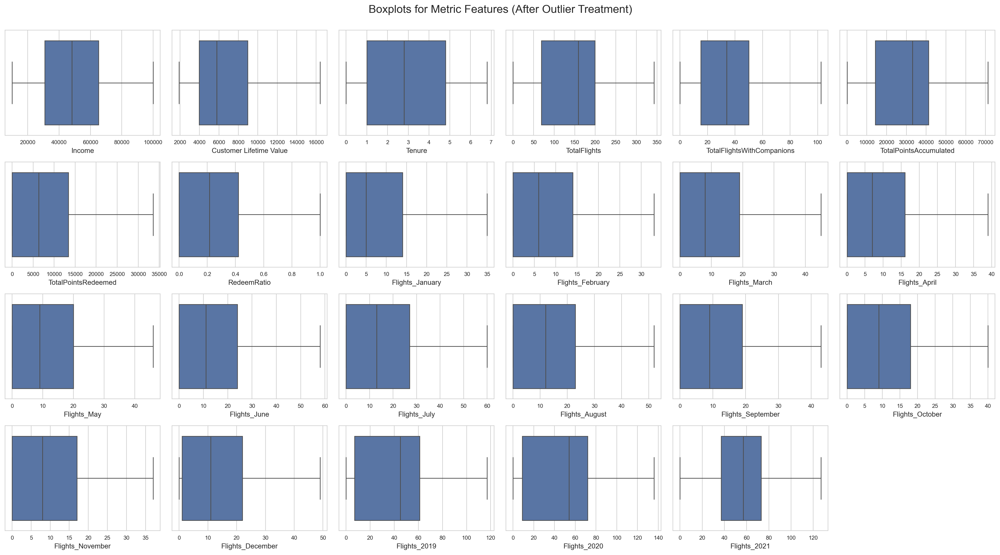

In [16]:
sp_rows = 4
sp_cols = ceil(len(metric_features) / sp_rows)

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(20, 11), tight_layout=True)

for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(x=df[feat], ax=ax)
    ax.set_xlabel(feat, fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=8)

for idx in range(len(metric_features), sp_rows * sp_cols):
    fig.delaxes(axes.flatten()[idx])

plt.suptitle("Boxplots for Metric Features (After Outlier Treatment)", fontsize=16, y=1.00)

plt.show()

After applying the IQR method, the boxplots confirm that outliers were successfully removed. All variables now fall within the boundaries, with no extreme values remaining.

This indicates that the data is clean and well-conditioned for subsequent analyses, particularly clustering, where outliers could distort distance-based results.

## 1.4 Feature Engineering

The flights are discriminated per year and per month, which might also be usefull, mainly for behaviour analysis:

In [17]:
pd.DataFrame(df.columns).tail(15)

,0
16,Flights_January
17,Flights_February
18,Flights_March
19,Flights_April
20,Flights_May
21,Flights_June
22,Flights_July
23,Flights_August
24,Flights_September
25,Flights_October


However, using this features directly in clustering presents several challenges:
- **High dimensionality** - Adding 15 features significantly increases the feature space, which can lead to the curse of dimensionality and reduced clustering performance
- **Redundancy** - Many of these features are highly correlated (e.g., monthly flights sum to yearly totals), creating multicollinearity issues
- **Noise vs. signal** - Raw monthly counts contain noise that obscures underlying behavioral patterns
- **Interpretability** - Clusters based on 15+ temporal features become difficult to interpret and explain to stakeholders

To address the high dimensionality of monthly flight data (12 features), we first tried a correlation-based approach to objectively merge similar months. 

First, we computed the correlation matrix between all monthly flight columns to identify months with similar patterns. Then, we applied hierarchical clustering using Ward's method on the distance matrix (1 - correlation), which groups months based on behavioral similarity rather than arbitrary seasonal boundaries.

The resulting dendrogram allowed us to select an optimal threshold (0.75) that balances granularity and interpretability, yielding 3 distinct temporal periods. This data-driven method reduces dimensionality while preserving meaningful temporal patterns in customer flight behavior.

In [18]:
# Define temporal columns
month_cols = [
    'Flights_January', 'Flights_February', 'Flights_March', 
    'Flights_April', 'Flights_May', 'Flights_June',
    'Flights_July', 'Flights_August', 'Flights_September',
    'Flights_October', 'Flights_November', 'Flights_December'
]
years_cols = ['Flights_2019', 'Flights_2020', 'Flights_2021']

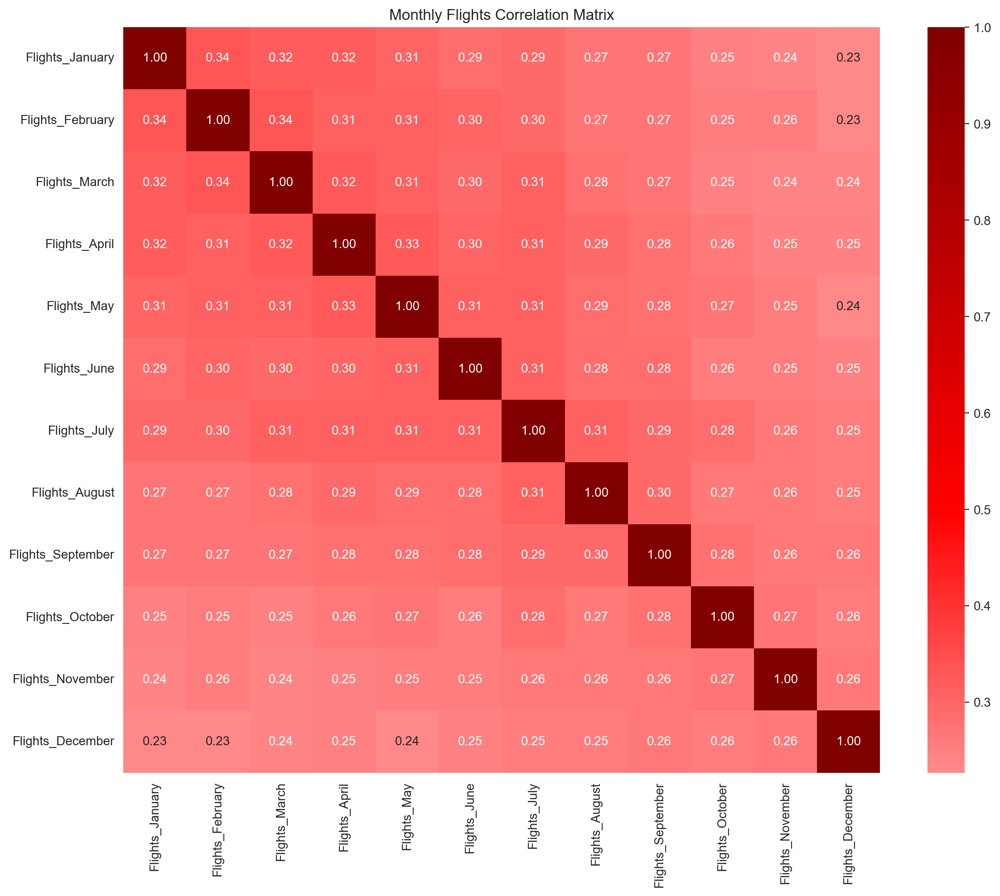

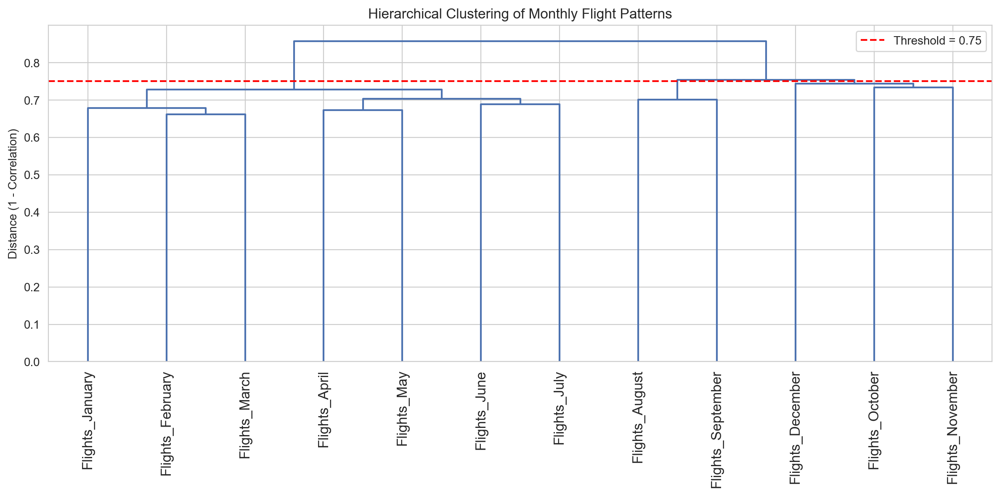

Cluster assignments:
Flights_January: Cluster 1
Flights_February: Cluster 1
Flights_March: Cluster 1
Flights_April: Cluster 1
Flights_May: Cluster 1
Flights_June: Cluster 1
Flights_July: Cluster 1
Flights_August: Cluster 2
Flights_September: Cluster 2
Flights_October: Cluster 3
Flights_November: Cluster 3
Flights_December: Cluster 3


In [ ]:
corr_matrix = df[month_cols].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='seismic', center=0)
plt.title('Monthly Flights Correlation Matrix')
plt.tight_layout()
plt.show()

print(" ")

distance_matrix = 1 - corr_matrix
linkage_matrix = linkage(squareform(distance_matrix), method='ward')

plt.figure(figsize=(12, 6))
dendrogram(linkage_matrix, labels=month_cols, leaf_rotation=90)
plt.title('Hierarchical Clustering of Monthly Flight Patterns')
plt.ylabel('Distance (1 - Correlation)')
plt.axhline(y=0.75, color='r', linestyle='--', label='Threshold = 0.75')
plt.legend()
plt.tight_layout()
plt.show()


clusters = fcluster(linkage_matrix, t=0.75, criterion='distance')
cluster_assignment = dict(zip(month_cols, clusters))
print("Cluster assignments:")
for month, cluster in cluster_assignment.items():
    print(f"{month}: Cluster {cluster}")

---

The dendrogram reveals 3 distinct temporal clusters at threshold 0.75:
- **Cluster 1 (Jan-Jul):** First half of the year shows similar flight patterns
- **Cluster 2 (Aug-Sep):** Summer period forms a separate group  
- **Cluster 3 (Oct-Dec):** End of year exhibits distinct behavior

This objective aggregation reduces 12 monthly features to 3 meaningful periods, capturing seasonal patterns while avoiding arbitrary groupings.

We also engineered derived features that capture the essential behavioral patterns in a more compact and meaningful way. These engineered features distill temporal patterns into interpretable metrics:

**Created features:**
- **avg_monthly_flights** - Average number of flights per month, measuring baseline activity level
- **seasonality_score** - Standard deviation of monthly flights, capturing seasonal travel patterns (high = seasonal traveler, low = year-round traveler)
- **trend%** - Percentage change from 2019 to 2021, showing growth or decline trajectory

These 3 engineered features replace the 15 raw temporal features, providing a more robust and interpretable foundation for clustering while preserving the key behavioral insights.

In [20]:
df['flights_period1'] = df[['Flights_January', 'Flights_February', 'Flights_March',
                              'Flights_April', 'Flights_May', 'Flights_June',
                              'Flights_July']].sum(axis=1)
df['flights_period2'] = df[['Flights_August', 'Flights_September']].sum(axis=1)
df['flights_period3'] = df[['Flights_October', 'Flights_November', 'Flights_December']].sum(axis=1)

df['avg_monthly_flights'] = (df[month_cols].sum(axis=1) / 12).round(2)

monthly_std = df[month_cols].std(axis=1)
monthly_mean = df[month_cols].mean(axis=1)

df['seasonality_score'] = np.where(
    monthly_mean > 0,
    monthly_std / monthly_mean,
    0
).round(2)

df['trend%'] = np.where(
    df['Flights_2019'] > 0,
    ((df['Flights_2021'] - df['Flights_2019']) / df['Flights_2019']) * 100,
    np.where(df['Flights_2021'] > 0, 100, 0)
).round(2)

df.drop(columns=month_cols + years_cols, inplace=True)

df[['flights_period1', 'flights_period2', 'flights_period3',
    'avg_monthly_flights', 'seasonality_score', 'trend%']].head(10)

,flights_period1,flights_period2,flights_period3,avg_monthly_flights,seasonality_score,trend%
Loyalty#,,,,,,
123928,0,0,0,0.00,0.00,0.00
857845,94,40,62,16.33,0.83,79.59
948961,0,0,0,0.00,0.00,0.00
647393,0,0,0,0.00,0.00,0.00
170982,0,0,0,0.00,0.00,0.00
253412,0,0,0,0.00,0.00,0.00
881871,98,13,24,11.25,0.92,62.86
460711,0,0,0,0.00,0.00,0.00
408170,0,0,0,0.00,0.00,0.00


In [21]:
# delete the rows droped above
metric_features = [f for f in metric_features if f not in month_cols + years_cols]

# Add new temporal features to existing metric_features
new_temporal_features = [
    'flights_period1',
    'flights_period2',
    'flights_period3',
    'avg_monthly_flights',
    'seasonality_score',
    'trend%'
]

metric_features.extend(new_temporal_features)

## 1.5 Variable Selection

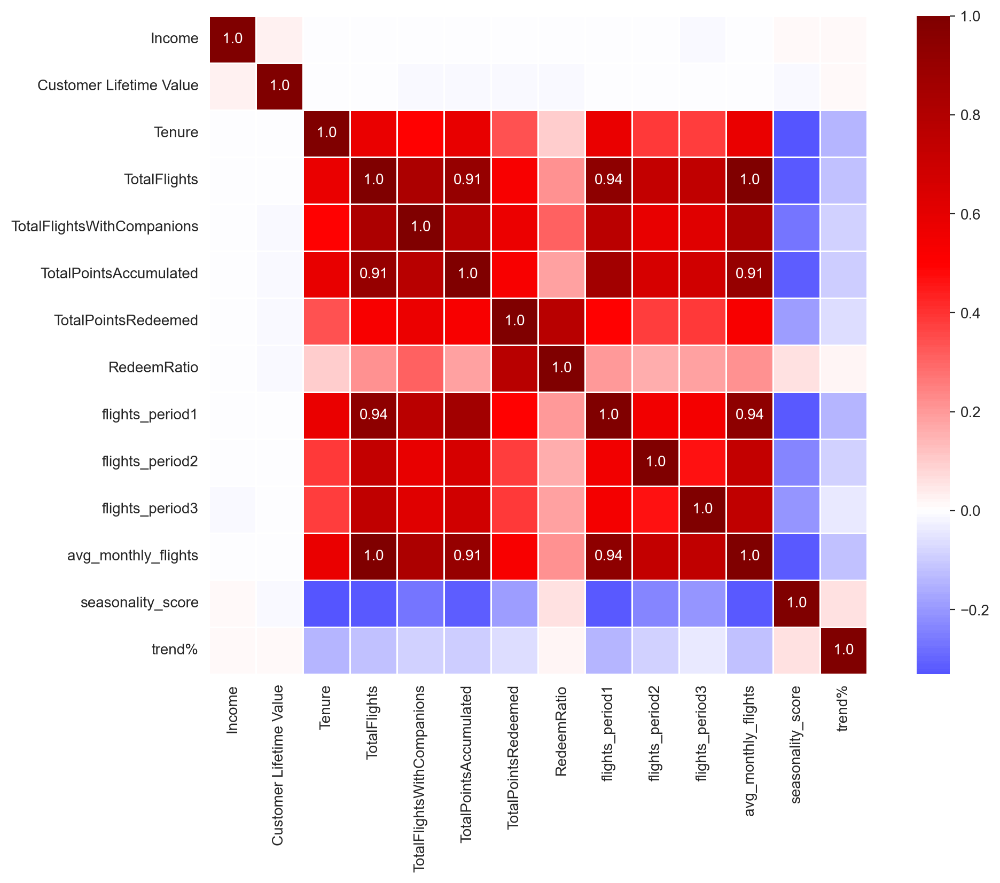

In [22]:
plt.figure(figsize=(12,8))
corr = df[metric_features].corr()
corr = corr.round(2)

sns.heatmap(
    corr,
    center = 0,
    cmap='seismic',
    annot=np.where(np.absolute(corr) >= 0.9, corr.values, np.full(corr.values.shape, "")),
    fmt='s',
    square=True,
    linewidths=.5,
)
plt.show()

Features with correlation > 0.9 were identified and removed to prevent redundancy:

**Removed features:**
- **TotalPointsAccumulated** (0.91 with TotalFlights) - redundant as flights generate points
- **flights_period1** (0.94 with TotalFlights) - subset of total flights
- **TotalFlights** (1.0 with avg_monthly_flights) - avg_monthly_flights is more normalized

In [25]:
features_to_drop = ['TotalPointsAccumulated', 'flights_period1', 'TotalFlights']
metric_features = [f for f in metric_features if f not in features_to_drop]
metric_features

['Income',
 'Customer Lifetime Value',
 'Tenure',
 'TotalFlightsWithCompanions',
 'TotalPointsRedeemed',
 'RedeemRatio',
 'flights_period2',
 'flights_period3',
 'avg_monthly_flights',
 'seasonality_score',
 'trend%']

## 1.6 Scaling

**Feature Scaling**

Why Scale?

Clustering algorithms like K-means and Hierarchical Clustering use distance-based metrics to group observations. Features with larger numerical ranges dominate the distance calculations, leading to biased clusters.

Example: Customer Lifetime Value ranges from 0 to 83,325, while RedeemRatio ranges from 0 to 1. Without scaling, CLV would have approximately 80,000x more influence on distances than RedeemRatio, making the latter virtually irrelevant.

Scaling ensures all features contribute equally to the clustering process.

### StandardScaler Methodology

[StandardScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html) applies Z-score normalization, transforming each feature to have mean = 0 and standard deviation = 1. The standard score of a sample x is calculated as:

$$z = \frac{x - \mu}{\sigma}$$

where:
- $\mu$ is the mean of the training samples
- $\sigma$ is the standard deviation of the training samples

The standard deviation $\sigma$ is calculated as:

$$\sigma = \sqrt{\frac{\sum_{i=1}^{N} (x_i - \bar{x})^2}{N - \text{ddof}}}$$

where:
- $x_i$ = each data point
- $\bar{x}$ = mean of the data
- $N$ = number of observations
- $\text{ddof}$ = delta degrees of freedom (ddof = 0 for population, ddof = 1 for sample)

Properties:
- Centers data around 0
- Standardizes variance across features
- Preserves the shape of the original distribution
- Maintains outlier information

Why StandardScaler over MinMaxScaler?

MinMaxScaler compresses data into [0,1] range but is highly sensitive to outliers. A single extreme value can squeeze the majority of data into a narrow range, losing variance information. StandardScaler preserves the relative spread of data, making it more robust for datasets with natural outliers (e.g., high-value customers).

In [26]:
scaler = StandardScaler()
df[metric_features] = scaler.fit_transform(df[metric_features])
df[metric_features].head()

,Income,Customer Lifetime Value,Tenure,TotalFlightsWithCompanions,TotalPointsRedeemed,RedeemRatio,flights_period2,flights_period3,avg_monthly_flights,seasonality_score,trend%
Loyalty#,,,,,,,,,,,
123928,-0.973912,-0.603743,-1.470114,-1.507944,-0.99401,-0.996412,-1.298282,-1.509618,-1.749105,-1.465181,-0.236183
857845,-0.415536,-0.764430,-1.470114,-0.207219,-0.99401,-0.996412,0.760586,1.215710,0.732332,-0.128213,0.046845
948961,2.007348,0.173430,-1.470114,-1.507944,-0.99401,-0.996412,-1.298282,-1.509618,-1.749105,-1.465181,-0.236183
647393,-0.158062,0.279391,-1.470114,-1.507944,-0.99401,-0.996412,-1.298282,-1.509618,-1.749105,-1.465181,-0.236183
170982,-1.614595,2.183354,-1.470114,-1.507944,-0.99401,-0.996412,-1.298282,-1.509618,-1.749105,-1.465181,-0.236183


## 1.7 Outliers - Multivariate

For multivariate outlier detection, we employ **DBSCAN (Density-Based Spatial Clustering of Applications with Noise)** on all features simultaneously. Unlike univariate methods that analyze features independently, DBSCAN identifies outliers based on **local density** in the multidimensional feature space.

**Rationale:**
- DBSCAN naturally labels low-density points as **noise (-1)**, making it ideal for outlier detection
- Captures **complex multivariate patterns** that univariate methods might miss
- No assumption about data distribution (unlike methods that assume normality)
- Identifies outliers that are distant from dense regions in the combined feature space

Points classified as **noise by DBSCAN** are considered multivariate outliers and will be removed to ensure robust clustering in subsequent analysis.

The **k-distance graph** is a diagnostic tool used to select the optimal `eps` parameter for DBSCAN. It works by:
1. **Computing distances**: For each point, calculate the distance to its k-th nearest neighbor (where k = `min_samples`)
2. **Sorting**: Sort all points by this distance in ascending order
3. **Identifying the elbow**: Look for a sharp increase (elbow/knee) in the curve
    - **Before the elbow** (left side): Points in dense regions with small distances to neighbors (core points of clusters)
    - **At the elbow**: Transition point between dense regions and sparse regions
    - **After the elbow** (right side): Points in sparse regions with large distances (potential outliers/noise)

In [ ]:
# Rule of thumb: min_samples = 2 × number of features
min_samples = 2 * len(metric_features)
print(f"Number of metric features: {len(metric_features)}")
print(f"Recommended min_samples: {min_samples}")

neigh = NearestNeighbors(n_neighbors=min_samples)
neigh.fit(df[metric_features])

distances, _ = neigh.kneighbors(df[metric_features])

distances_sorted = np.sort(distances[:, -1])

Number of metric features: 11
Recommended min_samples: 22


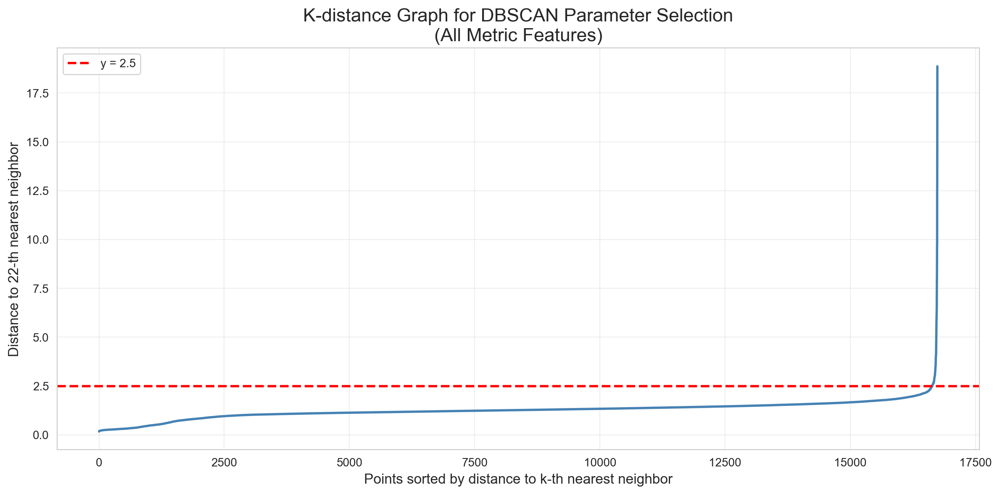

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(distances_sorted, linewidth=2, color='steelblue')

plt.axhline(y=2.5, color='red', linestyle='--', linewidth=2, label='y = 2.5')

plt.title('K-distance Graph for DBSCAN Parameter Selection\n(All Metric Features)', 
          fontsize=16)
plt.xlabel('Points sorted by distance to k-th nearest neighbor', fontsize=12)
plt.ylabel(f'Distance to {min_samples}-th nearest neighbor', fontsize=12)
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

We are going to try and use eps = 2.5:

In [29]:
eps_value = 2.5
min_samples_value = min_samples

print(f"DBSCAN Final Parameters:")
print(f"  eps: {eps_value}")
print(f"  min_samples: {min_samples_value}")
print(f"  n_features: {len(metric_features)}")

dbscan = DBSCAN(
    eps=eps_value,
    min_samples=min_samples_value,
    n_jobs=-1
)

dbscan_labels = dbscan.fit_predict(df[metric_features])

outlier_count = Counter(dbscan_labels)
n_outliers = outlier_count.get(-1, 0)
n_core = len(df) - n_outliers

print("\n" + "="*60)
print("DBSCAN RESULTS (Multivariate Outliers)")
print("="*60)
print(f"Outliers detected (label=-1): {n_outliers:,}")
print(f"Core customers (label≥0): {n_core:,}")
print(f"Percentage of outliers: {n_outliers/len(df)*100:.2f}%")

df_outliers_multivariate = df[dbscan_labels == -1].copy()

df = df[dbscan_labels != -1].copy()

print(f"\n Working with {len(df):,} core customers")
print(f"Multivariate outliers removed: {len(df_outliers_multivariate):,}")
print(f"Data retained: {len(df)/(len(df)+len(df_outliers_multivariate))*100:.1f}%")

DBSCAN Final Parameters:
  eps: 2.5
  min_samples: 22
  n_features: 11

DBSCAN RESULTS (Multivariate Outliers)
Outliers detected (label=-1): 50
Core customers (label≥0): 16,687
Percentage of outliers: 0.30%

 Working with 16,687 core customers
Multivariate outliers removed: 50
Data retained: 99.7%


---

Applied DBSCAN on scaled data to detect multivariate outliers - observations with anomalous feature combinations not captured by univariate methods.

**Parameters:**
- eps = 2.5 (determined via k-distance graph elbow method)
- min_samples = 22 (2 × number of features (rule of thumb described above))

**Results:**
- Outliers detected: 50 (0.30%)
- Core customers retained: 16,687 (99.7%)

The conservative outlier rate indicates the dataset is well-behaved after univariate treatment. The 50 removed observations represent true multivariate anomalies with inconsistent feature combinations. Proceeding with clustering on the cleaned dataset.

---

Now, we are going to see and understand why these values were flagged as outliers, by caracterizing them.

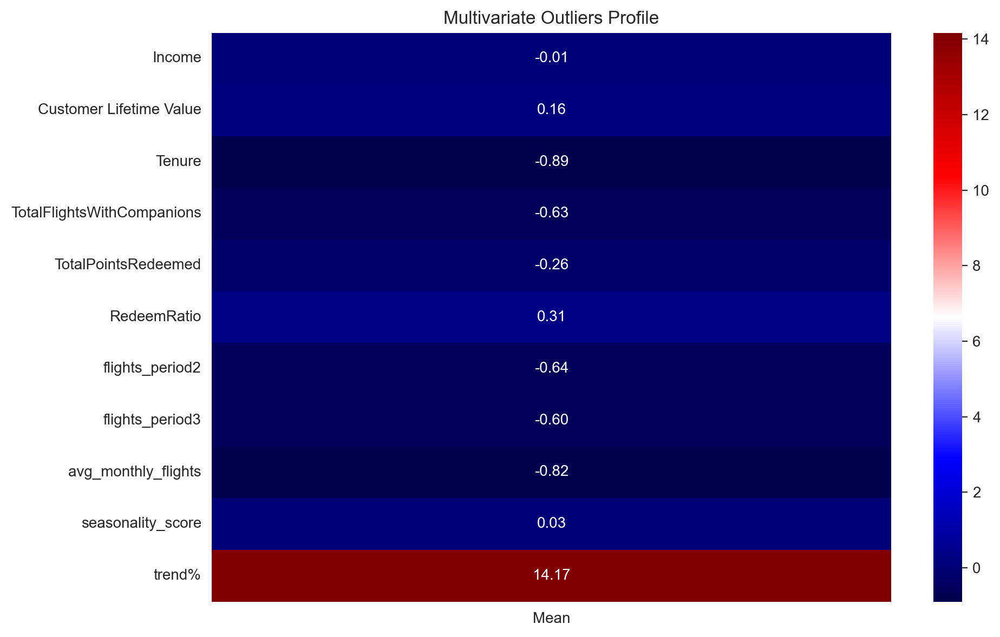

In [ ]:
outliers_profile = df_outliers_multivariate[metric_features].mean().to_frame(name='Mean')

sns.heatmap(outliers_profile, annot=True, fmt='.2f', cmap="seismic")
plt.title('Multivariate Outliers Profile')
plt.tight_layout()
plt.show()

Multivariate Outliers Analysis

**Key Finding**
trend% = 14.17 standard deviations above mean - an extreme statistical anomaly

**Why Flagged as Outliers?** <br>
These customers exhibit contradictory behavior patterns:
- Extremely high growth trend (14.17) - statistically impossible for normal customer behavior
- Low actual flight frequency (-0.82) contradicts the growth signal
- Short tenure (-0.89) means limited historical data
- Declining recent activity (period2: -0.04, period3: -0.60) conflicts with positive trend
- Low engagement across all behavioral metrics (companions, redemptions)

**Interpretation**
- The extreme trend% value (14.17 standard deviations) combined with contradictory behavioral signals indicates these are not typical customers following any recognizable pattern.

These are not invalid customers, but rather edge cases whose extreme volatility and contradictory metrics make them unsuitable for standard marketing strategies. Their behavior is too erratic to define actionable segments or develop targeted campaigns.

Decision: Correctly excluded from clustering - they represent statistical anomalies that cannot be effectively addressed through standard segmentation-based marketing approaches.

In [31]:
# So we can use it to the bonus options
df.to_csv('data/data_preprocessed.csv')

# 2. Clustering

## 2.1 Perspectives Definition

### 2.1.1 Behaviour-Based Segmentation

This describes how the customer interacts with the company and their patterns of engagement.

The features selected were the following:

- **Tenure** - Duration of the customer relationship, measuring loyalty longevity
- **avg_monthly_flights** - Average number of flights per month, measuring baseline travel activity level
- **seasonality_score** - Coefficient of variation of monthly flights, capturing seasonal travel patterns (high = seasonal traveler, low = consistent year-round traveler)
- **trend%** - Percentage change in flight activity from 2019 to 2021, showing growth or decline trajectory in customer engagement
- **TotalFlightsWithCompanions** - Number of flights with companions, indicating social travel behavior
- **flights_period2** - Flight activity during August-September, capturing late summer patterns
- **flights_period3** - Flight activity during October-December, capturing end-of-year patterns

Note: `IsActive`, `LoyaltyStatus`, and `EnrollmentType` are categorical features and were excluded from clustering but will be used for cluster profiling.

In [32]:
behavioral_features = [
    'Tenure', 
    'avg_monthly_flights', 
    'seasonality_score', 
    'trend%',
    'TotalFlightsWithCompanions',
    'flights_period2',
    'flights_period3'
]
df[behavioral_features].head(10)

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
Loyalty#,,,,,,,
123928,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
857845,-1.470114,0.732332,-0.128213,0.046845,-0.207219,0.760586,1.215710
948961,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
647393,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
170982,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
253412,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
881871,-1.470114,-0.039603,0.016760,-0.012648,-0.880008,-0.629150,-0.454652
460711,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
408170,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618


In [33]:
df_behaviour = df[behavioral_features].copy()
df_behaviour.head(10)

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
Loyalty#,,,,,,,
123928,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
857845,-1.470114,0.732332,-0.128213,0.046845,-0.207219,0.760586,1.215710
948961,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
647393,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
170982,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
253412,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
881871,-1.470114,-0.039603,0.016760,-0.012648,-0.880008,-0.629150,-0.454652
460711,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
408170,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618


### 2.1.2 Value-Based Segmentation

This describes how much the customer is worth to the company.

The features selected were the following:

- **Income** - Customer income level, indicating purchasing power and potential lifetime value
- **Customer Lifetime Value** - Total monetary value generated by the customer over their entire relationship with the company
- **TotalPointsRedeemed** - Points redeemed for rewards, indicating actual value extraction and engagement with the loyalty program
- **RedeemRatio** - Ratio of redeemed to accumulated points, measuring program engagement efficiency

In [34]:
value_features = [
    'Income',
    'Customer Lifetime Value',
    'TotalPointsRedeemed',
    'RedeemRatio'
]
df[value_features].head(10)

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
Loyalty#,,,,
123928,-0.973912,-0.603743,-0.994010,-0.996412
857845,-0.415536,-0.764430,-0.994010,-0.996412
948961,2.007348,0.173430,-0.994010,-0.996412
647393,-0.158062,0.279391,-0.994010,-0.996412
170982,-1.614595,2.183354,-0.994010,-0.996412
253412,1.350414,-1.094422,-0.994010,-0.996412
881871,1.087992,-0.967860,0.112632,-0.160147
460711,-1.005838,-0.491496,-0.994010,-0.996412
408170,-0.905023,1.734116,-0.994010,-0.996412


In [35]:
df_value = df[value_features].copy()
df_value.head(10)

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
Loyalty#,,,,
123928,-0.973912,-0.603743,-0.994010,-0.996412
857845,-0.415536,-0.764430,-0.994010,-0.996412
948961,2.007348,0.173430,-0.994010,-0.996412
647393,-0.158062,0.279391,-0.994010,-0.996412
170982,-1.614595,2.183354,-0.994010,-0.996412
253412,1.350414,-1.094422,-0.994010,-0.996412
881871,1.087992,-0.967860,0.112632,-0.160147
460711,-1.005838,-0.491496,-0.994010,-0.996412
408170,-0.905023,1.734116,-0.994010,-0.996412


## 2.2. Clustering Utils / Helper Functions

In [113]:
# Cell 3: Helper functions from Labs 09-12

def get_ss(df, feats):
    """
    Calculate the sum of squares (SS) for the given DataFrame.
    The sum of squares is computed as the sum of the variances of each column
    multiplied by the number of non-NA/null observations minus one.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame for which the sum of squares is to be calculated.
    feats (list of str): A list of feature column names to be used in the calculation.
    
    Returns:
    float: The sum of squares of the DataFrame.
    """
    df_ = df[feats]
    ss = np.sum(df_.var() * (df_.count() - 1))
    return ss

def get_ssw(df, feats, label_col):
    """
    Calculate the sum of squared within-cluster distances (SSW) for a given DataFrame.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the data.
    feats (list of str): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing cluster labels.
    
    Returns:
    float: The sum of squared within-cluster distances (SSW).
    """
    feats_label = feats + [label_col]
    df_k = df[feats_label].groupby(by=label_col).apply(
        lambda col: get_ss(col, feats),
        include_groups=False
    )
    return df_k.sum()


def get_rsq(df, feats, label_col):
    """
    Calculate the R-squared value for a given DataFrame and features.
    
    Parameters:
    df (pd.DataFrame): The input DataFrame containing the data.
    feats (list): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing the labels or cluster assignments.
    
    Returns:
    float: The R-squared value, representing the proportion of variance explained by the clustering.
    """
    df_sst_ = get_ss(df, feats)  # get total sum of squares
    df_ssw_ = get_ssw(df, feats, label_col)  # get ss within
    df_ssb_ = df_sst_ - df_ssw_  # get ss between
    # r2 = ssb/sst
    return (df_ssb_ / df_sst_)


def get_r2_scores(df, feats, clusterer, min_k=1, max_k=9):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        df_concat = pd.concat([df,
                               pd.Series(labels, name='labels', index=df.index)], axis=1)
        r2_clust[n] = get_rsq(df_concat, feats, 'labels')
    return r2_clust

def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

def inertia_and_silhouette_plots(X, min_clusters, max_clusters):
    inertias = []
    silhouettes = []
    ks = list(range(min_clusters, max_clusters + 1))

    for k in ks:
        kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
        labels = kmeans.fit_predict(X)

        inertias.append(kmeans.inertia_)
        silhouettes.append(silhouette_score(X, labels) if k > 1 else np.nan)

    df = pd.DataFrame({
        "k": ks,
        "Inertia": inertias,
        "Silhouette": silhouettes
    })

    fig, ax1 = plt.subplots(figsize=(10, 6))

    sns.lineplot(
        data=df,
        x="k",
        y="Inertia",
        marker="o",
        linewidth=2,
        ax=ax1,
        color="tab:red",
        label="Inertia"
    )

    ax1.set_xlabel("Number of Clusters (k)", fontsize=12)
    ax1.set_ylabel("Inertia", color="tab:red", fontsize=12)
    ax1.tick_params(axis="y", labelcolor="tab:red")
    ax1.grid(True, alpha=0.3)

    ax2 = ax1.twinx()

    sns.lineplot(
        data=df,
        x="k",
        y="Silhouette",
        marker="o",
        linewidth=2,
        ax=ax2,
        color="tab:blue",
        label="Silhouette Score"
    )

    ax2.set_ylabel("Silhouette Score", color="tab:blue", fontsize=12)
    ax2.tick_params(axis="y", labelcolor="tab:blue")

    fig.tight_layout()
    plt.show()


In [37]:
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

In [38]:
hierarchical = AgglomerativeClustering(
    metric='euclidean'
)
hc_methods = ["ward", "complete", "average", "single"]

In [111]:
def plot_hexagons(som_matrix, som, sf, label="", cmap=None, annot_mx=None):
    som_x, som_y = som.get_weights().shape[:2]
    show_cbar = cmap is not None

    if cmap is None:
        colornorm = mpl_colors.Normalize(vmin=np.nanmin(som_matrix), vmax=np.nanmax(som_matrix))
    else:
        if isinstance(cmap, str):
            cmap = sns.color_palette(cmap, as_cmap=True)
        colornorm = mpl_colors.Normalize(vmin=np.nanmin(som_matrix), vmax=np.nanmax(som_matrix))

    ax = sf.subplots(1, 1)

    for i in range(som_x):
        for j in range(som_y):
            if cmap is None:
                color = np.clip(som_matrix[i, j], 0, 1)
            else:
                color = cmap(colornorm(som_matrix[i, j]))

            x0, y0 = som.convert_map_to_euclidean((i, j))
            center = [x0, y0]

            ax.add_patch(
                RegularPolygon(
                    center,
                    numVertices=6,
                    radius=np.sqrt(1 / 3),
                    facecolor=color,
                    edgecolor="white",
                    linewidth=2,
                )
            )

            if annot_mx is not None:
                annot_val = annot_mx[i, j]
                if not isinstance(annot_val, str):
                    if np.isfinite(annot_val) and int(annot_val) == annot_val:
                        annot_val = int(annot_val)
                ax.text(center[0], center[1], annot_val, ha="center", va="center", fontsize="x-small")

    ax.set_title(label)
    ax.set_xlim(-1, som_x)
    ax.set_ylim(-1, som_y)
    ax.set_aspect("equal")
    ax.axis("off")

    if show_cbar:
        divider = make_axes_locatable(ax)
        ax_cb = divider.append_axes("right", size="5%", pad="0%")
        cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
        cmap_sm.set_array([])
        cb1 = colorbar.Colorbar(ax_cb, orientation="vertical", alpha=1, mappable=cmap_sm)
        cb1.ax.get_yaxis().labelpad = 6
        sf.add_axes(ax_cb)

    return ax

In [40]:
def som_grid_search(data, 
                    x_sizes=[7, 11, 15],
                    y_sizes=[7, 11, 15],
                    sigmas=[1.0, 2.0, 3.0],
                    learning_rates=[0.3, 0.5, 0.7],
                    num_iterations=20000,
                    random_seed=42):
    
    best_score = float('inf')
    best_params = None
    
    combinations = list(product(x_sizes, y_sizes, sigmas, learning_rates))
    
    print(f"Testing {len(combinations)} combinations...\n")
    
    for i, (x, y, sigma, lr) in enumerate(combinations, 1):
        
        sm = MiniSom(
            x=x,
            y=y,
            input_len=data.shape[1],
            sigma=sigma,
            learning_rate=lr,
            neighborhood_function='gaussian',
            topology='hexagonal',
            random_seed=random_seed
        )
        
        sm.random_weights_init(data)
        
        qe_before = sm.quantization_error(data)
        te_before = sm.topographic_error(data)
        
        sm.train_batch(data, num_iteration=num_iterations, verbose=False)
        
        qe_after = sm.quantization_error(data)
        te_after = sm.topographic_error(data)
        
        qe_norm = qe_after / qe_before
        te_norm = te_after / te_before

        score = 0.7 * qe_norm + 0.3 * te_norm

        qe_improvement = (1 - qe_after/qe_before) * 100 if qe_before > 0 else 0
        te_improvement = (1 - te_after/te_before) * 100 if te_before > 0 else 0
        
        print(f"[{i}/{len(combinations)}] x={x}, y={y}, sigma={sigma}, lr={lr}")
        print(f"  Before: QE={qe_before:.4f}, TE={te_before:.4f}")
        print(f"  After:  QE={qe_after:.4f}, TE={te_after:.4f}")
        print(f"  Improvement: QE={qe_improvement:.1f}%, TE={te_improvement:.1f}%")
        print(f"  Score:  {score:.4f}")
        
        if score < best_score:
            best_score = score
            best_params = {
                'x': x,
                'y': y,
                'sigma': sigma,
                'learning_rate': lr,
                'qe_before': qe_before,
                'te_before': te_before,
                'qe_after': qe_after,
                'te_after': te_after,
                'qe_improvement_%': qe_improvement,
                'te_improvement_%': te_improvement,
                'combined_score': score
            }
    
    print("="*70)
    print("BEST PARAMETERS FOUND:")
    print("="*70)
    print(f"x = {best_params['x']}, y = {best_params['y']}")
    print(f"sigma = {best_params['sigma']}")
    print(f"learning_rate = {best_params['learning_rate']}")
    
    print(f"\nAFTER training:")
    print(f"  Quantization Error (QE): {best_params['qe_after']:.4f}")
    print(f"  Topographic Error (TE):  {best_params['te_after']:.4f}")
    
    print(f"\nIMPROVEMENT:")
    print(f"  QE: {best_params['qe_before']:.4f} -> {best_params['qe_after']:.4f} ({best_params['qe_improvement_%']:.1f}%)")
    print(f"  TE: {best_params['te_before']:.4f} -> {best_params['te_after']:.4f} ({best_params['te_improvement_%']:.1f}%)")
    print(f"  Combined Score: {best_params['combined_score']:.4f}")

In [108]:
def compare_models(models_dict, cluster_column="cluster_labels"):
    scores = []
    n_clusters = []
    model_names = []

    for model_name, df in models_dict.items():
        feats = [
            c for c in df.columns
            if c != cluster_column and pd.api.types.is_numeric_dtype(df[c])
        ]

        if not feats:
            raise ValueError(f"[{model_name}] No numeric feature columns found to compute R².")

        scores.append(get_rsq(df, feats, cluster_column))
        n_clusters.append(df[cluster_column].nunique())
        model_names.append(model_name)

    results = pd.DataFrame({
        "Model": model_names,
        "R2": scores,
        "Clusters": n_clusters
    }).sort_values("R2", ascending=False)

    sns.set_palette("deep")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    sns.barplot(
        data=results,
        x="Model",
        y="R2",
        ax=ax1
    )

    for i, v in enumerate(results["R2"]):
        ax1.text(
            i, v + 0.02,
            f"{v:.3f}",
            ha="center", va="bottom",
            fontsize=11, fontweight="bold"
        )

    ax1.set_ylim(0, 1.1)
    ax1.set_ylabel("R² Score", fontsize=14, fontweight="bold")
    ax1.set_title("Model Performance (R-Squared)", fontsize=16, fontweight="bold", pad=20)
    ax1.tick_params(axis="x", rotation=45)
    ax1.grid(axis="y", alpha=0.3, linestyle="--")
    ax1.set_axisbelow(True)

    sns.barplot(
        data=results,
        x="Model",
        y="Clusters",
        ax=ax2
    )

    for i, v in enumerate(results["Clusters"]):
        ax2.text(
            i, v + 0.2,
            f"{int(v)}",
            ha="center", va="bottom",
            fontsize=11, fontweight="bold"
        )

    ax2.set_ylabel("Number of Clusters", fontsize=14, fontweight="bold")
    ax2.set_title("Cluster Count by Model", fontsize=16, fontweight="bold", pad=20)
    ax2.tick_params(axis="x", rotation=45)
    ax2.grid(axis="y", alpha=0.3, linestyle="--")
    ax2.set_axisbelow(True)

    plt.tight_layout()
    plt.show()

## 2.3 Behaviour-Based Segmentation

### 2.3.1 K-means and Hierarchical clustering

To determine the optimal number of clusters for **both behavioral and value perspectives**, we evaluate multiple clustering approaches using the **$R^2$ metric**, which measures the proportion of variance explained by the clustering solution.

**Methodology:**

We compare five different clustering methods across $K=1$ to $K=8$ clusters for each perspective:

1. **K-means** (k-means++ initialization, 20 restarts)
2. **Hierarchical Clustering** with four linkage methods:
   - **Ward**: Minimizes within-cluster variance 
   - **Complete**: Maximum distance between clusters 
   - **Average**: Mean distance between all pairs 
   - **Single**: Minimum distance between clusters 

After selecting the optimal K for each perspective independently, we will **merge the two segmentations** using **Hierarchical Clustering** on the combined centroids to create a unified customer segmentation that captures both value and behavioral patterns.

In [42]:
r2_scores_BB = {}

r2_scores_BB['kmeans'] = get_r2_scores(df_behaviour, behavioral_features, kmeans)

for link in hc_methods:
    r2_scores_BB[link] = get_r2_scores(
        df_behaviour,
        behavioral_features,
        hierarchical.set_params(linkage=link) 
    )

In [43]:
r2_scores_BB = pd.DataFrame(r2_scores_BB)
r2_scores_BB

,kmeans,ward,complete,average,single
1,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.434496,0.419817,0.019870,0.014872,0.000112
3,0.530586,0.515356,0.374877,0.125055,0.188346
4,0.599566,0.565912,0.461921,0.483208,0.188535
5,0.647566,0.604108,0.486119,0.484516,0.188636
6,0.684776,0.640963,0.515476,0.569550,0.188710
7,0.710495,0.666067,0.526507,0.569694,0.188830
8,0.733501,0.690909,0.539241,0.572611,0.188939


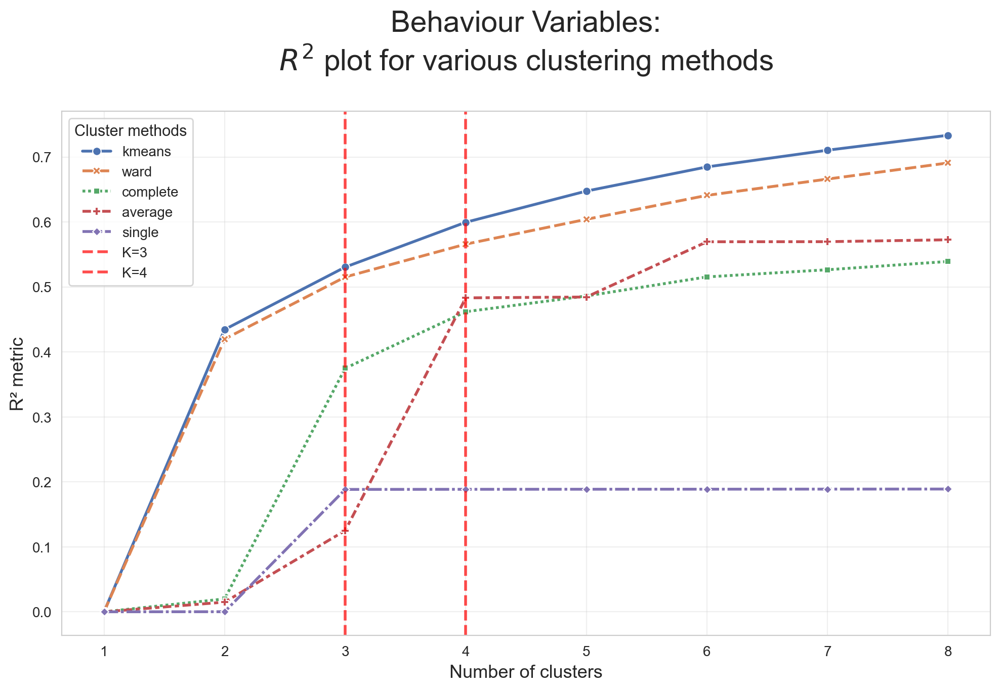

In [112]:
plt.figure(figsize=(10, 7))

sns.lineplot(
    data=r2_scores_BB,
    linewidth=2,
    markers=True
)

plt.axvline(
    x=3,
    color="red",
    linestyle="--",
    linewidth=2,
    alpha=0.7,
    label="K=3"
)

plt.axvline(
    x=4,
    color="red",
    linestyle="--",
    linewidth=2,
    alpha=0.7,
    label="K=4"
)

plt.title(
    "Behaviour Variables:\n$R^2$ plot for various clustering methods\n",
    fontsize=21
)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

We conclude by the elbow rule that the best methods are Kmeans and Hierarchical Clustering using Ward and that we are between 3 and 4 clusters, but there is no well-defined elbow. 

To complement the R² analysis and validate the optimal number of clusters, we employ two additional metrics:

This function evaluates K-means clustering performance (our best model) across K=2 to K=8 clusters using two key metrics:

1. **Inertia (Within-Cluster Sum of Squares)**:
   - Measures the **compactness** of clusters
   - **Lower values** indicate tighter, more cohesive clusters

2. **Silhouette Score**:
   - Measures how well each point fits within its assigned cluster compared to other clusters
   - Ranges from **-1 to +1**:
     - **+1**: Point is well-matched to its cluster and far from others
     - **0**: Point is on the boundary between clusters
     - **-1**: Point may be assigned to the wrong cluster
   - **Higher values** indicate better-defined clusters

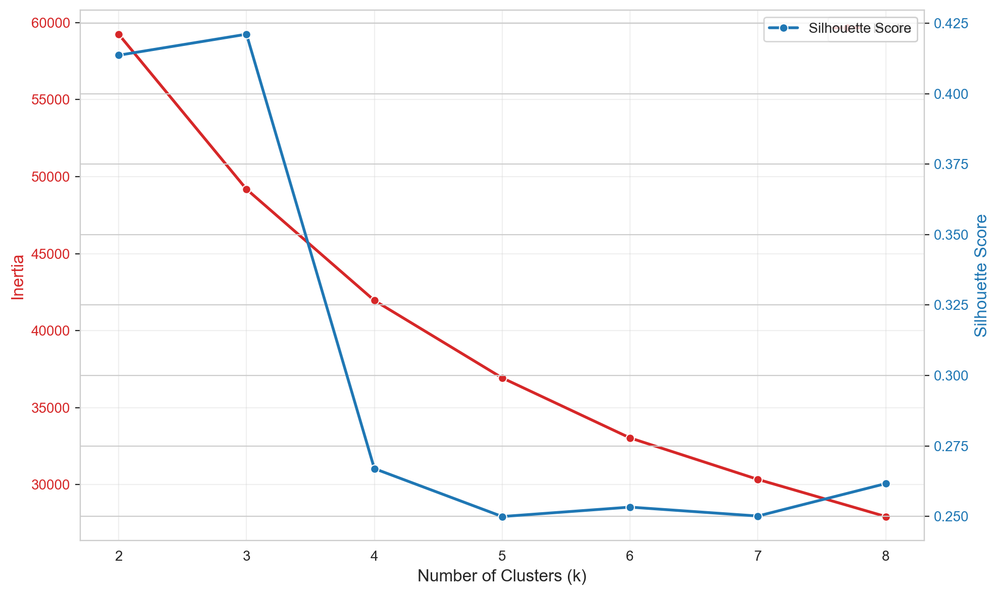

In [114]:
inertia_and_silhouette_plots(df_behaviour,2,8)

This methods identified $K=3$ as the optimal point where inertia reduction slows substantially. The silhouette score indicates moderate but acceptable cluster separation. Both metrics converge at $K=3$ as the optimal solution,although $K=4$ is also acceptible.

**$K=3$ is the way to go now.**

In [46]:
kmeans_data = df_behaviour.values.copy()

In [47]:
kmeans_behaviour = KMeans(
    n_clusters=3,
    init='k-means++',
    n_init=20,
    random_state=42
)
kmeans_behaviour.fit(kmeans_data)

kmeans_labels = kmeans_behaviour.labels_
cluster_centers = kmeans_behaviour.cluster_centers_

kmeans_n_clusters = len(np.unique(kmeans_labels))
print(f"Number of clusters: {kmeans_n_clusters}")

Number of clusters: 3


In [48]:
df_behavior_KM_clusters = df_behaviour.copy()
df_behavior_KM_clusters['cluster_labels_behavior'] = kmeans_labels

cluster_kmeans_behavior = df_behavior_KM_clusters[list(behavioral_features) + ['cluster_labels_behavior']].groupby('cluster_labels_behavior').mean()
cluster_kmeans_behavior

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
cluster_labels_behavior,,,,,,,
0,-0.981468,-1.039825,1.213578,0.252706,-0.910541,-0.790177,-0.729839
1,0.447070,0.614130,-0.240640,-0.122835,0.534151,0.462604,0.469101
2,-0.661905,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618


In [49]:
cluster_pct = (
    df_behavior_KM_clusters["cluster_labels_behavior"]
    .value_counts(normalize=True)
    .sort_index()
    .mul(100)
    .round(2)
)

cluster_dist = pd.DataFrame({
    "count": df_behavior_KM_clusters["cluster_labels_behavior"].value_counts().sort_index(),
    "pct_%": cluster_pct
})

cluster_dist


,count,pct_%
cluster_labels_behavior,,
0,4025,24.12
1,11160,66.88
2,1502,9.00


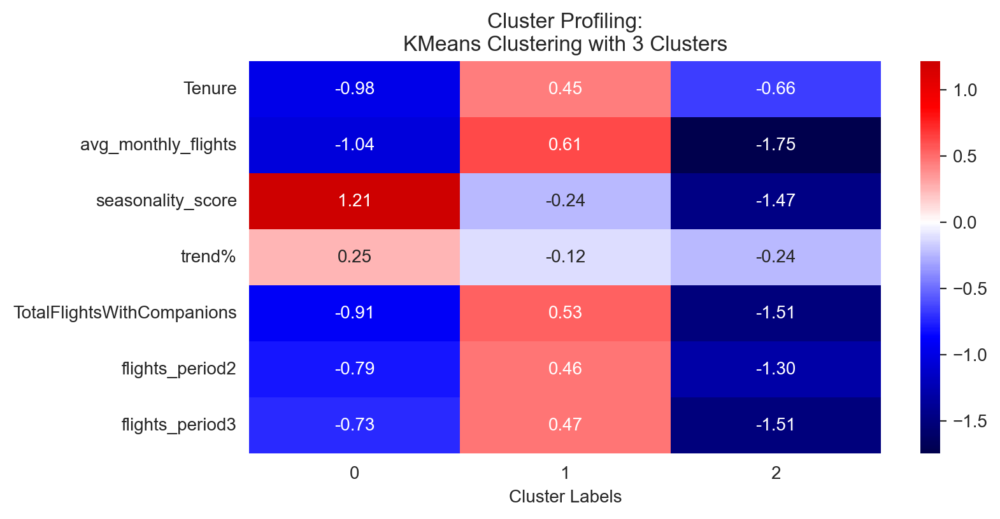

In [50]:
fig, ax = plt.subplots(figsize=(8,4))

sns.heatmap(cluster_kmeans_behavior.T,
            center=0, annot=True, cmap="seismic", fmt=".2f",
            ax=ax 
            )

ax.set_xlabel("Cluster Labels")
ax.set_title("Cluster Profiling:\nKMeans Clustering with 3 Clusters")
plt.show()

**Cluster 0: Seasonal Emerging Travelers (24.1%)**
* **Characteristics:**
   * **Tenure**: -0.98 (low) -> Relatively newer customers
   * **avg_monthly_flights**: -1.04 (low) -> Low flight frequency
   * **seasonality_score**: **+1.21 (high)** -> Strong seasonal travel patterns
   * **trend%**: +0.25 (low positive) -> Growing engagement
   * **TotalFlightsWithCompanions**: -0.91 (low) -> Mostly solo travelers
   * **flights_period2/3**: -0.79/-0.73 (low) -> Consistent low activity across periods
* **Profile:** Seasonal travelers with emerging loyalty, likely leisure-focused with predictable travel patterns (e.g., annual vacations, holiday trips).

**Cluster 1: Active Engaged Travelers (66.9%)** 
* **Characteristics:**
   * **Tenure**: +0.45 (moderate-high) -> Established customers
   * **avg_monthly_flights**: **+0.61 (high)** -> High flight frequency
   * **seasonality_score**: -0.24 (low) -> Consistent year-round travel
   * **trend%**: -0.12 (stable/slightly declining) -> Mature, stable engagement
   * **TotalFlightsWithCompanions**: **+0.53 (high)** -> Frequent group/family travel
   * **flights_period2/3**: +0.46/+0.47 (moderate-high) -> Sustained activity
* **Profile:** Core customer segment with high engagement, regular business/leisure travelers, stable revenue contributors with companion bookings.

**Cluster 2: Inactive Low-Engagement Customers (9%)**
* **Characteristics:**
   * **Tenure**: -0.66 (low) -> Newer customers
   * **avg_monthly_flights**: **-1.75 (very low)** -> Minimal flight activity
   * **seasonality_score**: **-1.47 (very low)** -> No seasonal patterns
   * **trend%**: -0.24 (negative) -> Declining engagement from low baseline
   * **TotalFlightsWithCompanions**: **-1.51 (very low)** -> Solo, infrequent travelers
   * **flights_period2/3**: -1.30/-1.51 (very low) -> Consistently low activity
* **Profile:** Low-engagement segment with minimal activity from the start. Newer customers who never fully activated, showing declining interest even within their short tenure. Potential failed acquisitions or dormant accounts requiring activation campaigns or acceptance as low-priority segment.

**Key Insights:**
1. **Cluster 0** (24.1%) shows **growth potential** (positive trend, seasonal loyalty)
2. **Cluster 1** (66.9%) represents the **highest-value behavioral segment** (frequent, consistent, group travel)
3. **Cluster 2** (9%) requires **activation intervention** (never engaged, declining from already-low baseline)

### 2.3.2 Self-Organizing Map

In this clustering approach, we employ a **two-stage dimensionality reduction and clustering pipeline** that leverages Self-Organizing Maps (SOMs) for non-linear feature compression before applying K-means clustering.

**Methodology:**

The approach consists of two sequential stages:

**Stage 1: SOM Training (Per Perspective)**
- Train separate Self-Organizing Maps for **value features** and **behavioral features**
- SOMs perform **topology-preserving dimensionality reduction**, mapping high-dimensional customer data onto a 2D grid of neurons
- Each neuron represents a prototype customer profile, with the SOM preserving neighborhood relationships from the original feature space

**Stage 2: K-means on SOM Neurons (Per Perspective)**
- Apply **K-means clustering** to the trained SOM neurons (not original customers)
- Evaluate $K=1$ to $K=8$ clusters using the **$R^2$ metric** for both perspectives
- Select optimal $K$ based on elbow analysis and silhouette scores
- Each customer is assigned to the cluster of their Best Matching Unit (BMU) neuron

In [51]:
som_data = df_behaviour.values

To identify the optimal Self-Organizing Map configuration for each perspective, we conduct a comprehensive grid search across key hyperparameters that govern the SOM's learning behavior and topological structure.

**Search Space:**


- **Grid dimensions (x, y)**: [15×15, 20×20, 25×25, 30x30]
  - Defines the SOM lattice size, controlling the number of neurons (prototypes)
  - Larger grids capture finer-grained patterns but increase computational cost
  - Range selected to balance granularity (100-625 neurons) with dataset size (16,164 customers)

- **Sigma (neighborhood radius)**: [0.5, 1.0, 2.0, 3.0]
  - Controls the extent of lateral interaction during learning
  - Higher sigma promotes global ordering; lower sigma enables local refinement
  - Decay over training transitions from exploration (broad neighborhoods) to exploitation (narrow neighborhoods)

- **Learning rate**: [0.1, 0.3, 0.5, 0.7]
  - Governs the magnitude of weight updates during training
  - Higher rates (0.5-0.7) enable rapid initial convergence
  - Moderate rates (0.1-0.3) balance speed and stability
  - Lower rates (0.05) provide conservative fine-tuning
  - Range spans from cautious (0.05) to aggressive (0.7) to identify optimal learning dynamics

- **Training iterations**: 20,000 (fixed)
  - Sufficient iterations for convergence across all parameter combinations
  - Enables meaningful comparison by holding training duration constant

**Evaluation Methodology:**

Each configuration undergoes a complete training cycle with error metrics measured before and after training:

**Quantization Error (QE):**
- Average Euclidean distance between each data point and its Best Matching Unit (BMU)
- Lower QE indicates better data representation fidelity
- Sensitive to grid granularity: larger grids typically achieve lower QE by providing more prototypes

**Topographic Error (TE):**
- Proportion of data points whose first and second BMUs are non-adjacent on the grid
- Lower TE indicates better topology preservation (neighborhood relationships maintained)
- Penalizes configurations that create discontinuities in the feature-to-map projection

**Combined Score Calculation:**

For each configuration, we compute a normalized composite score:

$$\text{Score} = 0.7 \times \frac{\text{QE}_{\text{after}}}{\text{QE}_{\text{before}}} + 0.3 \times \frac{\text{TE}_{\text{after}}}{\text{TE}_{\text{before}}}$$

**Rationale for score components:**

1. **Normalization by baseline** ($\frac{\text{Error}_{\text{after}}}{\text{Error}_{\text{before}}}$):
   - Dividing post-training error by pre-training error measures **relative improvement** rather than absolute values
   - Enables fair comparison across different grid sizes (larger grids naturally have lower absolute QE)
   - Values < 1.0 indicate improvement; smaller values indicate greater improvement

2. **Weighted combination** (70% QE, 30% TE):
   - Prioritizes **data fidelity** (QE) as the primary objective - the SOM must accurately represent customer patterns
   - Maintains **topological consistency** (TE) as a secondary constraint - spatial relationships should be preserved for interpretability
   - Weight allocation reflects that quantization quality is more critical than perfect topology for clustering applications

3. **Minimization objective**:
   - Lower combined score indicates better overall performance
   - Optimal configuration achieves the best trade-off between compressing customer data (low QE) and maintaining meaningful spatial structure (low TE)

In [52]:
'''som_grid_search(
    data=som_data,
    x_sizes=[15, 20, 25, 30],
    y_sizes=[15, 20, 25, 30],
    sigmas=[0.5, 1.0, 2.0, 3.0],
    learning_rates=[0.1, 0.3, 0.5, 0.7],
    num_iterations=20000,
    random_seed=42
)'''

'som_grid_search(\n    data=som_data,\n    x_sizes=[15, 20, 25, 30],\n    y_sizes=[15, 20, 25, 30],\n    sigmas=[0.5, 1.0, 2.0, 3.0],\n    learning_rates=[0.1, 0.3, 0.5, 0.7],\n    num_iterations=20000,\n    random_seed=42\n)'

Now, we will train the Self-Organizing Map with the best combination:
- x = 15
- y = 15
- sigma = 1
- learning_rate = 0.1

In [53]:
som_behaviour = MiniSom(
    x=15,            
    y=15,             
    input_len=len(df_behaviour.columns),
    sigma=1,                           
    learning_rate=0.1,                 
    neighborhood_function='gaussian',     
    topology='hexagonal',
    random_seed=42                          
)

som_behaviour.random_weights_init(som_data)

som_behaviour.train_batch(
    som_data, 
    num_iteration=20_000, 
    verbose=False
    )

qe_after = som_behaviour.quantization_error(som_data)
te_after = som_behaviour.topographic_error(som_data)
print(f"Quantization Error (QE): {qe_after:.4f}")
print(f"Topographic Error (TE):  {te_after:.4f}")

Quantization Error (QE): 0.6882
Topographic Error (TE):  0.3763


#### 2.3.2.1 Component Planes

Component Planes are individual visualizations of a Self-Organizing Map (SOM) that display the distribution of each input feature across the trained neuron grid.
Each component plane represents a single dimension (feature) of the input space, showing how the weight values for that specific feature are distributed across all neurons in the SOM topology.

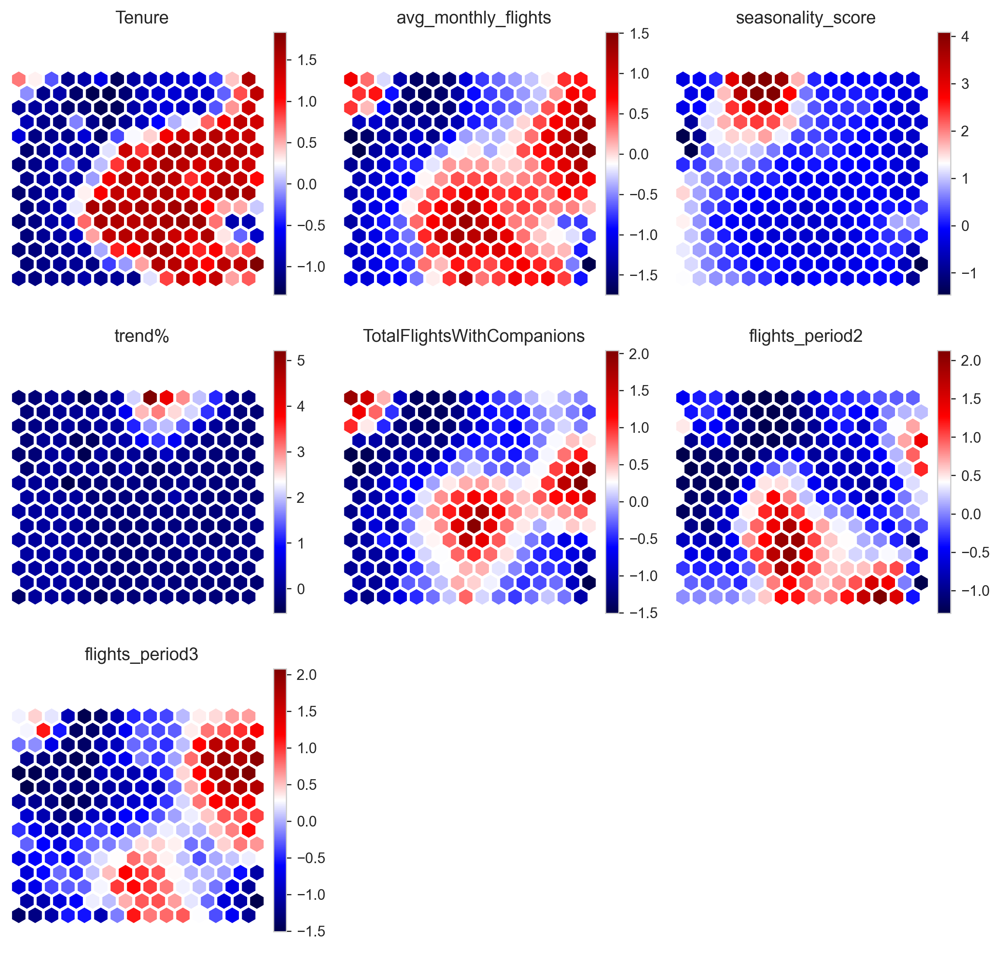

In [115]:
cmap = cm.seismic

weights = som_behaviour.get_weights()
n_features = weights.shape[2] 

fig = plt.figure(figsize=(9, 9), constrained_layout=True, dpi=128)
subfigs = fig.subfigures(3, 3, wspace=.15)

for cpi in range(n_features):
    sf = subfigs.flatten()[cpi]
    matrix_vals = weights[:,:,cpi]
    
    sf = plot_hexagons(matrix_vals, 
                       som_behaviour, sf, 
                       label=behavioral_features[cpi],
                       cmap=cmap, 
                       annot_mx=None)

plt.show()

**Uniform Features:**
- **trend%**: Blue (near 0) across grid except top-center spike (+5)
- **seasonality_score**: Blue (near 0) except top-right hotspot (+4)

**Outlier Locations:**
- **trend%**: Top-center red spike (+5), high-growth segment
- **seasonality_score**: Top-right corner (+4), extreme seasonal travelers
- **TotalFlightsWithCompanions**: Top-left red spots and in center region (+2), heavy group travelers

**Positive Correlations:**
- **Tenure and avg_monthly_flights**: Similar diagonal patterns (established = frequent)
- **flights_period2 and flights_period3**: Identical patterns (stable behavior)
- **TotalFlightsWithCompanions and avg_monthly_flights**: Overlapping center-right (frequent flyers travel with companions)

**Negative Correlations:**
- **Tenure and trend%**: High tenure = stable, low tenure = growth spike
- **seasonality_score and avg_monthly_flights**: Seasonal hotspot in low-frequency zone

**Customer Segments:**
1. **High Value Frequent Travellers** *(bottom right concentration)*: long tenure, high monthly flights, strong consistency across recent periods, travel with companions, high loyalty potential.
2. **Emerging Active Users** *(upper centre and nearby warm areas)*: shorter tenure, clear positive trend in recent flight activity, rising engagement, good candidates for loyalty development.
3. **Low Activity Occasional Flyers** *(mostly blue regions across maps)*: low monthly flights, weak seasonality, few companion trips, limited variation over time, low current engagement and higher churn risk.

#### 2.3.2.2 U-Matrix

U-Matrix (Unified Distance Matrix) displays the distances between adjacent neurons, revealing the underlying cluster structure of the trained map.

The U-Matrix represents the average distance between each neuron and its immediate neighbors in the SOM grid. High values (typically shown in warm colors) indicate large distances between neurons, suggesting cluster boundaries, while low values (cool colors) represent similar neurons within the same cluster.

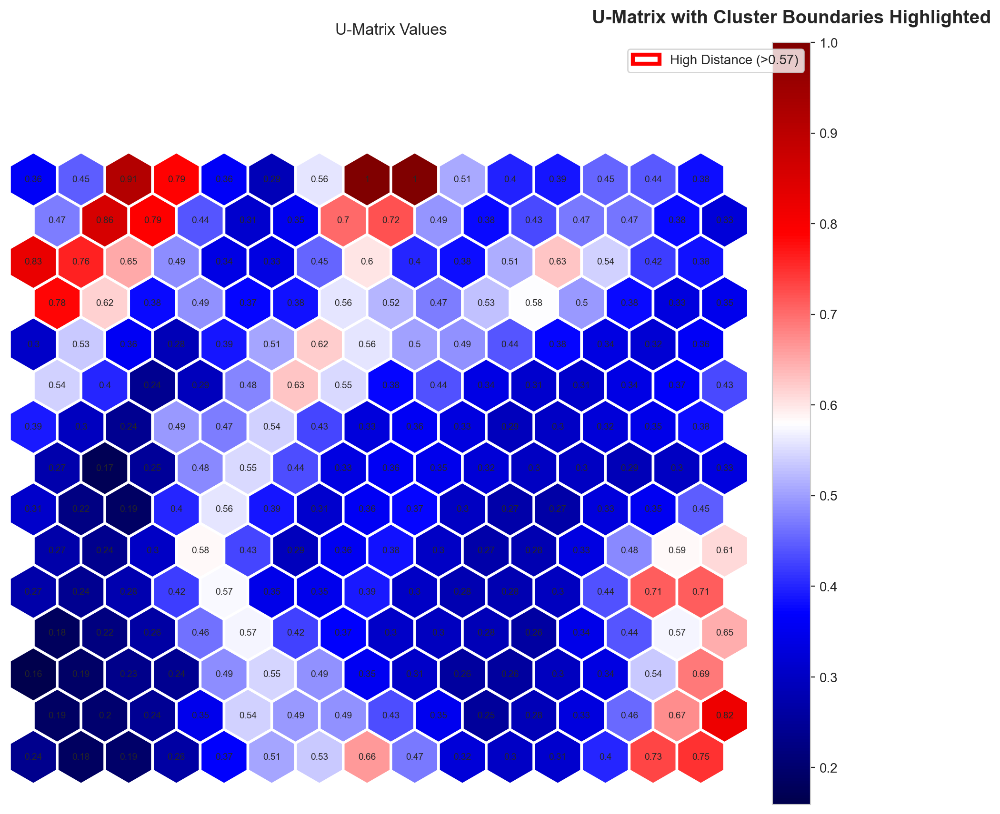

U-matrix statistics:
Mean: 0.417
Std: 0.157
Threshold (mean + std): 0.574
High-distance neurons: 31 / 225 (13.8%)


In [117]:
umatrix = som_behaviour.distance_map(scaling='mean')

threshold = umatrix.mean() + umatrix.std()

high_distance_mask = umatrix > threshold

fig = plt.figure(figsize=(9, 9))
plot_hexagons(umatrix, som_behaviour, sf=fig, label="U-Matrix Values",
              cmap=cm.seismic, annot_mx=np.round(umatrix, 2))

ax = plt.gca()
for i in range(umatrix.shape[0]):
    for j in range(umatrix.shape[1]):
        if high_distance_mask[i, j]:
            x = j + 0.5 * (i % 2)
            y = i * np.sqrt(3) / 2
            circle = plt.Circle((x, y), 0.4, color='red', fill=False, 
                              linewidth=3, alpha=0.8)
            ax.add_patch(circle)

legend_circle = Circle((0, 0), 0.4, color='red', fill=False, linewidth=3, label=f'High Distance (>{threshold:.2f})')
ax.legend(handles=[legend_circle], loc='upper right', fontsize=10)

plt.title('U-Matrix with Cluster Boundaries Highlighted', fontsize=14, fontweight='bold', pad=15)
plt.tight_layout()
plt.show()

print(f"U-matrix statistics:")
print(f"Mean: {umatrix.mean():.3f}")
print(f"Std: {umatrix.std():.3f}")
print(f"Threshold (mean + std): {threshold:.3f}")
print(f"High-distance neurons: {high_distance_mask.sum()} / {umatrix.size} ({100*high_distance_mask.sum()/umatrix.size:.1f}%)")

---

**Clusters**
**Three clusters**, separated by high-distance boundaries.

1. **Cluster A (centre–right)**: main dense group, average profiles, largest segment.
2. **Cluster B (bottom–left)**: compact low-distance area, uniform low-activity or low-value users.
3. **Cluster C (upper–left)**: distinct region with higher variation, associated with stronger behavioural or value signals.

**Outliers**
**Locations**: top-centre red cells, scattered upper-left edges, bottom-right isolated points.

#### 2.3.2.3 Hits Map

The Hits Map displays the distribution of data points across the trained neurons, revealing the density and popularity of different regions in the map.

The Hits Map represents the number of data points (customers) for which each neuron serves as the Best Matching Unit (BMU). High values (typically shown in warm colors) indicate frequently activated neurons with many assigned customers, while low values (cool colors) represent sparsely populated or "dead" neurons with few or no assignments.

In [56]:
bmus = np.array([som_behaviour.winner(x) for x in som_data])
print(f"BMUs shape (clients,SOM position): {bmus.shape}")
print(bmus[:10])

BMUs shape (clients,SOM position): (16687, 2)
[[0 9]
 [4 1]
 [0 9]
 [0 9]
 [0 9]
 [0 9]
 [3 4]
 [0 9]
 [0 9]
 [0 9]]


In [57]:
hitsmatrix = som_behaviour.activation_response(df[behavioral_features].values)
np.flip(np.round(hitsmatrix,2), axis=1).T

array([[  79.,  112.,  167.,    2.,   58.,   22.,   14.,    4.,   42.,
          26.,   18.,   26.,   48.,  209.,   57.],
       [ 375.,  234.,    2.,    5.,  130.,  161.,    0.,   26.,   21.,
          19.,   35.,   72.,  175.,   87.,   38.],
       [ 236.,  149.,   18.,   63.,   16.,   40.,   86.,   13.,   35.,
          28.,   57.,  158.,  240.,  202.,   40.],
       [   0.,   47.,   56.,   36.,   62.,  170.,   30.,   48.,   19.,
          26.,  124.,   80.,   57.,   43.,   54.],
       [ 260.,    0.,   33.,   49.,   69.,   76.,   12.,   36.,   90.,
          45.,   67.,   34.,   42.,   62.,   70.],
       [1012.,   16.,    9.,   24.,   28.,   27.,   48.,   91.,   40.,
          51.,   42.,   48.,   53.,   68.,  123.],
       [   0.,    5.,   39.,   55.,   46.,   27.,   71.,   37.,   48.,
          50.,   33.,   41.,   66.,   52.,   97.],
       [  51.,   37.,   35.,   60.,  107.,   54.,   47.,   75.,   44.,
          51.,   98.,   52.,   40.,   47.,  224.],
       [ 104.,   50.,   

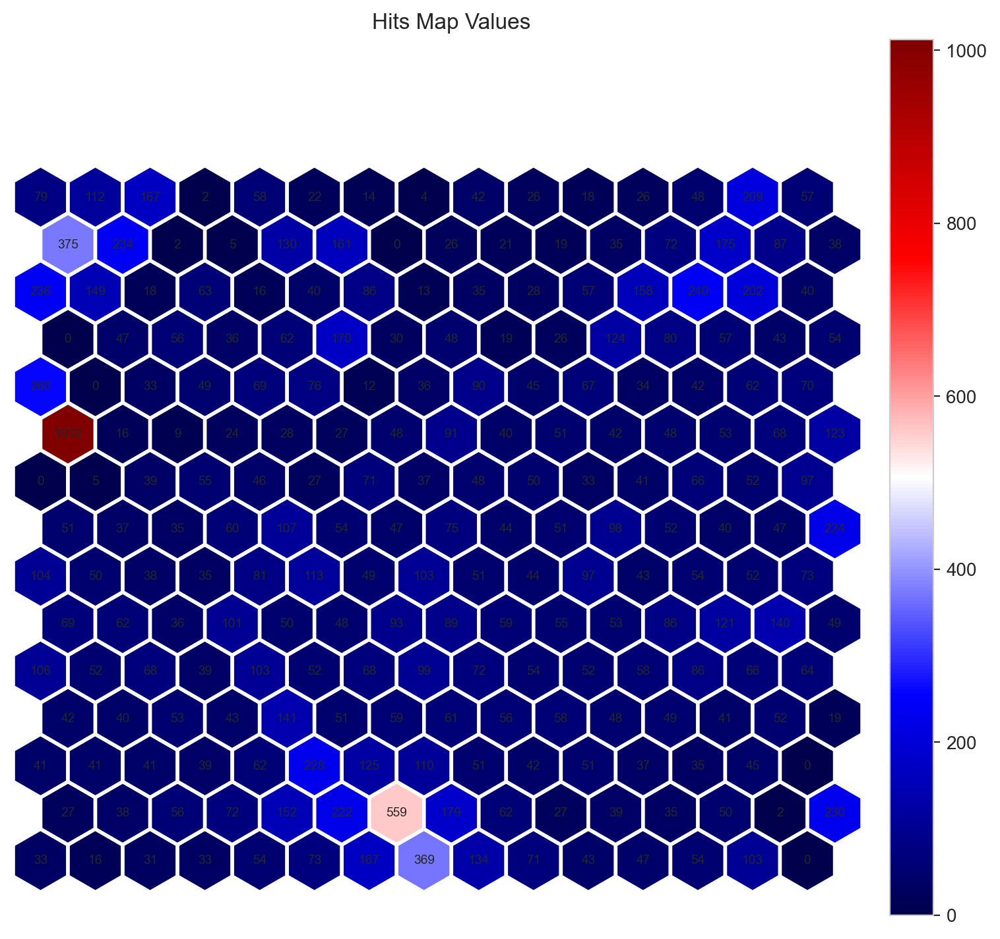

In [118]:
fig = plt.figure(figsize=(9, 9))
plot_hexagons(hitsmatrix, som_behaviour, sf=fig, label="Hits Map Values",
              cmap=cm.seismic, annot_mx=np.round(hitsmatrix, 0).astype(int))
plt.show()

In [59]:
non_zero_hits = hitsmatrix[hitsmatrix > 0]
low_threshold = np.percentile(non_zero_hits, 10)

low_density_mask = (hitsmatrix > 0) & (hitsmatrix <= low_threshold)

low_positions = np.argwhere(low_density_mask)
print(f"Low-density threshold: {low_threshold:.1f}")
print(f"Low-density neuron positions: {low_positions.tolist()}")

low_units = {tuple(pos) for pos in low_positions}

low_idx = [i for i, b in enumerate(bmus) if tuple(b) in low_units]
print(f"Customers in low-density neurons: {len(low_idx)}")

low_customers = df_behaviour.iloc[low_idx]

print("\nSummary statistics of low-density customers:")
low_customers.describe().T

Low-density threshold: 26.0
Low-density neuron positions: [[1, 0], [1, 8], [1, 9], [2, 9], [2, 12], [2, 13], [3, 9], [3, 13], [3, 14], [4, 12], [5, 14], [6, 10], [6, 14], [7, 12], [7, 13], [7, 14], [8, 11], [8, 13], [9, 11], [9, 13], [9, 14], [10, 14], [11, 14], [13, 1], [14, 3]]
Customers in low-density neurons: 380

Summary statistics of low-density customers:


,count,mean,std,min,25%,50%,75%,max
Tenure,380.0,-0.760645,0.517387,-1.420971,-1.126113,-0.880398,-0.732969,1.822466
avg_monthly_flights,380.0,-0.902324,0.464091,-1.736949,-1.229417,-0.913349,-0.545616,0.200487
seasonality_score,380.0,0.885238,1.289288,-0.740319,0.012733,0.483893,1.160431,4.108205
trend%,380.0,1.181233,1.468843,-0.591790,0.119424,0.503355,2.490148,4.671192
TotalFlightsWithCompanions,380.0,-0.755129,0.521249,-1.507944,-1.160337,-0.835155,-0.341777,0.555275
flights_period2,380.0,-0.717329,0.493258,-1.298282,-1.195339,-0.783565,-0.320320,0.812058
flights_period3,380.0,-0.652111,0.652131,-1.509618,-1.201919,-0.696415,-0.146954,1.303624


In [60]:
print(f"Average customers per unit: {hitsmatrix.mean():.1f}")

Average customers per unit: 74.2


In [61]:
print(f"Frequency range: {hitsmatrix.min():.0f} (least) to {hitsmatrix.max():.0f} (most)")

Frequency range: 0 (least) to 1012 (most)


---

**Distribution**
Customers are **not evenly distributed** across the grid.  
Counts range from **0 to 1012** customers per unit, with most neurons holding far fewer than the average (**~74 customers/unit**).

**Empty units**
Yes. Several neurons have **0 customers**, indicating unused regions of the map.

**Highest-density units**
The **densest unit** is located at **(5,0)** with **1012 customers**, showing a strong concentration of similar profiles.

**Lowest-density units**
Low-density neurons (non-zero hits below the 10th percentile, threshold ≤26 customers) include positions such as:  
`(1,0), (1,8), (2,12), (3,9), (5,14), (7,12), (8,11), (9,13), (14,3)`  
A total of **380 customers (~2.3% of the population)** fall into these neurons.

**Characterisation of customers in low-density units**
These customers show **consistently below-average engagement**, combined with **emerging behaviour signals**:
- **low tenure, low flight frequency, low companion travel** (negative standardized values across usage dimensions)
- **higher seasonality and positive trend** (above-average temporal dynamics)

In summary, they represent **rare and low-activity profiles** with **sporadic or rising usage patterns**, indicating **latent potential but weak current value**.


#### 2.3.2.4 SOM clustering with K-means

Here, we will cluster the neurals of each cluster using K-Means with the methods we explained before.

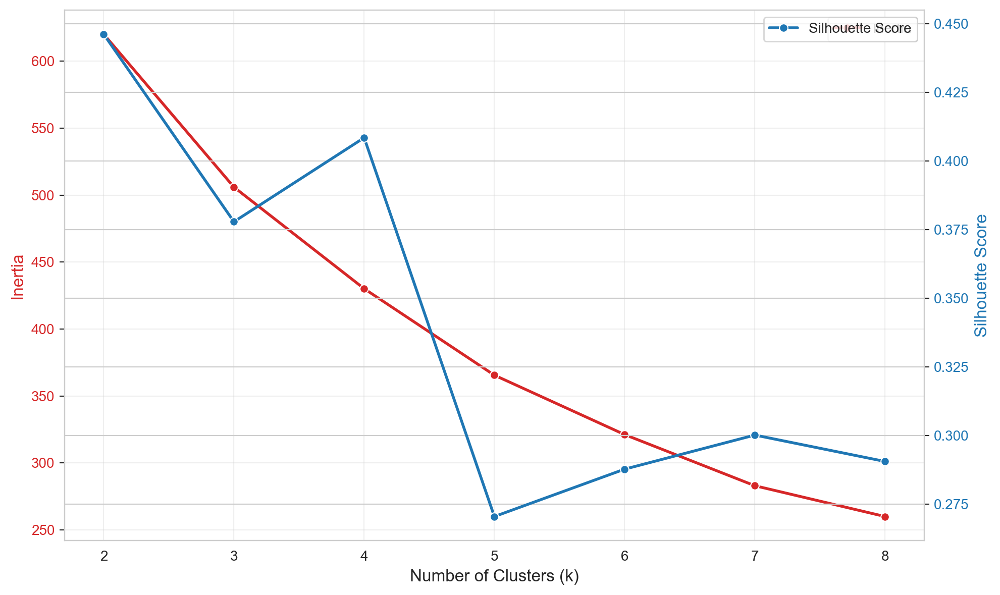

In [119]:
weights_value = som_behaviour.get_weights()
x_val, y_val, n_val = weights_value.shape
weights_behaviour_flat = weights_value.reshape(x_val * y_val, n_val)

inertia_and_silhouette_plots(weights_behaviour_flat, min_clusters=2, max_clusters=8)

We will go with $K=4$, because is by the one with the highest silhouette score and have an acceptably lower inertia.

In [ ]:
K_behaviour = 4

kmeans_som_behaviour = KMeans(n_clusters=K_behaviour, init='k-means++', n_init=20, random_state=42)
kmeans_som_behaviour.fit(weights_behaviour_flat)

kmeans_som_labels = kmeans_som_behaviour.labels_

kmeans_n_clusters = len(np.unique(kmeans_som_labels))
print(f"Distribution:\n{pd.Series(kmeans_som_labels).value_counts().sort_index()}")

Distribution:
0    121
1     21
2     16
3     67
Name: count, dtype: int64


In [65]:
df_behaviour_som_clusters = df_behaviour.copy()
df_behaviour_som_clusters['cluster_labels_behavior'] = df_behaviour[behavioral_features].apply(
    lambda row: kmeans_som_labels[
        som_behaviour.winner(row.values)[0] * y_val + som_behaviour.winner(row.values)[1]
    ], 
    axis=1
)

cluster_som_behavior = df_behaviour_som_clusters.groupby('cluster_labels_behavior')[behavioral_features].mean()

cluster_som_behavior

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
cluster_labels_behavior,,,,,,,
0,0.507352,0.637210,-0.247074,-0.139192,0.561294,0.488962,0.481167
1,-1.182968,-1.488866,2.728368,-0.029242,-1.276499,-1.189982,-1.068676
2,-0.791491,-0.486559,0.162977,1.776280,-0.386064,-0.546016,0.310295
3,-0.805908,-1.091834,-0.212362,-0.076359,-0.979880,-0.797289,-0.944164


In [66]:
cluster_pct_som = (
    df_behaviour_som_clusters["cluster_labels_behavior"]
    .value_counts(normalize=True)
    .sort_index()
    .mul(100)
    .round(2)
)

cluster_dist_som = pd.DataFrame({
    "count": df_behaviour_som_clusters["cluster_labels_behavior"].value_counts().sort_index(),
    "pct_%": cluster_pct_som
})

cluster_dist_som


,count,pct_%
cluster_labels_behavior,,
0,10626,63.68
1,1249,7.48
2,634,3.80
3,4178,25.04


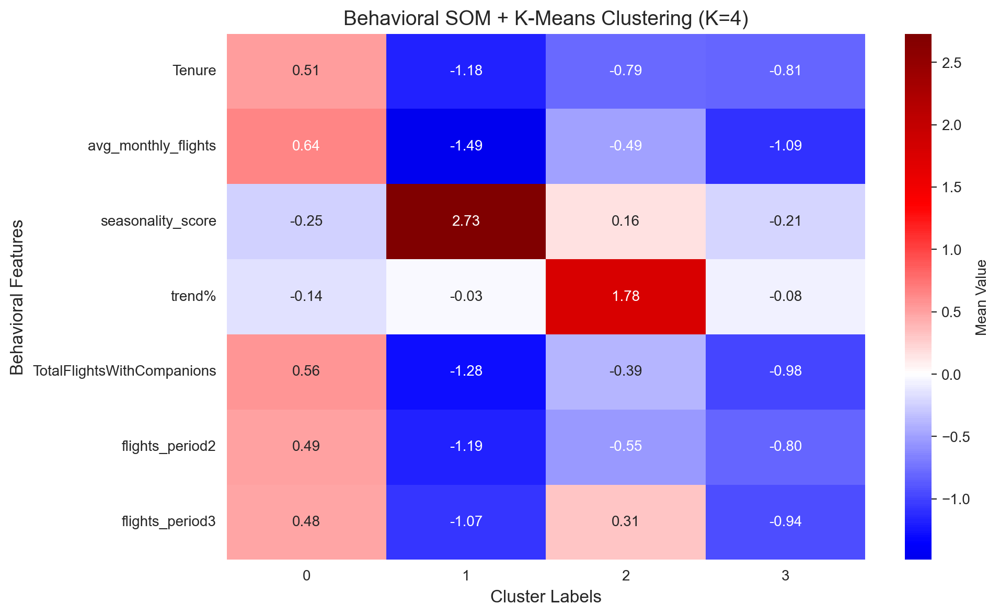

In [67]:
fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(cluster_som_behavior.T,
            center=0, annot=True, cmap="seismic", fmt=".2f",
            ax=ax, cbar_kws={'label': 'Mean Value'})
ax.set_xlabel("Cluster Labels", fontsize=12)
ax.set_ylabel("Behavioral Features", fontsize=12)
ax.set_title(f"Behavioral SOM + K-Means Clustering (K={K_behaviour})", fontsize=14)
plt.tight_layout()
plt.show()

**Behavioral SOM + K-Means Clustering (K=4)**

**Cluster 0: Established Active Travelers (63.7%)**
* **Characteristics:**
   * **Tenure**: +0.51 (moderate-high) -> Established program members
   * **avg_monthly_flights**: +0.64 (high) -> Regular flight activity
   * **seasonality_score**: -0.25 (low) -> Consistent year-round travel
   * **trend%**: -0.14 (stable) -> Mature, predictable engagement
   * **TotalFlightsWithCompanions**: +0.56 (high) -> Frequent group/family travel
   * **flights_period2/3**: +0.49/+0.48 (moderate-high) -> Sustained activity across periods
* **Profile:** Core customer segment with high engagement, established loyalty, and consistent year-round travel patterns. Regular business/leisure travelers with frequent companion bookings, representing stable revenue contributors with predictable behavior.

**Cluster 1: Seasonal Solo Travelers (7.5%)**
* **Characteristics:**
   * **Tenure**: -1.18 (low) -> Relatively newer customers
   * **avg_monthly_flights**: -1.49 (very low) -> Minimal flight frequency
   * **seasonality_score**: **+2.73 (extremely high)** -> Extreme seasonal concentration
   * **trend%**: -0.03 (stagnant) -> No growth or decline
   * **TotalFlightsWithCompanions**: -1.28 (very low) -> Predominantly solo travelers
   * **flights_period2/3**: -1.19/-1.07 (very low) -> Consistently low activity
* **Profile:** Highly seasonal niche segment with extreme periodicity, likely vacation-only travelers with predictable annual patterns (e.g., summer holidays, winter breaks). Minimal engagement outside peak periods, solo travel focus suggests leisure-oriented budget travelers.

**Cluster 2: Emerging High-Growth Segment (3.8%)**
* **Characteristics:**
   * **Tenure**: -0.79 (low) -> Recent program members
   * **avg_monthly_flights**: -0.49 (below average) -> Currently moderate activity
   * **seasonality_score**: +0.16 (near zero) -> Minimal seasonal patterns
   * **trend%**: **+1.78 (extremely high)** -> Explosive engagement growth
   * **TotalFlightsWithCompanions**: -0.39 (below average) -> Primarily solo travelers
   * **flights_period2/3**: -0.55/+0.31 (mixed) -> Accelerating activity in recent periods
* **Profile:** High-potential emerging customers experiencing rapid engagement growth despite low tenure and current moderate activity. Consistent year-round behavior with accelerating flight frequency suggests business travelers or frequent leisure users in early loyalty lifecycle. Highest future value potential.

**Cluster 3: At-Risk Low-Engagement Customers (25%)**
* **Characteristics:**
   * **Tenure**: -0.81 (low) -> Newer members
   * **avg_monthly_flights**: -1.09 (very low) -> Minimal flight activity
   * **seasonality_score**: -0.21 (low) -> No strong seasonal patterns
   * **trend%**: -0.08 (negative) -> Declining engagement from low baseline
   * **TotalFlightsWithCompanions**: -0.98 (very low) -> Solo, infrequent travelers
   * **flights_period2/3**: -0.80/-0.94 (very low) -> Consistently minimal activity
* **Profile:** Low-engagement segment with minimal activity from the start. Newer customers who never fully activated, showing declining interest even within their short tenure. Potential failed acquisitions or dormant accounts requiring activation campaigns or acceptance as low-priority segment.

**Key Insights:**
1. **Cluster 0** (63.7%) represents the **highest-value behavioral segment** (frequent, consistent, companion travel, established loyalty) and dominates the customer base
2. **Cluster 1** (7.5%) captures **extreme seasonality niche** (+2.73), requiring targeted peak-period campaigns
3. **Cluster 2** (3.8%) shows **exceptional growth potential** (explosive trend +1.78 despite low tenure), critical for future revenue despite small size
4. **Cluster 3** (25%) requires **activation intervention** (never engaged, declining from already-low baseline), representing one-quarter of customer base at risk
5. **Growth trend as distinct dimension**: SOM successfully separated high-potential emerging customers (Cluster 2) from other low-activity segments (Clusters 1 and 3), which traditional methods would miss
6. **Companion travel as loyalty indicator**: Cluster 0's high companion flights (+0.56) vs. all other clusters' negative values suggests group/family travel correlates with deeper engagement and long-term retention

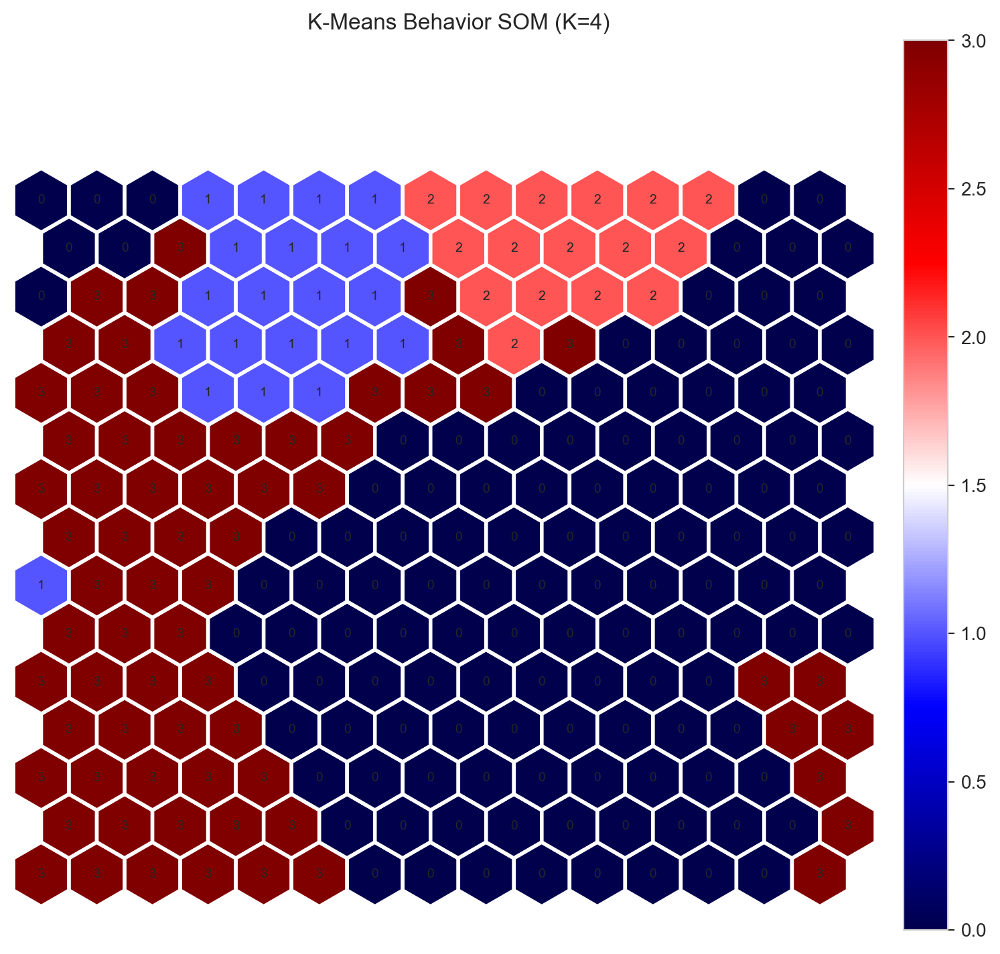

In [72]:
weights_behavior = som_behaviour.get_weights()
x_beh, y_beh, n_beh = weights_behavior.shape

fig2 = plt.figure(figsize=(9,9))
kmeans_behavior_matrix = kmeans_som_labels.reshape((x_beh, y_beh))
plot_hexagons(kmeans_behavior_matrix, som_behaviour, fig2, 
              label=f"K-Means Behavior SOM (K={K_behaviour})", cmap=cm.seismic, 
              annot_mx=kmeans_behavior_matrix)

plt.show()

This hexagonal Self-Organizing Map (SOM) visualization displays the neuron-level clustering results, where K-means was applied to the SOM neurons (not directly to customers), revealing clear topological patterns in the learned behavioral space:

**Cluster 0 (Dark Blue):**
- Dominant region covering center, right, and bottom (60-65% of grid)
- Corresponds to Established Active Travelers (63.7%)

**Cluster 1 (Light Blue):**
- Upper-left quadrant, compact and isolated
- Corresponds to Seasonal Solo Travelers (7.5%)

**Cluster 2 (Light Red):**
- Upper-center, highly concentrated narrow band
- Corresponds to Emerging High-Growth Segment (3.8%)

**Cluster 3 (Dark Red):**
- Left side and edges, wrapping around Cluster 0
- Corresponds to At-Risk Low-Engagement (25%)

**Key Observations:**
Clear spatial separation with Cluster 0 dominating the core. Cluster 2's tight localization confirms high-growth niche. Cluster 1's isolation matches extreme seasonality hotspot. Spatial distribution aligns with U-Matrix boundaries and component plane patterns.

### 2.3.3 Density Based Clustering

#### 2.3.3.1 DBSCAN

DBSCAN (Density-Based Spatial Clustering of Applications with Noise) is a density-based clustering algorithm that groups together points that are closely packed in high-density regions, while marking points in low-density regions as outliers. Unlike K-Means, it doesn't require specifying the number of clusters beforehand and can discover clusters of arbitrary shapes.

The algorithm works by:
- Selecting a random unvisited point, 
- Finding all points within a distance *eps* (epsilon) from it,
- If there are at least *min_samples* points nearby, starting a new cluster and expanding it by recursively adding all density-reachable points, and 
- If a point has fewer than min_samples neighbors, marking it as noise (outlier). Points are classified as core points (dense neighborhoods), border points (reachable from core points), or noise points (isolated).

In [73]:
dbscan_data_behaviour = df_behaviour.values

Number of behavioral SOM features: 7
Recommended min_samples: 14


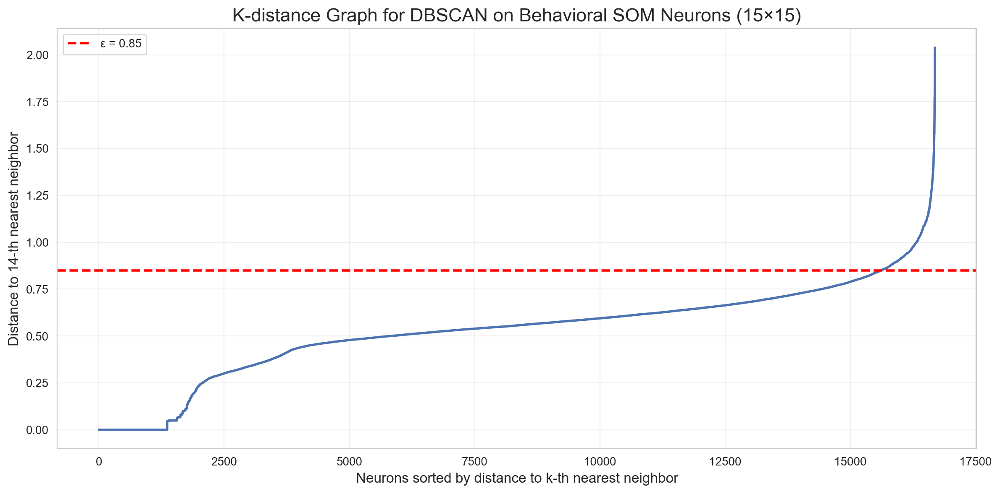

In [110]:
min_samples_behavior = 2 * len(behavioral_features)
print(f"Number of behavioral SOM features: {len(behavioral_features)}")
print(f"Recommended min_samples: {min_samples_behavior}")

neigh_behavior = NearestNeighbors(n_neighbors=min_samples_behavior)
neighbors_fit = neigh_behavior.fit(dbscan_data_behaviour)

distances_behavior, _ = neighbors_fit.kneighbors(dbscan_data_behaviour)
distances_sorted_behavior = np.sort(distances_behavior[:, -1], axis=0)

df_k = pd.DataFrame({
    "Neuron rank": np.arange(len(distances_sorted_behavior)),
    "k-distance": distances_sorted_behavior
})

plt.figure(figsize=(12, 6))

sns.lineplot(
    data=df_k,
    x="Neuron rank",
    y="k-distance",
    linewidth=2
)

plt.axhline(
    y=0.85,
    color="red",
    linestyle="--",
    linewidth=2,
    label="ε = 0.85"
)

plt.title(
    f"K-distance Graph for DBSCAN on Behavioral SOM Neurons ({x_beh}×{y_beh})",
    fontsize=16
)
plt.xlabel("Neurons sorted by distance to k-th nearest neighbor", fontsize=12)
plt.ylabel(f"Distance to {min_samples_behavior}-th nearest neighbor", fontsize=12)
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [77]:
dbscan_behavior = DBSCAN(eps=0.85, min_samples=min_samples_behavior, n_jobs=-1)

dbscan_labels_behavior = dbscan_behavior.fit_predict(dbscan_data_behaviour)

print(f"  Cluster distribution:\n{pd.Series(dbscan_labels_behavior).value_counts().sort_index()}")

  Cluster distribution:
-1      235
 0     1502
 1    14950
Name: count, dtype: int64


In [78]:
df_behavior_dbscan_clusters = df_behaviour.copy()
df_behavior_dbscan_clusters['cluster_labels_behavior'] = dbscan_labels_behavior

cluster_dbscan_behavior = df_behavior_dbscan_clusters[list(behavioral_features) + ['cluster_labels_behavior']].groupby('cluster_labels_behavior').mean()
cluster_dbscan_behavior

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
cluster_labels_behavior,,,,,,,
-1,-0.019037,0.062408,0.194976,1.624891,0.148930,0.230099,0.063291
0,-0.661905,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
1,0.069790,0.177507,0.144033,-0.049200,0.151251,0.128972,0.152688


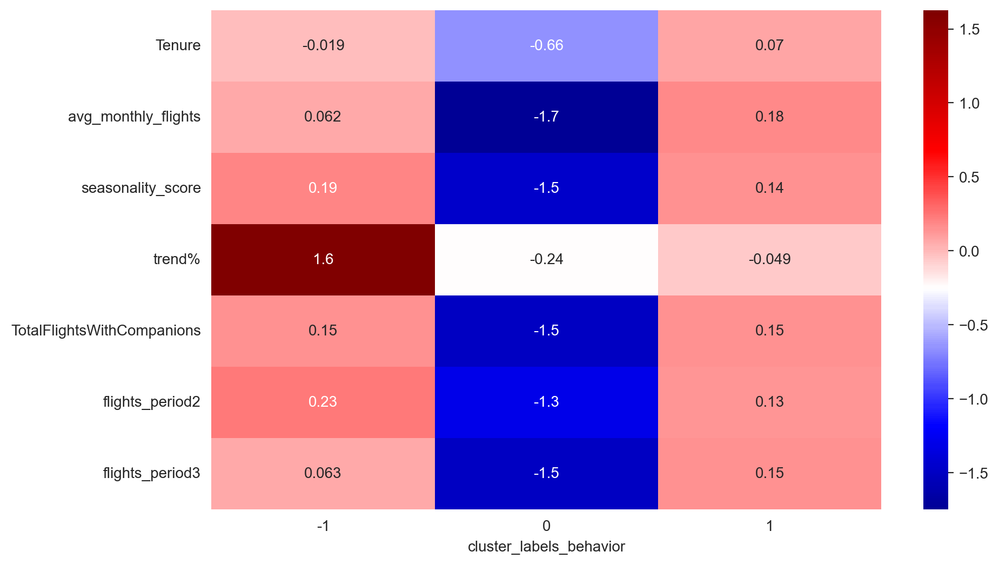

In [ ]:
sns.heatmap(cluster_dbscan_behavior.T, annot=True, cmap="seismic", center=cluster_dbscan_behavior.values.mean())
plt.show()

**DBSCAN Outlier Profile: Behavioral Perspective**

**Cluster -1 (High-Growth Emerging Segment):**
* **Characteristics:**
   * **Tenure**: -0.019 (near average) -> Moderate program membership
   * **avg_monthly_flights**: +0.062 (slightly above average) -> Moderate flight activity
   * **seasonality_score**: +0.19 (low positive) -> Minimal seasonal patterns
   * **trend%**: **+1.6 (very high)** -> Explosive engagement growth
   * **TotalFlightsWithCompanions**: +0.15 (slightly above average) -> Moderate companion travel
   * **flights_period2/3**: +0.23/+0.063 (slightly positive) -> Recent period acceleration
* **Profile:** High-growth emerging customers with explosive engagement trajectory despite moderate current activity levels. Minimal seasonality and accelerating period activity suggest rapid behavioral transformation, likely representing customers transitioning from occasional to frequent travel patterns.

**Cluster 0 (Low-Engagement Baseline):**
* **Characteristics:**
   * **Tenure**: -0.66 (low) -> Newer members
   * **avg_monthly_flights**: **-1.7 (very low)** -> Minimal flight activity
   * **seasonality_score**: **-1.5 (very low)** -> No seasonal patterns
   * **trend%**: -0.24 (negative) -> Declining engagement
   * **TotalFlightsWithCompanions**: **-1.5 (very low)** -> Solo, infrequent travelers
   * **flights_period2/3**: -1.3/-1.5 (very low) -> Consistently minimal activity
* **Profile:** Dormant low-engagement segment with minimal activity across all dimensions. Newer customers who never activated, showing no seasonal patterns or companion travel. Potential failed acquisitions requiring intervention.

**Cluster 1 (Average Stable Travelers):**
* **Characteristics:**
   * **Tenure**: +0.07 (near average) -> Moderate program membership
   * **avg_monthly_flights**: +0.18 (slightly above average) -> Moderate flight activity
   * **seasonality_score**: +0.14 (low) -> Minimal seasonal patterns
   * **trend%**: -0.049 (stable) -> Mature, predictable engagement
   * **TotalFlightsWithCompanions**: +0.15 (slightly above average) -> Moderate companion travel
   * **flights_period2/3**: +0.13/+0.15 (slightly positive) -> Sustained moderate activity
* **Profile:** Stable baseline segment with consistent moderate engagement. Year-round travel patterns with moderate companion activity. Represents the "average customer" archetype with predictable, steady behavior.

**Key Observations:**
- **Cluster -1 (outliers) = High-Growth segment**: DBSCAN correctly identified explosive trend% (+1.6) as anomalous, validating these customers as distinct from normal patterns
- **Cluster 0 = At-Risk/Dormant**: Extreme negative values across all features (-1.5 to -1.7) confirm minimal engagement
- **Cluster 1 = Core Average**: Near-zero values across features represent the typical customer baseline
- **Growth trajectory as outlier criterion**: DBSCAN's outlier detection successfully isolated rapid engagement acceleration, which K-Means might dilute into larger clusters

#### 2.3.3.2 Mean Shift Clustering

Mean-shift is a clustering algorithm that finds dense regions in your data by iteratively shifting data points toward areas of higher density.

The algorithm works by: 
- Looking at nearby neighbors within a certain radius (the bandwidth), 
- calculating the mean position of these neighbors, 
- Shifting the point toward this mean, and 
- Repeating until points stop moving and converge. Points that converge to the same location form a cluster.

The bandwidth is the key parameter - it determines the search radius for neighbors. A large bandwidth creates few, large clusters (balls roll far before stopping), while a small bandwidth creates many, small clusters (balls stop quickly in local valleys).

In [80]:
mean_shift_data = df_behaviour.values.copy()

We will test two different bandwidth values for the Mean Shift clustering algorithm by varying the quantile parameter in the bandwidth estimation function.

- *quantile=0.1*: Produces a smaller bandwidth, resulting in more clusters (3 clusters in this case). A lower quantile makes the algorithm more sensitive to local density variations, creating finer-grained clusters.

- *quantile=0.2*: Produces a larger bandwidth, resulting in fewer clusters (2 clusters in this case). A higher quantile makes the algorithm less sensitive to local variations, merging nearby points into broader clusters.

We will understand what is the best approach with using 2 two different tests: 
- *Silhouette Score* (higher is better): Measures how similar points are to their own cluster compared to other clusters. Range: [-1, 1].

- *Davies-Bouldin Index* (lower is better): Measures the average similarity ratio of each cluster with its most similar cluster. Lower values indicate better separation.

The comparison helps determine which bandwidth produces more meaningful and well-separated clusters for the dataset.

In [81]:
bw_01 = estimate_bandwidth(mean_shift_data, quantile=0.1, random_state=1, n_jobs=-1)
ms_01 = MeanShift(bandwidth=bw_01, n_jobs=-1)
labels_01 = ms_01.fit_predict(mean_shift_data)

bw_02 = estimate_bandwidth(mean_shift_data, quantile=0.2, random_state=1, n_jobs=-1)
ms_02 = MeanShift(bandwidth=bw_02, n_jobs=-1)
labels_02 = ms_02.fit_predict(mean_shift_data)

print("=== 3 Clusters (quantile=0.1) ===")
print(f"Silhouette Score: {silhouette_score(mean_shift_data, labels_01):.3f}")  
print(f"Davies-Bouldin Index: {davies_bouldin_score(mean_shift_data, labels_01):.3f}") 
print(f"Distribution: {pd.Series(labels_01).value_counts().sort_index().to_dict()}")

print("\n=== 2 Clusters (quantile=0.2) ===")
print(f"Silhouette Score: {silhouette_score(mean_shift_data, labels_02):.3f}")
print(f"Davies-Bouldin Index: {davies_bouldin_score(mean_shift_data, labels_02):.3f}")
print(f"Distribution: {pd.Series(labels_02).value_counts().sort_index().to_dict()}")

=== 3 Clusters (quantile=0.1) ===
Silhouette Score: 0.417
Davies-Bouldin Index: 0.913
Distribution: {0: 11043, 1: 4142, 2: 1502}

=== 2 Clusters (quantile=0.2) ===
Silhouette Score: 0.404
Davies-Bouldin Index: 1.044
Distribution: {0: 10830, 1: 5857}


In [82]:
bandwidth = estimate_bandwidth(mean_shift_data, 
                               quantile=0.1,
                               random_state=1,
                               n_jobs=-1)
bandwidth

np.float64(1.763979864325025)

In [83]:
ms = MeanShift(bandwidth=bandwidth)
ms.fit(mean_shift_data)

ms_labels = ms.labels_
cluster_centers = ms.cluster_centers_

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 3


In [84]:
df_behavior_mean_shift_clusters = df_behaviour.copy()
df_behavior_mean_shift_clusters['cluster_labels_behavior'] = ms_labels

cluster_mean_shift_behavior = df_behavior_mean_shift_clusters[list(behavioral_features) + ['cluster_labels_behavior']].groupby('cluster_labels_behavior').mean()
cluster_mean_shift_behavior

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
cluster_labels_behavior,,,,,,,
0,0.460044,0.621911,-0.243831,-0.124098,0.542026,0.468438,0.474664
1,-0.975706,-1.013852,1.181008,0.245466,-0.890728,-0.770343,-0.710805
2,-0.661905,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618


#### 2.3.3.3 Gaussian Mixture Model

Gaussian Mixture Model (GMM) is a probabilistic clustering algorithm that assumes data points are generated from a mixture of several Gaussian (normal) distributions.

The algorithm works by: 
- Initializing K Gaussian distributions with random means and covariances, 
- Calculating the probability that each point belongs to each Gaussian (expectation step), 
- Updating the parameters of each Gaussian based on these probabilities (maximization step), and 
- Repeating until convergence.

The key parameters are **n_components** (number of clusters/Gaussians) and **covariance_type** (shape of the clusters).

In [85]:
gmm_data = df_behaviour.values.copy()

In [86]:
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(gmm_data)
          for n in n_components]

bic_values = [m.bic(gmm_data) for m in models]
aic_values = [m.aic(gmm_data) for m in models]

**AIC**: estimates the relative amount of information lost by a model used to represent the data-generation process. The smaller the better. <br>
**BIC**: similar to AIC but penalizes more complex models (i.e. favors simpler models). The smaller the better.

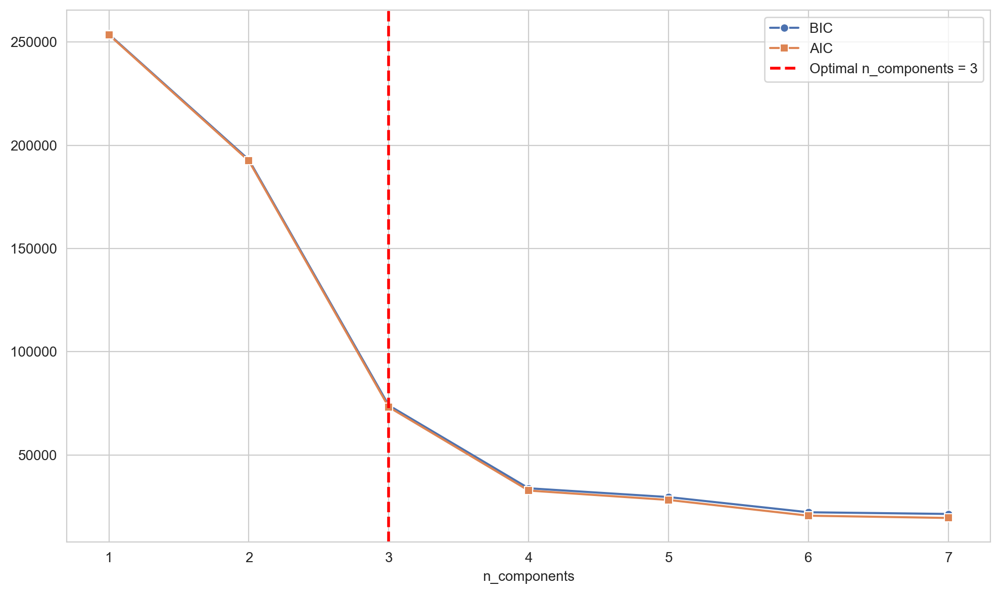

In [101]:
plt.figure(figsize=(10, 6))

sns.lineplot(x=n_components, y=bic_values, marker="o", label="BIC")
sns.lineplot(x=n_components, y=aic_values, marker="s", label="AIC")

plt.axvline(
    x=3,
    color="red",
    linestyle="--",
    linewidth=2,
    label="Optimal n_components = 3"
)

plt.xlabel("n_components")
plt.xticks(n_components)
plt.legend(loc="best")
plt.tight_layout()
plt.show()

We will go with $n components=3$

In [88]:
gmm = GaussianMixture(n_components=3, 
                      covariance_type='full', 
                      n_init=10, 
                      init_params='kmeans', 
                      random_state=1)

gmm_labels = gmm.fit_predict(gmm_data)

In [89]:
df_behavior_gmm_clusters = df_behaviour.copy()
df_behavior_gmm_clusters['cluster_labels_behavior'] = gmm_labels

cluster_gmm_behavior = df_behavior_gmm_clusters[list(behavioral_features) + ['cluster_labels_behavior']].groupby('cluster_labels_behavior').mean()

cluster_gmm_behavior

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3
cluster_labels_behavior,,,,,,,
0,-0.661905,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618
1,0.424898,0.578866,-0.211168,-0.140689,0.493600,0.423833,0.416072
2,-1.062241,-1.102918,1.273914,0.349054,-0.934731,-0.799714,-0.688457


In [90]:
df_behavior_gmm_clusters['cluster_labels_behavior'].value_counts().sort_index()

cluster_labels_behavior
0     1502
1    11545
2     3640
Name: count, dtype: int64

In [91]:
probabilities = gmm.predict_proba(df_behaviour)
probabilities

array([[1.00000000e+00, 2.95806738e-41, 1.45858815e-23],
       [0.00000000e+00, 1.00000000e+00, 1.35178794e-13],
       [1.00000000e+00, 2.95806738e-41, 1.45858815e-23],
       ...,
       [1.00000000e+00, 6.79855685e-40, 2.95321933e-31],
       [1.00000000e+00, 7.35638061e-40, 8.45944421e-32],
       [1.00000000e+00, 1.59320378e-40, 4.48740597e-25]], shape=(16687, 3))

In [92]:
max_probs = probabilities.max(axis=1)
uncertain_threshold = 0.7
certain_customers = df_behaviour[max_probs >= uncertain_threshold]
uncertain_customers = df_behaviour[max_probs < uncertain_threshold]

print(f"GMM Probability Analysis:")
print(f"- Clear assignments (≥70% probability): {len(certain_customers):,} customers")
print(f"- Uncertain assignments (<70% probability): {len(uncertain_customers):,} customers ({len(uncertain_customers)/len(df_behaviour):.1%})")

GMM Probability Analysis:
- Clear assignments (≥70% probability): 16,543 customers
- Uncertain assignments (<70% probability): 144 customers (0.9%)


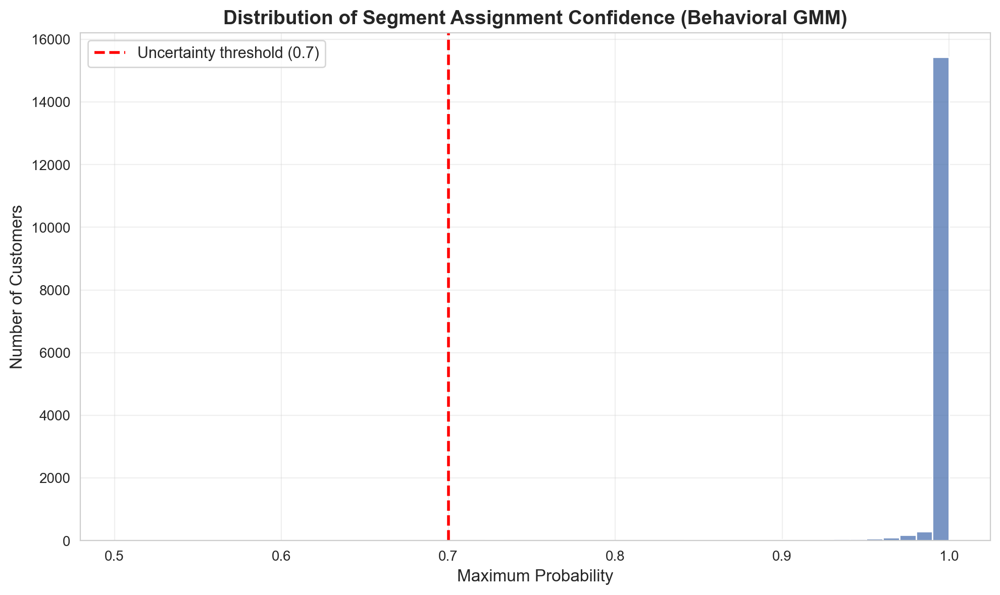

In [100]:
plt.figure(figsize=(10, 6))

sns.histplot(
    max_probs,
    bins=50,
    kde=False
)

plt.axvline(
    x=uncertain_threshold,
    linestyle="--",
    linewidth=2,
    color="red",
    label=f"Uncertainty threshold ({uncertain_threshold})"
)

plt.xlabel("Maximum Probability", fontsize=12)
plt.ylabel("Number of Customers", fontsize=12)
plt.title(
    "Distribution of Segment Assignment Confidence (Behavioral GMM)",
    fontsize=14,
    fontweight="bold"
)
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

**How Marketing Could Use Probability Scores < 0.7**

**1. Cross-Segment Targeting**
- These customers don't fit one box - they show mixed behaviors
- Send campaigns mixing messages from their top groups
- Example: 40% Active + 35% Seasonal -> offer both regular perks and holiday deals

**2. Transition Monitoring**
- Low scores mean customers are changing
- Watch if they start moving toward At-Risk
- Step in early before they leave

**3. A/B Testing Ground**
- Try different offers for different segments they might fit
- See which one they respond to
- Learn what really works for them

**4. High-Value Prioritization**
- Uncertain customers with high value need care
- Use safe, broad messages - don't risk wrong approach
- Give them extra attention to understand their needs

**5. Dynamic Reassignment**
- Update scores monthly or quarterly
- Moving to certain (>0.7) = working well
- Getting more uncertain = warning sign

**Key Insight:** Uncertainty shows changing customers.

### 2.3.4 Comparing Models

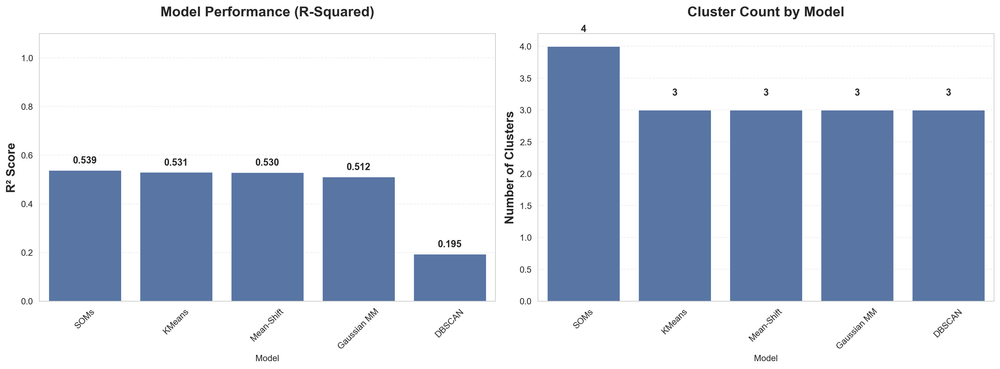

In [109]:
Preference_models = {
    "KMeans": df_behavior_KM_clusters,
    "SOMs": df_behaviour_som_clusters,
    "DBSCAN": df_behavior_dbscan_clusters,
    "Mean-Shift": df_behavior_mean_shift_clusters,
    "Gaussian MM": df_behavior_gmm_clusters
}
compare_models(Preference_models, cluster_column="cluster_labels_behavior")

## 2.4 Value-Based Segmentation

### 2.4.1 K-means and Hierarchical clustering

In [120]:
r2_scores_VB = {}

r2_scores_VB['kmeans'] = get_r2_scores(df_value, value_features, kmeans)

for link in hc_methods:
    r2_scores_VB[link] = get_r2_scores(
        df_value,
        value_features,
        hierarchical.set_params(linkage=link) 
    )

In [121]:
r2_scores_VB = pd.DataFrame(r2_scores_VB)
r2_scores_VB

,kmeans,ward,complete,average,single
1,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.317487,0.298115,0.265675,0.112345,0.000185
3,0.454473,0.408447,0.314563,0.131713,0.000373
4,0.557315,0.503111,0.403772,0.287126,0.000678
5,0.611972,0.563764,0.422432,0.291585,0.000991
6,0.651596,0.607944,0.540631,0.296976,0.001298
7,0.686324,0.638563,0.555311,0.495006,0.001738
8,0.713564,0.664515,0.571989,0.550683,0.002201


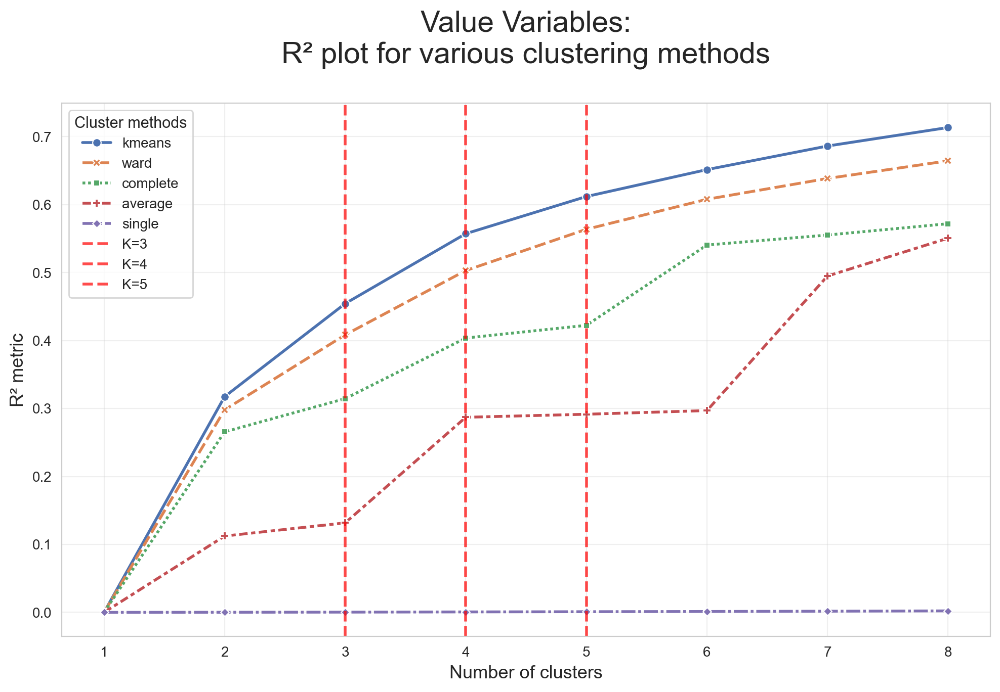

In [122]:
plt.figure(figsize=(10, 7))

sns.lineplot(
    data=r2_scores_VB,
    linewidth=2,
    markers=True
)

for k in [3, 4, 5]:
    plt.axvline(
        x=k,
        color="red",
        linestyle="--",
        linewidth=2,
        alpha=0.7,
        label=f"K={k}"
    )

plt.title(
    "Value Variables:\nR² plot for various clustering methods\n",
    fontsize=21
)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

No clear elbow in this graph, we should go with something between 3 and 5, so before deciding, we will assess inertia and silhouette score:

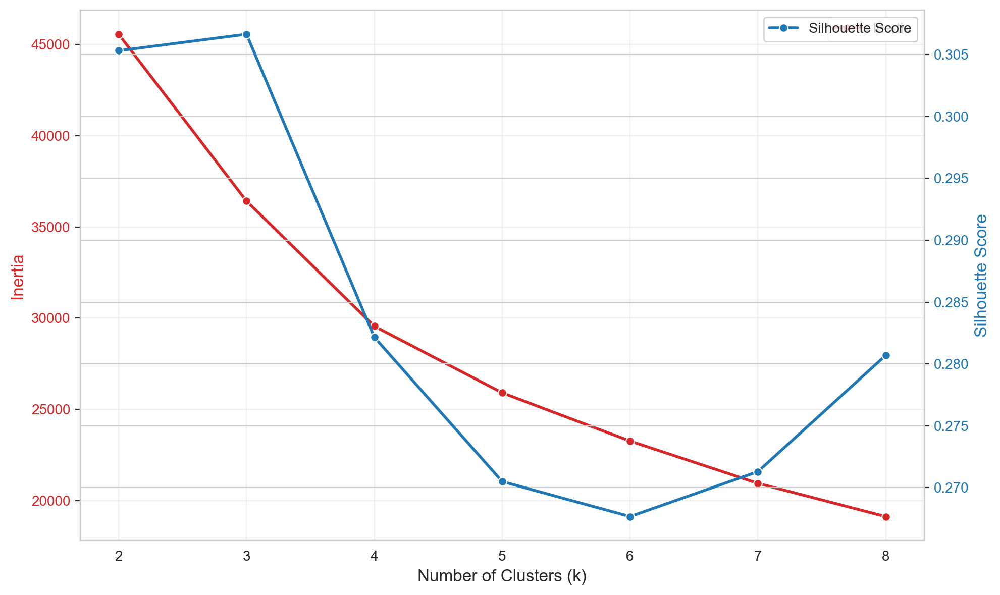

In [123]:
inertia_and_silhouette_plots(df_value,2,8)

The best silhouette score is by far at $K=3$ so we will go with it.

In [124]:
kmeans_data = df_value.values.copy()

In [125]:
kmeans_value = KMeans(
    n_clusters=3,
    init='k-means++',
    n_init=20,
    random_state=42
)
kmeans_value.fit(kmeans_data)

kmeans_labels = kmeans_value.labels_
cluster_centers = kmeans_value.cluster_centers_

kmeans_n_clusters = len(np.unique(kmeans_labels))
print(f"Number of clusters: {kmeans_n_clusters}")

Number of clusters: 3


In [126]:
df_value_KM_clusters = df_value.copy()
df_value_KM_clusters['cluster_labels_value'] = kmeans_labels

cluster_kmeans_value = df_value_KM_clusters[list(value_features) + ['cluster_labels_value']].groupby('cluster_labels_value').mean()
cluster_kmeans_value

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
cluster_labels_value,,,,
0,0.008016,-0.430766,-0.602172,-0.619950
1,-0.022471,1.738928,-0.242160,-0.250293
2,-0.000498,-0.258414,1.090933,1.118237


In [127]:
# Percentage of customers in each cluster
cluster_pct = (
    df_value_KM_clusters["cluster_labels_value"]
    .value_counts(normalize=True)
    .sort_index()
    .mul(100)
    .round(2)
)

# Count + percentage
cluster_dist = pd.DataFrame({
    "count": df_value_KM_clusters["cluster_labels_value"].value_counts().sort_index(),
    "pct_%": cluster_pct
})

cluster_dist


,count,pct_%
cluster_labels_value,,
0,8472,50.77
1,2886,17.29
2,5329,31.94


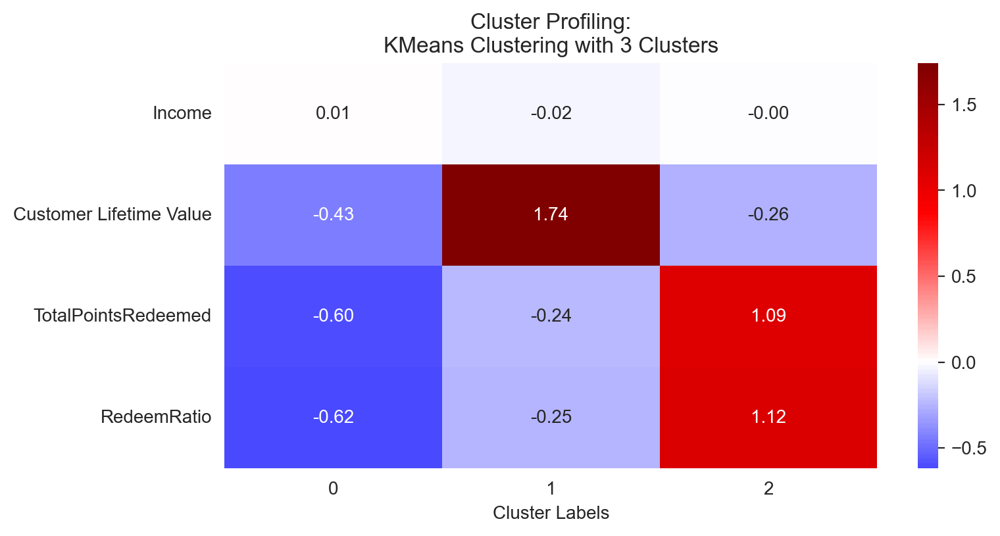

In [128]:
fig, ax = plt.subplots(figsize=(8,4))

sns.heatmap(cluster_kmeans_value.T,
            center=0, annot=True, cmap="seismic", fmt=".2f",
            ax=ax 
            )

ax.set_xlabel("Cluster Labels")
ax.set_title("Cluster Profiling:\nKMeans Clustering with 3 Clusters")
plt.show()

**Cluster 0: Low-Value Non-Engagers (50,8%)**

**Characteristics:**
- **Income**: +0.01 (average) -> Similar to overall population
- **Customer Lifetime Value**: -0.43 (low) -> Below-average economic contribution
- **TotalPointsRedeemed**: -0.60 (very low) -> Minimal loyalty program usage
- **RedeemRatio**: -0.62 (very low) -> Low point redemption rate

**Profile:** Budget-conscious customers with limited economic contribution. Minimal engagement with the loyalty program despite earning points. Represent baseline revenue tier with low monetization potential. Largest segment comprising nearly half the customer base.

**Cluster 1: Premium High-Value Champions (17,3%)**

**Characteristics:**
- **Income**: -0.02 (slightly below average) -> Not necessarily wealthy
- **Customer Lifetime Value**: +1.74 (very high) -> Exceptional revenue contributors
- **TotalPointsRedeemed**: -0.24 (slightly below average) -> Moderate redemption
- **RedeemRatio**: -0.25 (below average) -> Conservative point usage

**Profile:** Most valuable customer segment with extraordinary CLV despite moderate income levels. High spend without excessive point redemption suggests price-insensitive travelers or business accounts. Core revenue driver requiring VIP treatment and retention focus. Despite being the smallest segment, generates disproportionate revenue.

**Cluster 2: Active Loyalty Enthusiasts (31,9%)**

**Characteristics:**
- **Income**: -0.00 (average) -> Similar to overall population
- **Customer Lifetime Value**: -0.26 (slightly below average) -> Moderate economic contribution
- **TotalPointsRedeemed**: +1.09 (high) -> Heavy loyalty program users
- **RedeemRatio**: +1.12 (high) -> Maximum point redemption rate

**Profile:** Loyalty-savvy customers who actively engage with rewards program. While CLV is moderate, high redemption indicates strong program affinity and potential for upselling premium services or products with points as incentives. Represents one-third of the customer base.

**Key Insights:**

1. Cluster 1 (17,3%) is the crown jewel segment (CLV +1.74) -> Priority retention and personalized service
2. Cluster 2 (31,9%) shows loyalty program success -> Leverage points for upselling and cross-selling
3. Cluster 0 (50,8%) represents untapped potential -> Activation campaigns to increase engagement

### 2.4.2 Self-Organizing Map

In [129]:
som_data_value = df_value.values

In [130]:
'''som_grid_search(
    data=som_data_value,
    x_sizes=[15, 20, 25, 30],
    y_sizes=[15, 20, 25, 30],
    sigmas=[0.5, 1.0, 2.0, 3.0],
    learning_rates=[0.1, 0.3, 0.5, 0.7],
    num_iterations=20000,
    random_seed=42
)'''

'som_grid_search(\n    data=som_data_value,\n    x_sizes=[15, 20, 25, 30],\n    y_sizes=[15, 20, 25, 30],\n    sigmas=[0.5, 1.0, 2.0, 3.0],\n    learning_rates=[0.1, 0.3, 0.5, 0.7],\n    num_iterations=20000,\n    random_seed=42\n)'

Now, we will train the Self-Organizing Map with the best combination:
- x = 20
- y = 20
- sigma = 1.0
- learning_rate = 0.3

In [131]:
som_value = MiniSom(
    x=20,            
    y=20,             
    input_len=len(df_value.columns),
    sigma=1.0,                           
    learning_rate=0.3,                 
    neighborhood_function='gaussian',     
    topology='hexagonal',
    random_seed=42                          
)

som_value.random_weights_init(som_data_value)
som_value.train_batch(
    som_data_value, 
    num_iteration=20_000, 
    verbose=False
    )
qe_after = som_value.quantization_error(som_data_value)
te_after = som_value.topographic_error(som_data_value)
print(f"Quantization Error (QE): {qe_after:.4f}")
print(f"Topographic Error (TE):  {te_after:.4f}")

Quantization Error (QE): 0.3112
Topographic Error (TE):  0.3563


#### 2.4.2.1 Component Planes

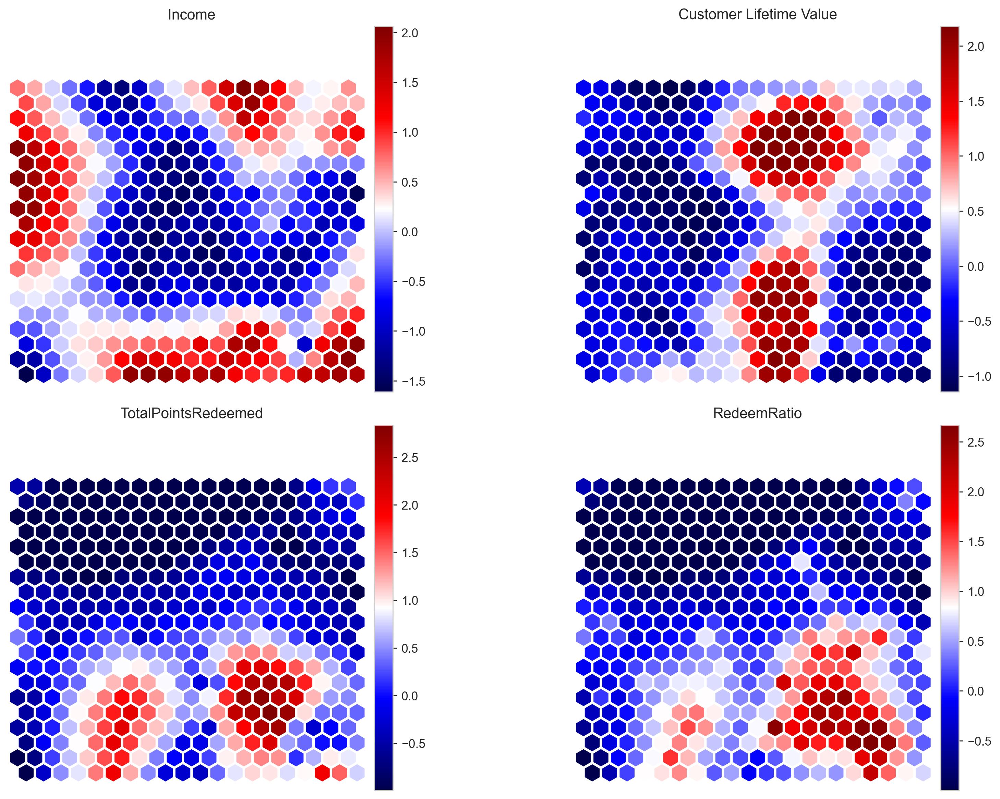

In [133]:
cmap = cm.seismic

weights = som_value.get_weights()
n_features = weights.shape[2] 

fig = plt.figure(figsize=(12, 9), constrained_layout=True, dpi=128)
subfigs = fig.subfigures(2, 2, wspace=.15)

for cpi in range(n_features):
    sf = subfigs.flatten()[cpi]
    matrix_vals = weights[:,:,cpi]
    
    sf = plot_hexagons(matrix_vals, 
                       som_value, sf, 
                       label=value_features[cpi],
                       cmap=cmap, 
                       annot_mx=None)

plt.show()

**Uniform Features:**
- **TotalPointsRedeemed**: Mostly blue across the upper grid (low redemption volume), indicating limited points usage for most customers.
- **RedeemRatio**: Predominantly blue except in lower-right areas, suggesting generally low conversion of points into rewards.

**Outlier Locations:**
- **Customer Lifetime Value (CLV)**: Strong hotspots mid-center and lower-center, marking highly profitable long-term customers.
- **Income**: Red clusters bottom-right, top-center/mid and mid-left, concentrated high-income pockets not perfectly aligned with CLV.
- **TotalPointsRedeemed**: Lower-center to lower-right hotspot, representing customers who actively redeem high volumes of points.
- **RedeemRatio**: Lower-right hotspot, customers who redeem efficiently relative to points earned.

**Positive Correlations:**
- **TotalPointsRedeemed and RedeemRatio**: Overlapping lower-right warm region, heavy redeemers tend to convert a high share of their balance.
- **RedeemRatio and CLV**: Partial alignment in lower-right suggests high redemption efficiency is linked to stronger lifetime value for a subset of users.
- **Income and CLV**: Some overlap top-right indicates wealthier customers can translate into higher long-term value, though not universally.

**Negative Correlations:**
- **Income and RedeemRatio**: High-income zones do not strongly overlap with high redeem ratio clusters, implying affluent users may redeem less actively.

**Customer Segments:**
1. **High-Value Redeemers** *(lower-center/right clusters)*: strong lifetime value, high redemption volume, efficient reward usage, loyal and engaged customers likely benefiting from loyalty programmes.
2. **Affluent Under-Utilisers** *(center-left and top-right income hotspots)*: high income but low redemption behaviour and inconsistent CLV, potential to activate value through targeted incentivisation.
3. **Low-Engagement Low-Value Users** *(blue-dominant regions across all maps)*: low redemption, low ratio, low lifetime value, and limited participation, representing the broad base with minimal economic impact today.

#### 2.4.2.2 U-Matrix

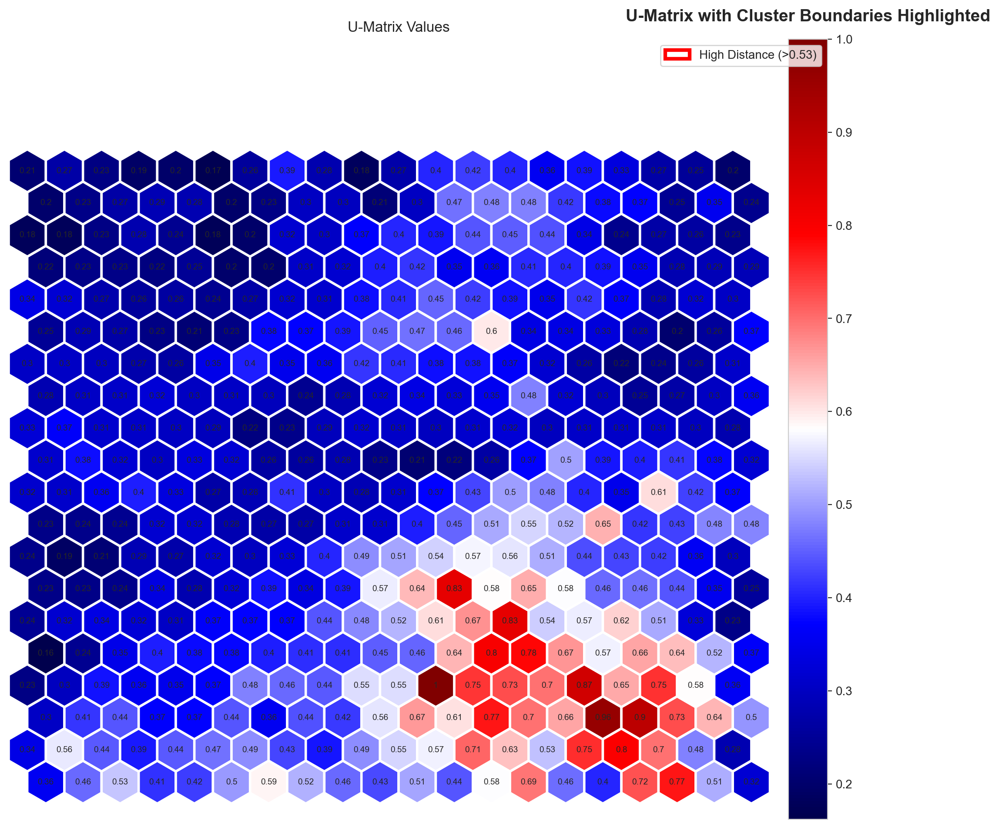

U-matrix statistics:
Mean: 0.388
Std: 0.147
Threshold (mean + std): 0.535
High-distance neurons: 59 / 400 (14.8%)


In [ ]:
umatrix = som_value.distance_map(scaling='mean')

threshold = umatrix.mean() + umatrix.std()

high_distance_mask = umatrix > threshold

fig = plt.figure(figsize=(10, 10))
plot_hexagons(
    umatrix,
    som_value,
    sf=fig,
    label="U-Matrix Values",
    cmap=cm.seismic,
    annot_mx=np.round(umatrix, 2)
)

ax = plt.gca()
for i in range(umatrix.shape[0]):
    for j in range(umatrix.shape[1]):
        if high_distance_mask[i, j]:
            # Hexagon center
            x = j + 0.5 * (i % 2)
            y = i * np.sqrt(3) / 2
            circle = plt.Circle(
                (x, y),
                0.4,
                color="red",
                fill=False,
                linewidth=3,
                alpha=0.8
            )
            ax.add_patch(circle)

legend_circle = Circle(
    (0, 0),
    0.4,
    color="red",
    fill=False,
    linewidth=3,
    label=f"High Distance (>{threshold:.2f})"
)
ax.legend(handles=[legend_circle], loc="upper right", fontsize=10)

plt.title("U-Matrix with Cluster Boundaries Highlighted", fontsize=14, fontweight="bold", pad=15)
plt.tight_layout()
plt.show()

print("U-matrix statistics:")
print(f"Mean: {umatrix.mean():.3f}")
print(f"Std: {umatrix.std():.3f}")
print(f"Threshold (mean + std): {threshold:.3f}")
print(f"High-distance neurons: {high_distance_mask.sum()} / {umatrix.size} ({100 * high_distance_mask.sum() / umatrix.size:.1f}%)")


---

**Clusters**  
**Three clusters**, separated by high-distance boundaries.

1. **Cluster A (upper–central and central band)**: broad low-distance area, predominantly low-to-moderate value users with similar profiles.
2. **Cluster B (lower–right warm zone)**: concentrated region with higher value indicators, containing strong value contributors and active redeemers.
3. **Cluster C (lower–left cooler pocket)**: compact area with consistently low distances, mainly low-value users with limited redemption behaviour.

**Outliers**  
**Locations**: scattered red-highlighted neurons within the lower–right warm zone and isolated high-distance cells around the cluster borders.


#### 2.4.2.3 Hits Map

In [135]:
bmus_value = np.array([som_value.winner(x) for x in som_data_value])

print(f"BMUs shape (customers, SOM position): {bmus_value.shape}")
print(bmus_value[:10])

BMUs shape (customers, SOM position): (16687, 2)
[[ 6 17]
 [ 3 18]
 [13 19]
 [ 8 18]
 [10 15]
 [ 1 14]
 [ 0  8]
 [ 6 17]
 [ 9 16]
 [ 7 19]]


In [136]:
hitsmatrix = som_value.activation_response(df[value_features].values)
np.flip(np.round(hitsmatrix, 2), axis=1).T

array([[ 32.,  44.,  16.,  72.,  82., 112.,  92.,  54.,  70.,  90., 120.,
         65.,  79.,  90.,  30.,  58.,   6.,  41.,  46.,  53.],
       [ 19.,   3.,  27.,  41.,  91.,  76.,  69.,  21.,  81.,  61.,  56.,
         32.,  12.,  31.,  18.,  29.,  30.,  27.,  28.,  36.],
       [ 32.,  57.,  70.,  59.,  29.,  48.,  80.,  52.,  61.,  41.,  52.,
         26., 130.,  86.,  17.,  16.,   2.,  35.,  36.,  48.],
       [ 70.,  65.,  63.,  70.,  54.,  76.,  80.,  55.,  43.,  56., 111.,
        115.,  25.,  47.,   9.,  21.,  18.,  24.,  46.,  51.],
       [ 73.,  85.,  52.,  34.,  62.,  45.,  51.,  47.,  48.,  40., 124.,
         23.,  62.,  49.,  11.,  41.,  33.,   3.,  20.,  34.],
       [105.,  75.,  73.,  67.,  72.,  38.,  58.,  88.,  50.,  15.,  73.,
         82.,  28.,  58.,  24.,   8.,  14.,   9.,   7.,  38.],
       [ 40.,  13.,  21.,  29.,  56.,  87.,   6.,   0.,   7.,  22.,  25.,
         29.,  21.,  21.,  30.,  19.,  23.,  21.,  10.,  68.],
       [ 64.,  60.,  37.,  34.,  35.,  51

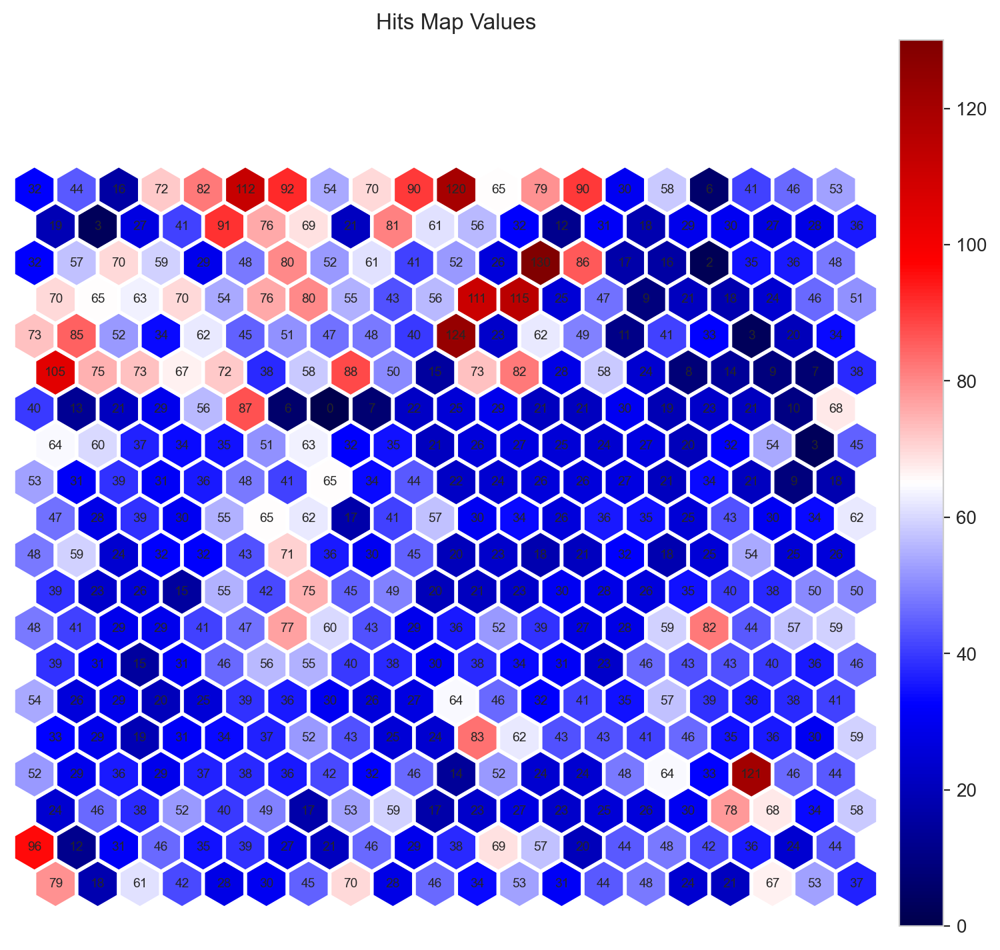

In [137]:
fig = plt.figure(figsize=(9, 9))
plot_hexagons(hitsmatrix, som_value, sf=fig, label="Hits Map Values",
              cmap=cm.seismic, annot_mx=np.round(hitsmatrix, 0).astype(int))
plt.show()

In [138]:
non_zero_hits = hitsmatrix[hitsmatrix > 0]
low_threshold = np.percentile(non_zero_hits, 10)

low_density_mask = (hitsmatrix > 0) & (hitsmatrix <= low_threshold)

low_positions = np.argwhere(low_density_mask)
print(f"Low-density threshold: {low_threshold:.1f}")
print(f"Low-density neuron positions: {low_positions.tolist()}")

low_units = {tuple(pos) for pos in low_positions}

low_idx = [i for i, b in enumerate(bmus) if tuple(b) in low_units]
print(f"Customers in low-density neurons: {len(low_idx)}")

low_customers = df_value.iloc[low_idx]

print("\nSummary statistics of low-density customers:")
low_customers.describe().T

Low-density threshold: 20.0
Low-density neuron positions: [[0, 18], [1, 0], [1, 1], [1, 13], [1, 18], [2, 4], [2, 6], [2, 19], [3, 5], [3, 8], [6, 2], [6, 13], [7, 10], [8, 13], [9, 2], [9, 8], [9, 14], [10, 3], [10, 9], [12, 9], [12, 18], [13, 1], [14, 15], [14, 16], [14, 17], [14, 18], [15, 9], [15, 12], [15, 13], [15, 14], [15, 17], [16, 14], [16, 16], [16, 17], [16, 19], [17, 14], [17, 15], [18, 11], [18, 12], [18, 13], [18, 14], [18, 15], [19, 11]]
Customers in low-density neurons: 995

Summary statistics of low-density customers:


,count,mean,std,min,25%,50%,75%,max
Income,995.0,0.053660,1.004339,-1.788896,-0.776521,0.010541,0.735418,2.262773
Customer Lifetime Value,995.0,-0.022527,0.973997,-1.223848,-0.743769,-0.352313,0.418734,2.183354
TotalPointsRedeemed,995.0,0.086950,0.946049,-0.994010,-0.635685,-0.091854,0.696930,3.002842
RedeemRatio,995.0,0.082700,0.932995,-0.996412,-0.673101,-0.054572,0.639253,2.750169


In [139]:
print(f"Average customers per unit: {hitsmatrix.mean():.1f}")

Average customers per unit: 41.7


In [140]:
print(f"Frequency range: {hitsmatrix.min():.0f} (least) to {hitsmatrix.max():.0f} (most)")

Frequency range: 0 (least) to 130 (most)


---

**Distribution**  
Customers are **not evenly distributed** across the value grid.  
The average number of customers per unit is **~42**, with a frequency range from **0 to 130 customers**, indicating a more balanced distribution than in behaviour but still with clear concentrations and sparsely occupied regions.

**Empty units**  
Yes. There are neurons with **0 customers**, showing areas of the map that do not represent any existing value profile.

**Highest-density units**  
The **most populated neuron** contains **130 customers**, corresponding to the darkest green cell in the hit-map and representing the most common value profile in the dataset.

**Lowest-density units**  
Low-density neurons (non-zero hits below the 10th percentile, threshold ≤20 customers) include positions such as:  
`(0,18), (1,0), (1,1), (2,6), (6,13), (9,2), (12,9), (14,15), (16,14), (18,11)`  
A total of **880 customers (~5.3% of the population)** are mapped to these neurons.

**Characterisation of customers in low-density units**  
Customers in these low-density units show **moderate and near-average economic metrics**, without extreme deviations:
- **income, CLV, redeemed points and redeem ratio are close to zero** (mean values ~0 in standardized form)  
- **interquartile ranges remain centred around the mean**, indicating **no strong skew toward high- or low-value profiles**
- **max values show isolated high contributors**, suggesting **a small number of outliers mixed within an otherwise average segment**

In summary, value-based low-density customers represent **rare but economically average profiles**: they are **not dominant in the market**, **not currently high-value**, but include **a few atypical high contributors** whose characteristics diverge from the main clusters.


#### 2.4.2.4 SOM clustering with K-means

Here, we will cluster the neurals of each cluster using K-Means with the methods we explained before.

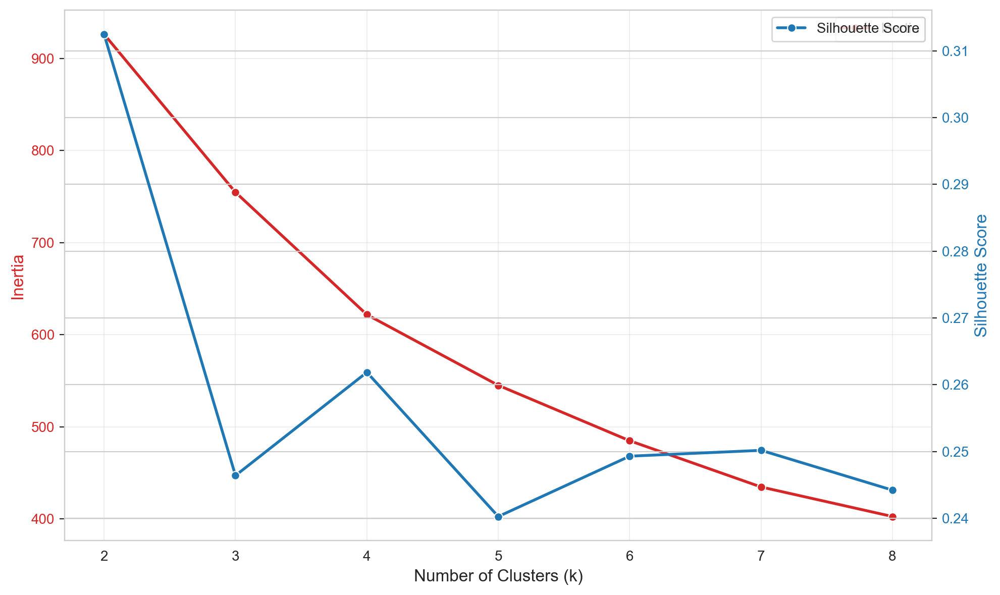

In [142]:
weights_value = som_value.get_weights()
x_val, y_val, n_val = weights_value.shape
weights_value_flat = weights_value.reshape(x_val * y_val, n_val)
inertia_and_silhouette_plots(weights_value_flat, min_clusters=2, max_clusters=8)

We will go with $K=3$, because is the one with the best trade-off of silhouette score and inertia ($K=2$ had a higher score but a really bad value of inertia)

In [143]:
K_value = 3

kmeans_som_value = KMeans(n_clusters=K_value, init='k-means++', n_init=20, random_state=42)
kmeans_som_value.fit(weights_value_flat)

kmeans_som_labels = kmeans_som_value.labels_

kmeans_n_clusters = len(np.unique(kmeans_som_labels))
print(f"Distribution:\n{pd.Series(kmeans_som_labels).value_counts().sort_index()}")

Distribution:
0    127
1    123
2    150
Name: count, dtype: int64


In [144]:
df_value_som_clusters = df_value.copy()
df_value_som_clusters['cluster_labels_value'] = df_value[value_features].apply(
    lambda row: kmeans_som_labels[
        som_value.winner(row.values)[0] * y_val + som_value.winner(row.values)[1]
    ], 
    axis=1
)

cluster_som_value = df_value_som_clusters.groupby('cluster_labels_value')[value_features].mean()

cluster_som_value

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
cluster_labels_value,,,,
0,0.920323,0.097796,-0.515015,-0.525276
1,-0.023377,-0.035278,1.182512,1.221981
2,-0.793718,-0.059927,-0.470152,-0.496596


In [145]:
cluster_pct_som = (
    df_value_som_clusters["cluster_labels_value"]
    .value_counts(normalize=True)
    .sort_index()
    .mul(100)
    .round(2)
)

cluster_dist_som = pd.DataFrame({
    "count": df_value_som_clusters["cluster_labels_value"].value_counts().sort_index(),
    "pct_%": cluster_pct_som
})

cluster_dist_som


,count,pct_%
cluster_labels_value,,
0,5523,33.10
1,4905,29.39
2,6259,37.51


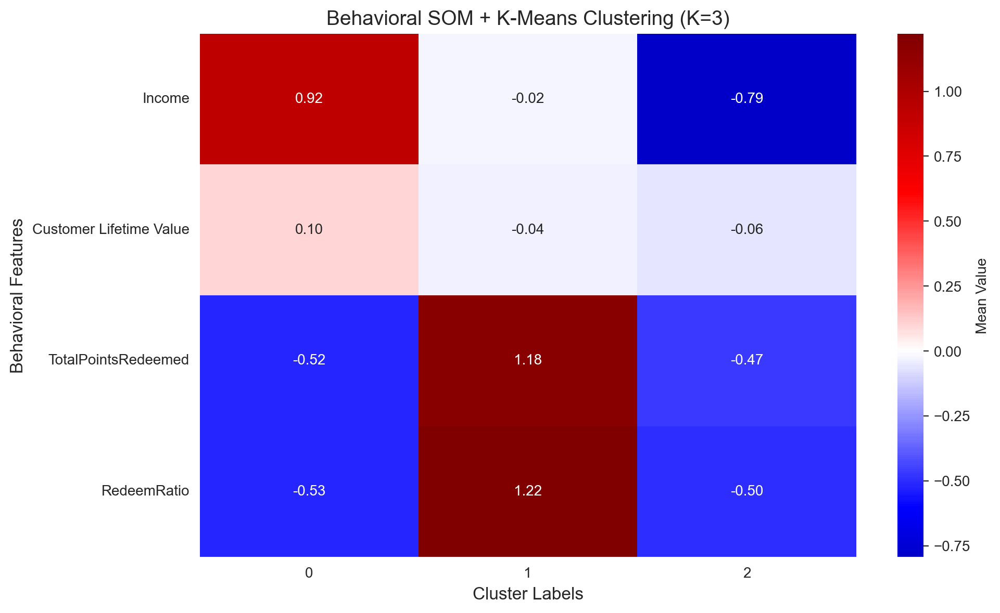

In [146]:
fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(cluster_som_value.T,
            center=0, annot=True, cmap="seismic", fmt=".2f",
            ax=ax, cbar_kws={'label': 'Mean Value'})
ax.set_xlabel("Cluster Labels", fontsize=12)
ax.set_ylabel("Behavioral Features", fontsize=12)
ax.set_title(f"Behavioral SOM + K-Means Clustering (K={K_value})", fontsize=14)
plt.tight_layout()
plt.show()

**Value SOM + K-Means Clustering (K=3)**

**Cluster 0: High-Income Low-Engagement Customers (32.4%)**
* **Characteristics:**
   * **Income**: +0.93 (very high) -> Significantly above-average earning customers
   * **Customer Lifetime Value**: +0.12 (slightly above average) -> Modest economic contribution despite high income
   * **TotalPointsRedeemed**: -0.52 (low) -> Minimal loyalty program usage
   * **RedeemRatio**: -0.52 (low) -> Low point redemption rate
* **Profile:** Affluent customers who don't actively engage with the loyalty program. Despite high income, generate only modest lifetime value, suggesting untapped monetization potential. Price-insensitive but program-indifferent segment requiring activation strategies to convert income advantage into revenue.

**Cluster 1: Average-Income Low-Value Customers (37.8%)**
* **Characteristics:**
   * **Income**: -0.79 (below average) -> Lower earning customers
   * **Customer Lifetime Value**: -0.10 (below average) -> Modest economic contribution
   * **TotalPointsRedeemed**: -0.48 (low) -> Below-average program usage
   * **RedeemRatio**: -0.50 (low) -> Low redemption rate
* **Profile:** Baseline segment with below-average income and value generation. Limited loyalty program engagement suggests price-sensitive customers with minimal brand affinity. Largest segment representing the economic middle-ground requiring volume-based strategies.

**Cluster 2: Active Loyalty Enthusiasts (29.9%)**
* **Characteristics:**
   * **Income**: -0.02 (average) -> Near-average earning level
   * **Customer Lifetime Value**: -0.01 (average) -> Average economic contribution
   * **TotalPointsRedeemed**: +1.17 (very high) -> Heavy loyalty program users
   * **RedeemRatio**: +1.20 (very high) -> Maximum point redemption efficiency
* **Profile:** Deal-seekers who maximize point redemption despite average income and CLV. High program engagement but moderate profitability suggests value-extracting behavior. Strong loyalty program affinity makes them ideal for upselling premium services or products through points-based incentives.

**Key Insights:**
1. **Cluster 0** (32.4%) represents **untapped high-income potential** (affluent but disengaged), critical activation opportunity
2. **Cluster 1** (37.7%) is the **largest baseline segment** (low income, low value, low engagement), requires volume-based retention
3. **Cluster 2** (29.9%) shows **loyalty program success** (high redemption despite average value), leverage for upselling and cross-selling
4. **Income-CLV disconnect**: High income (Cluster 0) doesn't guarantee high value, while average income (Cluster 2) can drive strong program engagement
5. **Redemption paradox**: Highest redeemers (Cluster 2) generate only average CLV, suggesting program mechanics may enable value extraction rather than premium spending

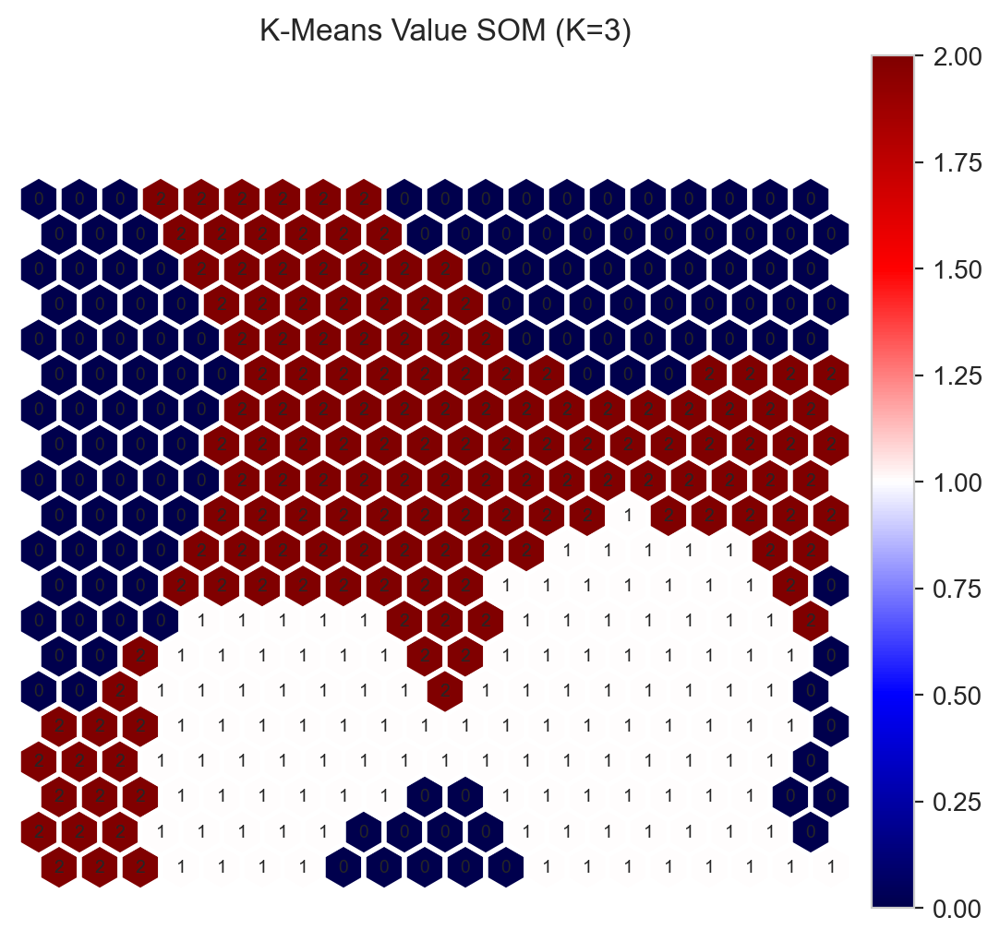

In [147]:
weights_value = som_value.get_weights()
x_val, y_val, n_val = weights_value.shape

fig1 = plt.figure(figsize=(9, 6))
kmeans_value_matrix = kmeans_som_labels.reshape((x_val, y_val))
plot_hexagons(kmeans_value_matrix, som_value, fig1, 
              label=f"K-Means Value SOM (K={K_value})", cmap=cm.seismic, 
              annot_mx=kmeans_value_matrix)
plt.show()

**Cluster 0 (Dark Blue):**
- Left side, top-right edges, and scattered bottom portions
- Corresponds to High-Income Low-Engagement Customers (32.42%)

**Cluster 1 (White):**
- Diagonal band from upper-left to center-right, largest spatial coverage
- Corresponds to Average-Income Low-Value Customers (37.66%)

**Cluster 2 (Red):**
- Center-bottom region, concentrated zone
- Corresponds to Active Loyalty Enthusiasts (29.92%)

**Key Observations:**
Balanced spatial distribution with each cluster occupying substantial regions (30-40% each). Clear boundaries with diagonal separation between Clusters 0 and 1, and concentrated Cluster 2 in center-bottom. Spatial distribution aligns with U-Matrix boundaries and component plane patterns (Income diagonal, CLV top-right, Redemption bottom-right). More balanced allocation confirms value features produce better natural segmentation than behavioral features.

### 2.4.3 Density Based Clustering

#### 2.4.3.1 DBSCAN

In [148]:
dbscan_data_value = df_value.values

Number of value SOM features: 4
Recommended min_samples: 8


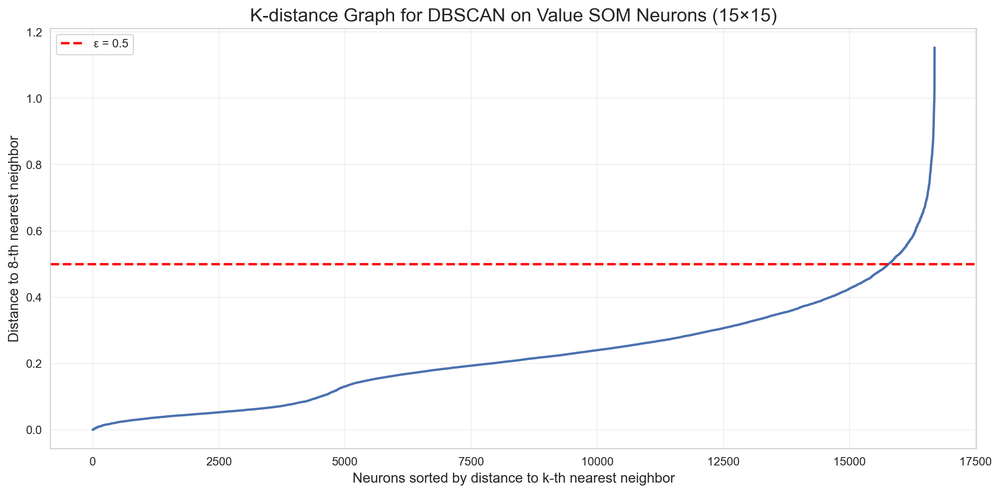

In [149]:
min_samples_value = 2 * len(value_features)
print(f"Number of value SOM features: {len(value_features)}")
print(f"Recommended min_samples: {min_samples_value}")

neigh_value = NearestNeighbors(n_neighbors=min_samples_value)
neighbors_fit = neigh_value.fit(dbscan_data_value)

distances_value, _ = neighbors_fit.kneighbors(dbscan_data_value)
distances_sorted_value = np.sort(distances_value[:, -1], axis=0)

df_k = pd.DataFrame({
    "Neuron rank": np.arange(len(distances_sorted_value)),
    "k-distance": distances_sorted_value
})

plt.figure(figsize=(12, 6))

sns.lineplot(
    data=df_k,
    x="Neuron rank",
    y="k-distance",
    linewidth=2
)

plt.axhline(
    y=0.5,
    color="red",
    linestyle="--",
    linewidth=2,
    label="ε = 0.5"
)

plt.title(
    f"K-distance Graph for DBSCAN on Value SOM Neurons ({x_beh}×{y_beh})",
    fontsize=16
)
plt.xlabel(
    "Neurons sorted by distance to k-th nearest neighbor",
    fontsize=12
)
plt.ylabel(
    f"Distance to {min_samples_value}-th nearest neighbor",
    fontsize=12
)
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [150]:
dbscan_behavior = DBSCAN(eps=0.5, min_samples=min_samples_value, n_jobs=-1)

dbscan_labels_value = dbscan_behavior.fit_predict(dbscan_data_value)

print(f"  Cluster distribution:\n{pd.Series(dbscan_labels_value).value_counts().sort_index()}")

  Cluster distribution:
-1      382
 0    16285
 1       11
 2        9
Name: count, dtype: int64


In [151]:
df_value_dbscan_clusters = df_value.copy()
df_value_dbscan_clusters['cluster_labels_value'] = dbscan_labels_value

cluster_dbscan_value = df_value_dbscan_clusters[list(value_features) + ['cluster_labels_value']].groupby('cluster_labels_value').mean()
cluster_dbscan_value

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
cluster_labels_value,,,,
-1,0.595024,0.927769,1.181030,2.087333
0,-0.013351,-0.024934,-0.026232,-0.053289
1,0.238272,2.183354,-0.569945,2.747265
2,-1.343681,2.180744,-0.509962,2.750169


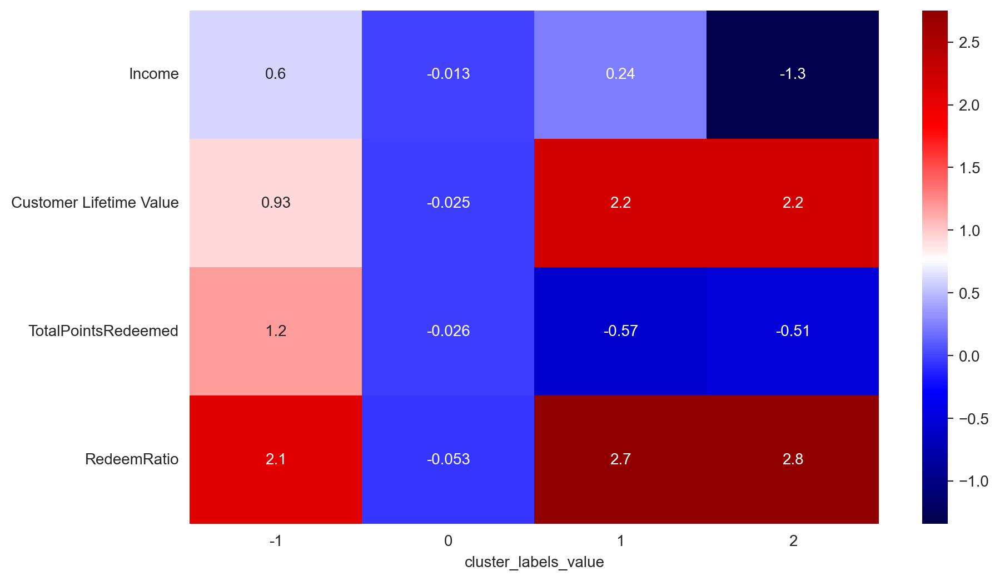

In [152]:
sns.heatmap(cluster_dbscan_value.T, annot=True, cmap="seismic", center=cluster_dbscan_value.values.mean())
plt.show()

**DBSCAN Outlier Profile: Value Perspective**

**Cluster -1 (High-Redemption Enthusiasts - Outliers):**
* **Characteristics:**
   * **Income**: +0.6 (above average) -> Moderate-high earning customers
   * **Customer Lifetime Value**: +0.93 (high) -> Strong economic contribution
   * **TotalPointsRedeemed**: +1.2 (high) -> Heavy loyalty program usage
   * **RedeemRatio**: **+2.1 (very high)** -> Extreme point redemption efficiency
* **Profile:** Loyalty program power-users with exceptional redemption behavior. High CLV combined with extreme redemption rates suggests sophisticated program engagement. DBSCAN correctly identifies these as anomalous due to unusually high redemption efficiency relative to typical customers.

**Cluster 0 (Average Baseline):**
* **Characteristics:**
   * **Income**: -0.013 (average) -> Near-average earning level
   * **Customer Lifetime Value**: -0.025 (average) -> Typical economic contribution
   * **TotalPointsRedeemed**: -0.026 (average) -> Moderate program usage
   * **RedeemRatio**: -0.053 (average) -> Typical redemption rate
* **Profile:** Standard baseline segment representing the typical customer with average values across all dimensions. Moderate engagement with loyalty program, representing the core mass of customers.

**Cluster 1 (Premium High-Value):**
* **Characteristics:**
   * **Income**: +0.24 (above average) -> Moderate-high earning customers
   * **Customer Lifetime Value**: **+2.2 (very high)** -> Exceptional economic contribution
   * **TotalPointsRedeemed**: -0.57 (below average) -> Minimal program usage
   * **RedeemRatio**: **+2.7 (very high)** -> High redemption efficiency despite low absolute usage
* **Profile:** Premium customers with exceptional CLV but minimal absolute point redemption. High redemption ratio despite low usage suggests selective, strategic program engagement. Focus on revenue generation over point accumulation.

**Cluster 2 (Ultra-Premium Champions):**
* **Characteristics:**
   * **Income**: **-1.3 (low)** -> Below-average earning level
   * **Customer Lifetime Value**: **+2.2 (very high)** -> Exceptional economic contribution
   * **TotalPointsRedeemed**: -0.51 (below average) -> Minimal program usage
   * **RedeemRatio**: **+2.8 (very high)** -> Extreme redemption efficiency
* **Profile:** Paradoxical ultra-premium segment with low income but exceptional CLV. Minimal point redemption despite high efficiency suggests price-insensitive behavior or business travel accounts. Highest value customers who don't rely on income advantage.

**Key Observations:**
- **Cluster -1 (outliers) = Redemption extremists**: DBSCAN identified extreme RedeemRatio (+2.1) as anomalous, validating these as loyalty program super-users
- **Income-CLV disconnect validated**: Cluster 2 shows low income (-1.3) with very high CLV (+2.2), confirming behavioral factors drive value beyond demographics
- **Cluster 0 = Average baseline**: Near-zero values represent typical customer profile
- **Premium segments (1 and 2)**: Both show exceptional CLV (+2.2) but differ in income levels, demonstrating value diversity
- **Redemption paradox**: Highest CLV clusters (1, 2) have lowest absolute redemption (-0.51 to -0.57), while outliers (-1) maximize redemption (+1.2), suggesting different value extraction strategies

#### 2.4.3.2 Mean Shift Clustering


In [153]:
mean_shift_data = df_value.values.copy()

In [154]:
bw_01 = estimate_bandwidth(mean_shift_data, quantile=0.09, random_state=1, n_jobs=-1)
ms_01 = MeanShift(bandwidth=bw_01)
labels_01 = ms_01.fit_predict(mean_shift_data)

bw_02 = estimate_bandwidth(mean_shift_data, quantile=0.07, random_state=1, n_jobs=-1)
ms_02 = MeanShift(bandwidth=bw_02)
labels_02 = ms_02.fit_predict(mean_shift_data)

print("=== 3 Clusters (quantile=0.09) ===")
print(f"Silhouette Score: {silhouette_score(mean_shift_data, labels_01):.3f}")  
print(f"Davies-Bouldin Index: {davies_bouldin_score(mean_shift_data, labels_01):.3f}") 
print(f"Distribution: {pd.Series(labels_01).value_counts().sort_index().to_dict()}")

print("\n=== 4 Clusters (quantile=0.07) ===")
print(f"Silhouette Score: {silhouette_score(mean_shift_data, labels_02):.3f}")
print(f"Davies-Bouldin Index: {davies_bouldin_score(mean_shift_data, labels_02):.3f}")
print(f"Distribution: {pd.Series(labels_02).value_counts().sort_index().to_dict()}")

=== 3 Clusters (quantile=0.09) ===
Silhouette Score: 0.288
Davies-Bouldin Index: 1.324
Distribution: {0: 11446, 1: 3379, 2: 1862}

=== 4 Clusters (quantile=0.07) ===
Silhouette Score: 0.270
Davies-Bouldin Index: 1.384
Distribution: {0: 9868, 1: 2610, 2: 3370, 3: 839}


In [155]:
bandwidth = estimate_bandwidth(mean_shift_data, 
                               quantile=0.09,
                               random_state=1,
                               n_jobs=-1)
bandwidth

np.float64(1.316252236935576)

In [156]:
ms = MeanShift(bandwidth=bandwidth)
ms.fit(mean_shift_data)

ms_labels = ms.labels_
cluster_centers = ms.cluster_centers_

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 3


In [157]:
df_value_mean_shift_clusters = df_value.copy()
df_value_mean_shift_clusters['cluster_labels_value'] = ms_labels

cluster_mean_shift_behavior = df_value_mean_shift_clusters[list(value_features) + ['cluster_labels_value']].groupby('cluster_labels_value').mean()
cluster_mean_shift_behavior

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
cluster_labels_value,,,,
0,-0.016708,-0.127262,-0.469348,-0.535249
1,-0.048903,-0.486681,1.182605,1.364706
2,0.191668,1.661197,0.746106,0.805392


#### 2.4.3.3 Gaussian Mixture Model

In [158]:
gmm_data = df_value.values.copy()

In [159]:
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(gmm_data)
          for n in n_components]

bic_values = [m.bic(gmm_data) for m in models]
aic_values = [m.aic(gmm_data) for m in models]

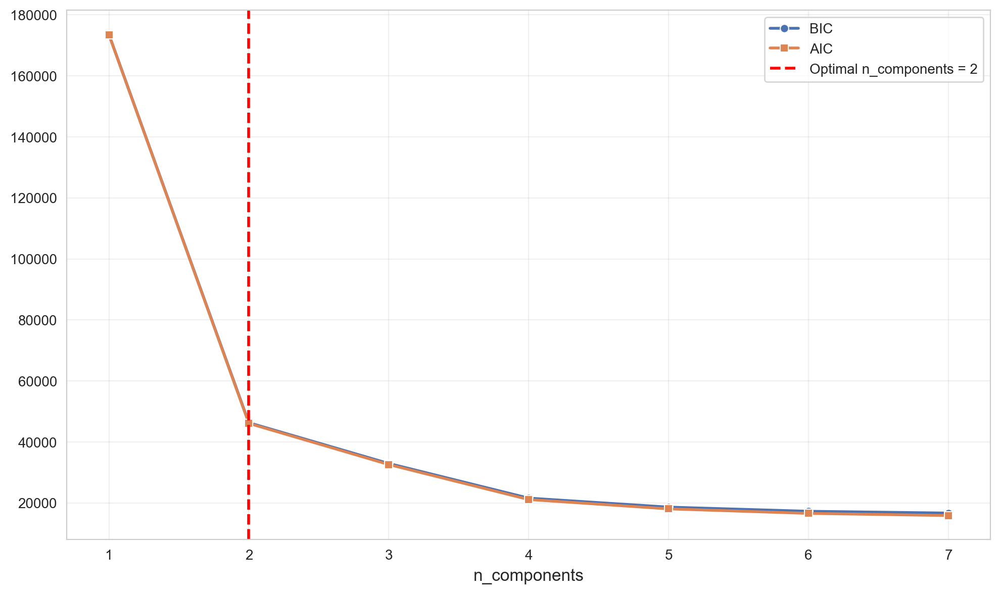

In [160]:
plt.figure(figsize=(10, 6))

sns.lineplot(
    x=n_components,
    y=bic_values,
    marker="o",
    linewidth=2,
    label="BIC"
)

sns.lineplot(
    x=n_components,
    y=aic_values,
    marker="s",
    linewidth=2,
    label="AIC"
)

plt.axvline(
    x=2,
    color="red",
    linestyle="--",
    linewidth=2,
    label="Optimal n_components = 2"
)

plt.xlabel("n_components", fontsize=12)
plt.xticks(n_components)
plt.legend(loc="best")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

We will go with $n components=2$

In [161]:
gmm = GaussianMixture(n_components=2, 
                      covariance_type='full', 
                      n_init=10, 
                      init_params='kmeans', 
                      random_state=1)

gmm_labels = gmm.fit_predict(gmm_data)

In [162]:
df_value_gmm_clusters = df_value.copy()
df_value_gmm_clusters['cluster_labels_value'] = gmm_labels

cluster_gmm_value = df_value_gmm_clusters[list(value_features) + ['cluster_labels_value']].groupby('cluster_labels_value').mean()

cluster_gmm_value

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
cluster_labels_value,,,,
0,0.005655,0.007119,-0.994010,-0.996412
1,-0.002515,-0.003905,0.449356,0.447954


In [163]:
df_value_gmm_clusters['cluster_labels_value'].value_counts().sort_index()

cluster_labels_value
0     5186
1    11501
Name: count, dtype: int64

In [164]:
probabilities = gmm.predict_proba(df_value)
probabilities

array([[9.99999293e-01, 7.07481995e-07],
       [9.99999298e-01, 7.02262152e-07],
       [9.99999311e-01, 6.89323731e-07],
       ...,
       [9.99999306e-01, 6.94387743e-07],
       [9.99999291e-01, 7.08679762e-07],
       [9.99999300e-01, 7.00397138e-07]], shape=(16687, 2))

In [165]:
max_probs = probabilities.max(axis=1)
uncertain_threshold = 0.7
certain_customers = df_value[max_probs >= uncertain_threshold]
uncertain_customers = df_value[max_probs < uncertain_threshold]

print(f"GMM Probability Analysis:")
print(f"- Clear assignments (≥70% probability): {len(certain_customers):,} customers")
print(f"- Uncertain assignments (<70% probability): {len(uncertain_customers):,} customers ({len(uncertain_customers)/len(df_value):.1%})")

GMM Probability Analysis:
- Clear assignments (≥70% probability): 16,687 customers
- Uncertain assignments (<70% probability): 0 customers (0.0%)


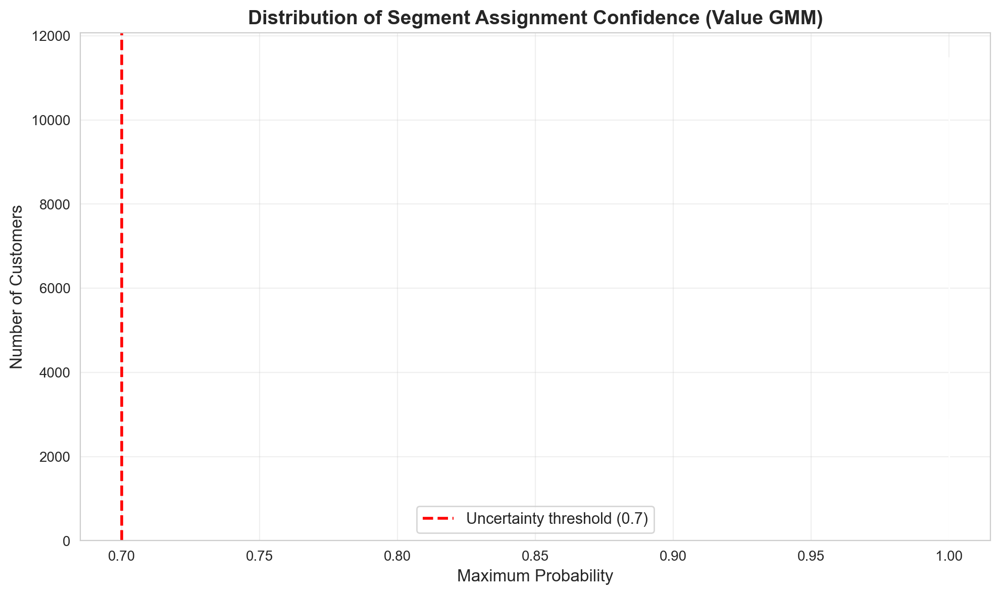

In [166]:
plt.figure(figsize=(10, 6))

sns.histplot(
    max_probs,
    bins=50
)

plt.axvline(
    x=uncertain_threshold,
    color="red",
    linestyle="--",
    linewidth=2,
    label=f"Uncertainty threshold ({uncertain_threshold})"
)

plt.xlabel("Maximum Probability", fontsize=12)
plt.ylabel("Number of Customers", fontsize=12)
plt.title(
    "Distribution of Segment Assignment Confidence (Value GMM)",
    fontsize=14,
    fontweight="bold"
)
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

**Results:**
- All 16,687 customers (100%) have clear assignments (≥70% probability)
- 0 customers with uncertain assignments
- Probabilities are extreme: ~0.0000 or ~1.0000

**Perfect Separation:**
Zero overlap between clusters. Value features create two completely distinct groups with no middle ground.

**Implications:**
- **Positive**: Clean segmentation, straightforward targeting, no ambiguous cases
- **Concern**: K=2 may oversimplify - could 3-4 clusters reveal more nuance?
- **Note**: 0.7 threshold irrelevant when all probabilities are binary

### 2.4.4 Comparing Models

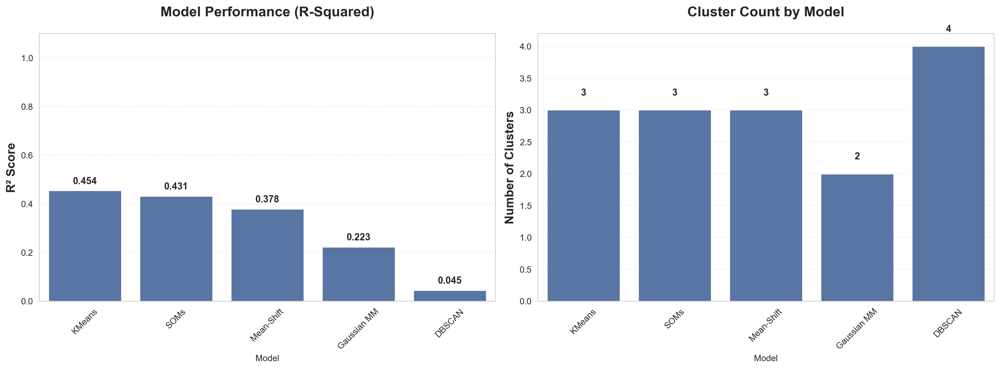

In [167]:
Preference_models = {
    "KMeans": df_value_KM_clusters,
    "SOMs": df_value_som_clusters,
    "DBSCAN": df_value_dbscan_clusters,
    "Mean-Shift": df_value_mean_shift_clusters,
    "Gaussian MM": df_value_gmm_clusters
}
compare_models(Preference_models, cluster_column="cluster_labels_value")

# 3. Combining Segments

As it could be seen in 2.3.4 and 2.4.4, by evaluating the R2 in every model we tried, we concluded that the best combo is SOM in behavioral features (with 4 clusters) and K-means in value features (with 3 clusters). We will now combine them.

In [168]:
df_value_KM_clusters.head()

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio,cluster_labels_value
Loyalty#,,,,,
123928,-0.973912,-0.603743,-0.99401,-0.996412,0
857845,-0.415536,-0.764430,-0.99401,-0.996412,0
948961,2.007348,0.173430,-0.99401,-0.996412,0
647393,-0.158062,0.279391,-0.99401,-0.996412,0
170982,-1.614595,2.183354,-0.99401,-0.996412,1


In [169]:
df_behaviour_som_clusters.head()

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3,cluster_labels_behavior
Loyalty#,,,,,,,,
123928,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
857845,-1.470114,0.732332,-0.128213,0.046845,-0.207219,0.760586,1.215710,3
948961,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
647393,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
170982,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3


We now have 4 behaviour clusters and 3 value clusters. We will merge them but first we will see the overlap:

In [170]:
df_merged_clusters = df_value_KM_clusters.merge(
    df_behaviour_som_clusters,
    left_index=True,
    right_index=True,
    how='inner'
)
df_merged_clusters.head()

,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio,cluster_labels_value,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3,cluster_labels_behavior
Loyalty#,,,,,,,,,,,,,
123928,-0.973912,-0.603743,-0.99401,-0.996412,0,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
857845,-0.415536,-0.764430,-0.99401,-0.996412,0,-1.470114,0.732332,-0.128213,0.046845,-0.207219,0.760586,1.215710,3
948961,2.007348,0.173430,-0.99401,-0.996412,0,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
647393,-0.158062,0.279391,-0.99401,-0.996412,0,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3
170982,-1.614595,2.183354,-0.99401,-0.996412,1,-1.470114,-1.749105,-1.465181,-0.236183,-1.507944,-1.298282,-1.509618,3


Value Cluster,0,1,2
Behaviour Cluster,,,
0,4555,1824,4247
1,785,226,238
2,361,104,169
3,2771,732,675


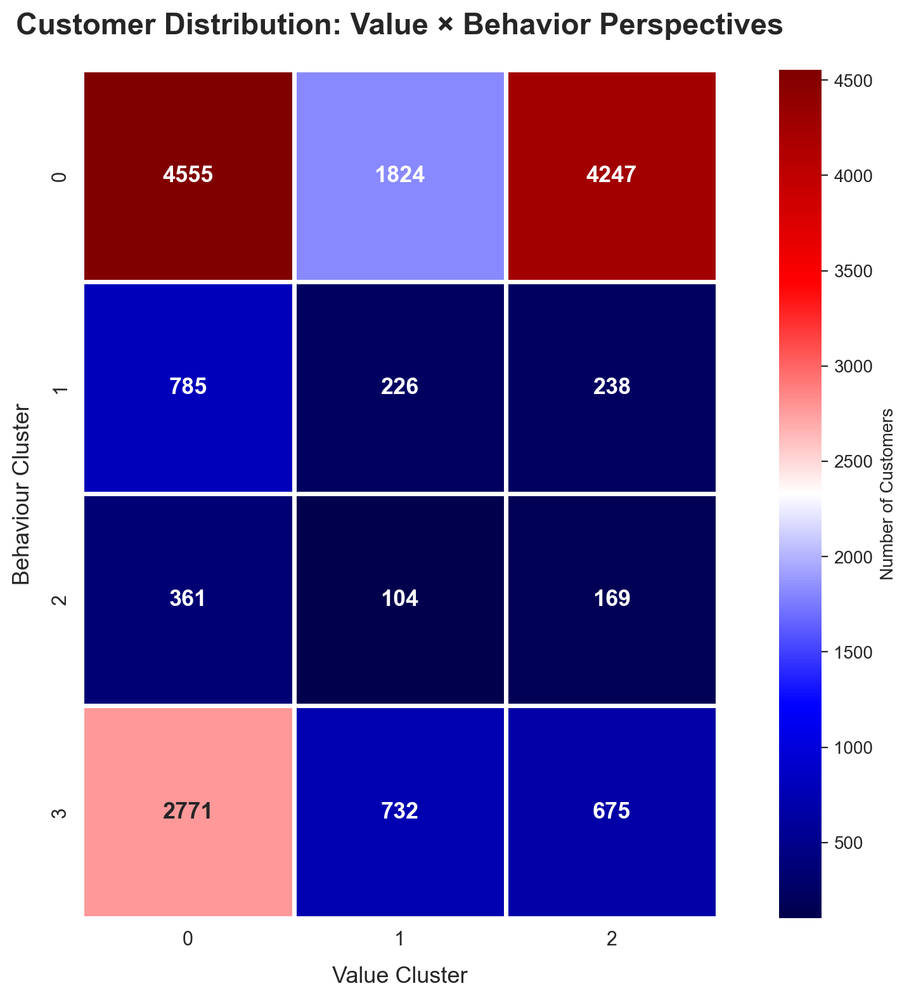

In [172]:
crosstab = pd.crosstab(
    df_merged_clusters['cluster_labels_behavior'],
    df_merged_clusters['cluster_labels_value'],
    rownames=['Behaviour Cluster'],
    colnames=['Value Cluster']
)

display(crosstab)

fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(crosstab, 
            annot=True, 
            fmt='d', 
            cmap='seismic',
            cbar_kws={'label': 'Number of Customers'},
            linewidths=2.5,
            linecolor='white',
            square=True,
            ax=ax,
            annot_kws={'fontsize': 13, 'fontweight': 'bold'})
ax.set_title('Customer Distribution: Value × Behavior Perspectives', 
              fontsize=17, fontweight='bold', pad=20)
ax.set_xlabel('Value Cluster', fontsize=13, labelpad=10)
ax.set_ylabel('Behaviour Cluster', fontsize=13, labelpad=10)
ax.tick_params(labelsize=11)
plt.tight_layout()
plt.show()

**The Intersection of Value and Behavioral Segments**

The crosstabulation reveals how value-based and behavioral segments intersect, identifying **12 distinct customer profiles** from combining both perspectives:

**Distribution Matrix:**

| Behavior Cluster | Value 0 (Low-Value Non-Engagers) | Value 1 (Premium High-Value) | Value 2 (Loyalty Enthusiasts) | Total |
|------------------|----------------------------------|------------------------------|-------------------------------|-------|
| **0 (Established Active)** | 4,555 | 1,824 | 4,247 | 10,626 |
| **1 (Seasonal Solo)** | 785 | 226 | 238 | 1,249 |
| **2 (High-Growth)** | 361 | 104 | 169 | 634 |
| **3 (At-Risk)** | 2,771 | 732 | 675 | 4,178 |
| **Total** | 8,472 | 2,886 | 5,329 | 16,687 |

**Key Patterns:**

**Dominant Combination: Established Active + Low-Value Non-Engagers (4,555)**
- Largest single segment
- High frequency, limited spending, minimal program usage
- Upselling and program activation opportunity

**Loyalty Program Validation**
- Loyalty Enthusiasts concentrated in Established Active (4,247)
- Minimal presence in At-Risk (675)
- Confirms program effectiveness in maintaining engagement

**Premium Distribution**
- Premium customers present across all behavioral segments
- Not concentrated exclusively in active travelers
- CLV partially independent of flight frequency

**At-Risk Concentration**
- Largest low-engagement segment (4,178 total)
- Predominantly Low-Value (2,771)
- **732 Premium at risk**: Critical intervention priority

**High-Growth Segment**
- Smallest segment (634 total)
- **104 Premium with explosive growth**: Highest future ROI
- **169 Loyalty members accelerating**: Program driving rapid engagement

**Strategic Implications:**

1. **Established Active + Low-Value (4,555)**: Largest upselling opportunity
2. **Established Active + Premium (1,824)**: Core revenue base, VIP retention
3. **Established Active + Loyalty (4,247)**: Program success, maintain with fresh options
4. **At-Risk + Premium (732)**: Critical churn risk, immediate intervention
5. **High-Growth + Premium (104)**: Highest future value despite small size
6. **At-Risk segments (4,178)**: One-quarter of base declining, retention strategy needed

**Key Takeaway:** Established Active travelers dominate the customer base (63.7%), representing the core behavioral pattern of consistent year-round engagement. Value segmentation cuts across all behavioral types, with Premium customers distributed throughout (not concentrated in high-frequency segments alone), confirming that exceptional CLV is driven by spending power and travel style rather than flight volume alone.

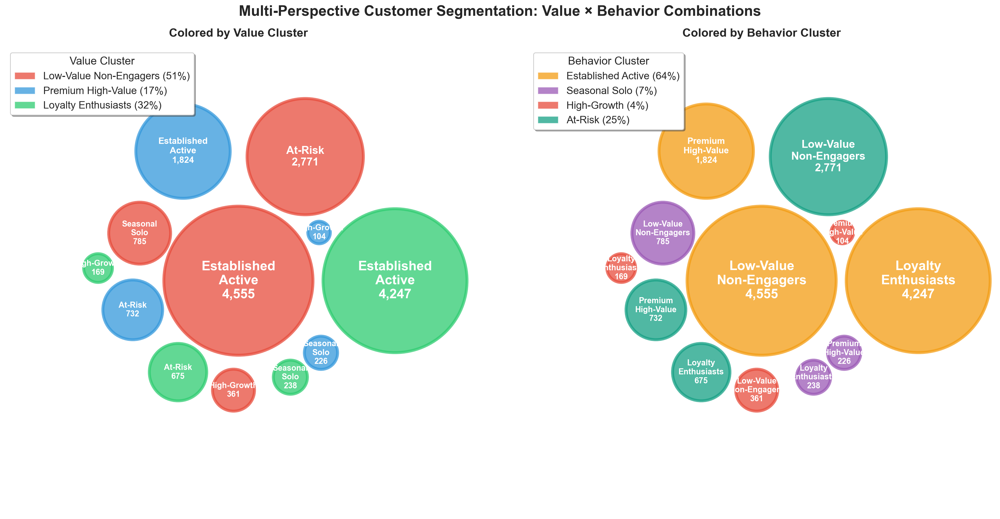

In [174]:
def create_bubble_chart(ax, bubble_data, color_by='value'):
    value_labels = {
        0: 'Low-Value\nNon-Engagers', 
        1: 'Premium\nHigh-Value', 
        2: 'Loyalty\nEnthusiasts'
    }
    behavior_labels = {
        0: 'Established\nActive', 
        1: 'Seasonal\nSolo', 
        2: 'High-Growth', 
        3: 'At-Risk'
    }
    
    bubble_data['value_name'] = bubble_data['Value Cluster'].map(value_labels)
    bubble_data['behavior_name'] = bubble_data['Behaviour Cluster'].map(behavior_labels)
    
    if color_by == 'value':
        # Show only behavior name and count (value is in legend)
        bubble_data['label'] = bubble_data.apply(
            lambda row: f"{row['behavior_name']}\n{row['count']:,}",
            axis=1
        )
    else:  # behavior
        # Show only value name and count (behavior is in legend)
        bubble_data['label'] = bubble_data.apply(
            lambda row: f"{row['value_name']}\n{row['count']:,}",
            axis=1
        )
    
    if color_by == 'value':
        color_map = {0: '#e74c3c', 1: '#3498db', 2: '#2ecc71'}
        bubble_data['color'] = bubble_data['Value Cluster'].map(color_map)
        
        # Calculate percentages
        total = bubble_data['count'].sum()
        pcts = crosstab.sum(axis=0) / total * 100
        
        legend_elements = [
            Circle((0, 0), 1, facecolor='#e74c3c', label=f'Low-Value Non-Engagers ({pcts[0]:.0f}%)', alpha=0.75),
            Circle((0, 0), 1, facecolor='#3498db', label=f'Premium High-Value ({pcts[1]:.0f}%)', alpha=0.75),
            Circle((0, 0), 1, facecolor='#2ecc71', label=f'Loyalty Enthusiasts ({pcts[2]:.0f}%)', alpha=0.75),
        ]
        legend_title = 'Value Cluster'
        title_suffix = 'Value Cluster'
        
    else:  # behavior
        color_map = {0: '#f39c12', 1: '#9b59b6', 2: '#e74c3c', 3: '#16a085'}
        bubble_data['color'] = bubble_data['Behaviour Cluster'].map(color_map)
        
        # Calculate percentages
        total = bubble_data['count'].sum()
        pcts = crosstab.sum(axis=1) / total * 100
        
        legend_elements = [
            Circle((0, 0), 1, facecolor='#f39c12', label=f'Established Active ({pcts[0]:.0f}%)', alpha=0.75),
            Circle((0, 0), 1, facecolor='#9b59b6', label=f'Seasonal Solo ({pcts[1]:.0f}%)', alpha=0.75),
            Circle((0, 0), 1, facecolor='#e74c3c', label=f'High-Growth ({pcts[2]:.0f}%)', alpha=0.75),
            Circle((0, 0), 1, facecolor='#16a085', label=f'At-Risk ({pcts[3]:.0f}%)', alpha=0.75),
        ]
        legend_title = 'Behavior Cluster'
        title_suffix = 'Behavior Cluster'
    
    # Calculate bubble radius proportional to customer count
    bubble_data['radius'] = np.sqrt(bubble_data['count'] / np.pi) * 0.025
    
    # Sort by size (largest first for better packing)
    bubble_data = bubble_data.sort_values('count', ascending=False).reset_index(drop=True)
    
    # Initialize positions
    bubble_data['x'] = 0.0
    bubble_data['y'] = 0.0
    
    # Circle packing algorithm
    for i, row in bubble_data.iterrows():
        if i == 0:
            # Place first (largest) bubble at center
            bubble_data.at[i, 'x'] = 0
            bubble_data.at[i, 'y'] = 0
        else:
            placed = False
            radius_offset = 0
            
            # Try to place bubble in spiral pattern
            while not placed:
                for a in np.linspace(0, 2*np.pi, 36):
                    test_x = radius_offset * np.cos(a)
                    test_y = radius_offset * np.sin(a)
                    
                    # Check for collisions with existing bubbles
                    collision = False
                    for j in range(i):
                        dist = np.sqrt((test_x - bubble_data.at[j, 'x'])**2 + 
                                     (test_y - bubble_data.at[j, 'y'])**2)
                        min_dist = bubble_data.at[i, 'radius'] + bubble_data.at[j, 'radius'] + 0.05
                        
                        if dist < min_dist:
                            collision = True
                            break
                    
                    if not collision:
                        bubble_data.at[i, 'x'] = test_x
                        bubble_data.at[i, 'y'] = test_y
                        placed = True
                        break
                
                radius_offset += 0.2
    
    # Draw bubbles
    for idx, row in bubble_data.iterrows():
        circle = Circle((row['x'], row['y']), row['radius'], 
                        color=row['color'], alpha=0.75, 
                        edgecolor='white', linewidth=4)
        ax.add_patch(circle)
        
        # Add labels with adaptive font size
        fontsize = max(11, min(18, row['radius'] * 20))
        ax.text(row['x'], row['y'], row['label'],
                ha='center', va='center',
                fontsize=fontsize, fontweight='bold',
                color='white',
                multialignment='center')
    
    # Add legend
    ax.legend(handles=legend_elements, loc='upper left', 
              title=legend_title, fontsize=14, title_fontsize=15,
              frameon=True, shadow=True)
    
    # Set plot limits
    max_extent = bubble_data[['x', 'y', 'radius']].apply(
        lambda row: max(abs(row['x']) + row['radius'], abs(row['y']) + row['radius']), axis=1
    ).max()
    
    ax.set_xlim(-max_extent*1.02, max_extent*1.02)
    ax.set_ylim(-max_extent*1.02, max_extent*1.02)
    ax.set_aspect('equal')
    ax.axis('off')
    
    ax.set_title(f'Colored by {title_suffix}', 
                fontsize=16, fontweight='bold', pad=15)

# Prepare data
bubble_data_base = crosstab.reset_index().melt(id_vars='Behaviour Cluster', 
                                                var_name='Value Cluster', 
                                                value_name='count')
bubble_data_base = bubble_data_base[bubble_data_base['count'] > 0].reset_index(drop=True)

# Create bubble charts
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

create_bubble_chart(ax1, bubble_data_base.copy(), color_by='value')
create_bubble_chart(ax2, bubble_data_base.copy(), color_by='behavior')

fig.suptitle('Multi-Perspective Customer Segmentation: Value × Behavior Combinations', 
             fontsize=20, fontweight='bold', y=0.98)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

**Multi-Perspective Segmentation: Cross-Distribution Analysis**

**Left Panel: Behavioral Distribution within Each Value Cluster**

- **Low-Value Non-Engagers**: Dominated by Established Active (54%), significant At-Risk (33%), smaller Seasonal Solo (9%) and High-Growth (4%)
- **Premium High-Value**: Concentrated in Established Active (64%), moderate At-Risk (26%), minimal Seasonal Solo (8%) and High-Growth (4%)
- **Loyalty Enthusiasts**: Overwhelmingly Established Active (79%), moderate At-Risk (13%), minimal Seasonal Solo (4%) and High-Growth (3%)

**Right Panel: Value Distribution within Each Behavior Cluster**

- **Established Active (63.7%)**: Balanced - Low-Value (43%), Loyalty (40%), Premium (17%)
- **Seasonal Solo (7.5%)**: Low-Value (63%), Loyalty (19%), Premium (18%)
- **High-Growth (3.8%)**: Skewed Low-Value (57%), Loyalty (27%), Premium (16%)
- **At-Risk (25%)**: Heavily Low-Value (66%), Loyalty (16%), Premium (18%)

**Key Insights:**

1. **Loyalty validates retention**: 79% Established Active vs. 13% At-Risk
2. **Premium across all behaviors**: Instead of being in only one behaviour
3. **Established Active dominates**: 54-79% across all value tiers
4. **At-Risk has 732 Premium**: Critical churn intervention priority
5. **Partial independence**: Value and behavior are distinct dimensions

## 3.1 Merging Clusters

Now, we will finally merge the two clusters. We will first create 8 centroids (they should be 9 but on of them is empty) by averaging the values within the cluster:

In [176]:
metric_features = behavioral_features + value_features

df_centroids = df_merged_clusters.groupby(['cluster_labels_behavior', 'cluster_labels_value'])[metric_features].mean()
df_centroids

Tenure  avg_monthly_flights  \
cluster_labels_behavior cluster_labels_value                                  
0                       0                     0.509728             0.604732   
                        1                     0.495012             0.653031   
                        2                     0.510104             0.665248   
1                       0                    -1.176759            -1.501669   
                        1                    -1.205916            -1.502076   
                        2                    -1.181657            -1.434091   
2                       0                    -0.802124            -0.513124   
                        1                    -0.766046            -0.448233   
                        2                    -0.784439            -0.453399   
3                       0                    -0.793995            -1.174174   
                        1                    -0.791713            -1.153445   
                        2                    -0.870206            -0.687002   

                                              seasonality_score    trend%  \
cluster_labels_behavior cluster_labels_value                                
0                       0                             -0.232256 -0.132613   
                        1                             -0.252900 -0.139742   
                        2                             -0.260464 -0.146012   
1                       0                              2.836141 -0.025289   
                        1                              2.713362 -0.009372   
                        2                              2.387148 -0.061150   
2                       0                              0.175341  1.772228   
                        1                              0.119294  1.833780   
                        2                              0.163448  1.749552   
3                       0                             -0.365532 -0.087343   
                        1                             -0.273427 -0.090714   
                        2                              0.482652 -0.015703   

                                              TotalFlightsWithCompanions  \
cluster_labels_behavior cluster_labels_value                               
0                       0                                       0.430372   
                        1                                       0.500685   
                        2                                       0.727741   
1                       0                                      -1.306308   
                        1                                      -1.314245   
                        2                                      -1.142339   
2                       0                                      -0.467513   
                        1                                      -0.402155   
                        2                                      -0.202177   
3                       0                                      -1.070182   
                        1                                      -1.031294   
                        2                                      -0.553415   

                                              flights_period2  \
cluster_labels_behavior cluster_labels_value                    
0                       0                            0.469576   
                        1                            0.499475   
                        2                            0.505240   
1                       0                           -1.195011   
                        1                           -1.194428   
                        2                           -1.169171   
2                       0                           -0.575397   
                        1                           -0.475725   
                        2                           -0.526511   
3                       0                           -0.855525   
                 

In [177]:
print(f"\nCentroids shape: {df_centroids.shape}")


Centroids shape: (12, 11)


We will now plot the dendogram of the Hierarchical Clustering:

In [178]:
hclust = AgglomerativeClustering(
    linkage='ward',
    metric='euclidean',
    distance_threshold=0,        
    n_clusters=None              
)

hclust_labels = hclust.fit_predict(df_centroids)

counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

for i, merge in enumerate(hclust.children_):
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            current_count += 1  # Leaf node
        else:
            current_count += counts[child_idx - n_samples]  # Internal node
    counts[i] = current_count

linkage_matrix = np.column_stack([
    hclust.children_,
    hclust.distances_,
    counts
]).astype(float)

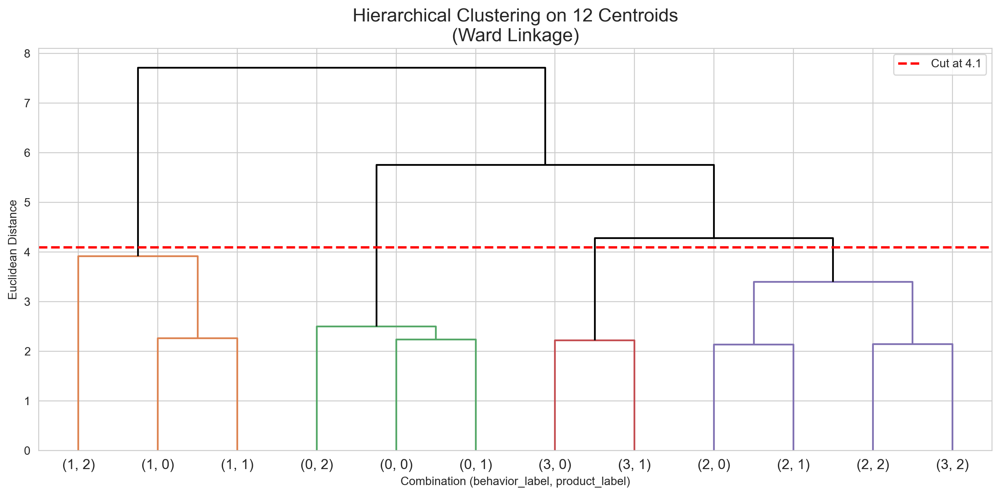

In [179]:
clean_labels = [(int(b), int(v)) for b, v in df_centroids.index]

fig = plt.figure(figsize=(12, 6))

y_threshold = 4.1

dendrogram(
    linkage_matrix,
    truncate_mode="level",
    labels=clean_labels,
    color_threshold=y_threshold,
    above_threshold_color='k'
)

plt.axhline(y=y_threshold, color='r', linestyle='--', linewidth=2, label=f'Cut at {y_threshold}')

plt.title(f'Hierarchical Clustering on 12 Centroids\n(Ward Linkage)', fontsize=16)
plt.xlabel('Combination (behavior_label, product_label)')
plt.ylabel('Euclidean Distance')
plt.legend()
plt.tight_layout()
plt.show()

We will go with 4 clusters:

In [180]:
n_final_clusters = 4

hclust_final = AgglomerativeClustering(
    linkage='ward',
    n_clusters=n_final_clusters
)

hclust_final_labels = hclust_final.fit_predict(df_centroids)

In [ ]:
df_centroids['merged_labels'] = hclust_final_labels
df_centroids

Tenure  avg_monthly_flights  \
cluster_labels_behavior cluster_labels_value                                  
0                       0                     0.509728             0.604732   
                        1                     0.495012             0.653031   
                        2                     0.510104             0.665248   
1                       0                    -1.176759            -1.501669   
                        1                    -1.205916            -1.502076   
                        2                    -1.181657            -1.434091   
2                       0                    -0.802124            -0.513124   
                        1                    -0.766046            -0.448233   
                        2                    -0.784439            -0.453399   
3                       0                    -0.793995            -1.174174   
                        1                    -0.791713            -1.153445   
                        2                    -0.870206            -0.687002   

                                              seasonality_score    trend%  \
cluster_labels_behavior cluster_labels_value                                
0                       0                             -0.232256 -0.132613   
                        1                             -0.252900 -0.139742   
                        2                             -0.260464 -0.146012   
1                       0                              2.836141 -0.025289   
                        1                              2.713362 -0.009372   
                        2                              2.387148 -0.061150   
2                       0                              0.175341  1.772228   
                        1                              0.119294  1.833780   
                        2                              0.163448  1.749552   
3                       0                             -0.365532 -0.087343   
                        1                             -0.273427 -0.090714   
                        2                              0.482652 -0.015703   

                                              TotalFlightsWithCompanions  \
cluster_labels_behavior cluster_labels_value                               
0                       0                                       0.430372   
                        1                                       0.500685   
                        2                                       0.727741   
1                       0                                      -1.306308   
                        1                                      -1.314245   
                        2                                      -1.142339   
2                       0                                      -0.467513   
                        1                                      -0.402155   
                        2                                      -0.202177   
3                       0                                      -1.070182   
                        1                                      -1.031294   
                        2                                      -0.553415   

                                              flights_period2  \
cluster_labels_behavior cluster_labels_value                    
0                       0                            0.469576   
                        1                            0.499475   
                        2                            0.505240   
1                       0                           -1.195011   
                        1                           -1.194428   
                        2                           -1.169171   
2                       0                           -0.575397   
                        1                           -0.475725   
                        2                           -0.526511   
3                       0                           -0.855525   
                 

In [182]:
value_labels = {
    0: 'Low-Value Non-Engagers', 
    1: 'Premium High-Value', 
    2: 'Loyalty Enthusiasts'
}
behavior_labels = {
    0: 'Established Active', 
    1: 'Seasonal Solo', 
    2: 'High-Growth', 
    3: 'At-Risk'
}

combination_data = []
for value in range(3):
    for behavior in range(4):
        count = len(df_merged_clusters[(df_merged_clusters['cluster_labels_value'] == value) & 
                                       (df_merged_clusters['cluster_labels_behavior'] == behavior)])
        if count > 0:
            combination_data.append({
                'value': value,
                'behavior': behavior,
                'count': count
            })

combo_df = pd.DataFrame(combination_data)

cluster_mapping = dict(zip(df_centroids.index, df_centroids['merged_labels']))
combo_df['final_cluster'] = combo_df.apply(
    lambda row: cluster_mapping[(row['behavior'], row['value'])],
    axis=1
)

combo_df = combo_df.sort_values(['final_cluster', 'value', 'behavior']).reset_index(drop=True)

n_final_clusters = df_centroids['merged_labels'].nunique()
final_cluster_sizes = combo_df.groupby('final_cluster')['count'].sum()

combo_nodes = []
for idx, row in combo_df.iterrows():
    combo_label = (f"{value_labels[row['value']]} ×\n"
                   f"{behavior_labels[row['behavior']]}\n"
                   f"({row['count']:,} customers)")
    combo_nodes.append(combo_label)

final_nodes = [f"Final Cluster {i}\n({final_cluster_sizes[i]:,} customers)" for i in range(n_final_clusters)]
all_nodes = combo_nodes + final_nodes

sources = []
targets = []
values = []
colors = []

for idx, row in combo_df.iterrows():
    sources.append(idx)  
    targets.append(len(combo_nodes) + row['final_cluster'])  
    values.append(row['count'])
    
    color_palette = [
        'rgba(231, 76, 60, 0.4)',   
        'rgba(52, 152, 219, 0.4)',  
        'rgba(46, 204, 113, 0.4)',  
        'rgba(241, 196, 15, 0.4)',  
        'rgba(155, 89, 182, 0.4)'  
    ]
    colors.append(color_palette[row['final_cluster']])

combo_node_colors = ['#95a5a6'] * len(combo_nodes) 
final_node_colors = [
    '#e74c3c',
    '#3498db',  
    '#2ecc71',  
    '#f39c12', 
    '#9b59b6'  
]
node_colors = combo_node_colors + final_node_colors[:n_final_clusters]

x_positions = (
    [0.0] * len(combo_nodes) +
    [1.0] * n_final_clusters 
)
y_positions = (
    list(np.linspace(0.05, 0.95, len(combo_nodes))) +  
    list(np.linspace(0.20, 0.80, n_final_clusters))  
)

fig = go.Figure(data=[go.Sankey(
    arrangement='snap',
    node = dict(
        pad = 15,
        thickness = 25,
        line = dict(color = "white", width = 2),
        label = all_nodes,
        color = node_colors,
        x = x_positions,
        y = y_positions
    ),
    link = dict(
        source = sources,
        target = targets,
        value = values,
        color = colors
    )
)])

fig.update_layout(
    title_text=f"Hierarchical Clustering Merge: {len(combo_nodes)} Value×Behavior Combinations -> {n_final_clusters} Final Clusters",
    font_size=11,
    height=700,
    width=1200
)
fig.show()

- Clusters (Low-Value × Seasonal Solo), (Premium × Seasonal Solo), and (Loyalty × Seasonal Solo) were mapped to Final Cluster 0
- Clusters (Loyalty × At-Risk), (Low-Value × High-Growth), (Loyalty × High-Growth) and (Premium × High-Growth) were mapped to Final Cluster 1
- Clusters (Low-Value × Established Active), (Loyalty × Established Active) and (Premium × Established Active) were mapped to Final Cluster 2
- Clusters (Low-Value × At-Risk) and (Premium × At-Risk) were mapped to Final Cluster 3

In [183]:
cluster_mapping = dict(zip(df_centroids.index, df_centroids['merged_labels']))
df_merged_clusters['merged_labels'] = df_merged_clusters.apply(
    lambda row: cluster_mapping[(row['cluster_labels_behavior'], row['cluster_labels_value'])],
    axis=1
)

df_merged_clusters.groupby('merged_labels')[metric_features].mean()

,Tenure,avg_monthly_flights,seasonality_score,trend%,TotalFlightsWithCompanions,flights_period2,flights_period3,Income,Customer Lifetime Value,TotalPointsRedeemed,RedeemRatio
merged_labels,,,,,,,,,,,
0,-1.182968,-1.488866,2.728368,-0.029242,-1.276499,-1.189982,-1.068676,0.039168,0.016405,-0.871429,-0.213718
1,-0.832081,-0.589920,0.327821,0.852225,-0.472360,-0.528094,-0.182012,0.027457,-0.146871,0.041060,0.899444
2,0.507352,0.637210,-0.247074,-0.139192,0.561294,0.488962,0.481167,-0.003678,0.001864,0.371477,0.142827
3,-0.793518,-1.169842,-0.346285,-0.088047,-1.062056,-0.852405,-1.001924,-0.012954,0.041097,-0.827730,-0.697572


This clustering has an $R^2$ of 0.3160, indicating that approximately 31.6% of the total variance in the data is explained by the cluster assignments.

Here we will just unscale the data and do the average per cluster to use in our financial impact modeling:

In [184]:
common_indices = df_merged_clusters.index
df_clean = df.loc[common_indices].copy()
df_clean['merged_labels'] = df_merged_clusters['merged_labels'].values

scaler_features_order = [
    'Income',
    'Customer Lifetime Value',
    'Tenure',
    'TotalFlightsWithCompanions',
    'TotalPointsRedeemed',
    'RedeemRatio',
    'flights_period2',
    'flights_period3',
    'avg_monthly_flights',
    'seasonality_score',
    'trend%'
]

df_clean_unscaled = df_clean.copy()
df_clean_unscaled[scaler_features_order] = scaler.inverse_transform(
    df_clean[scaler_features_order]
)


final_clusters_numeric = df_clean_unscaled.groupby('merged_labels')[scaler_features_order].mean()

customer_counts = df_clean_unscaled.groupby('merged_labels').size().to_frame('customer_count')
isactive_pct = df_clean_unscaled.groupby('merged_labels')['IsActive'].mean().to_frame('is_active_pct')

categorical_cols = [col for col in non_metric_features if col != 'IsActive']
final_clusters_categorical = df_clean_unscaled.groupby('merged_labels')[categorical_cols].agg(
    lambda x: x.mode()[0] if len(x.mode()) > 0 else x.iloc[0]
)

final_clusters = pd.concat([
    customer_counts,
    final_clusters_numeric,
    isactive_pct,
    final_clusters_categorical
], axis=1)

final_clusters.to_csv('data/final_clusters.csv', index=True)
final_clusters


,customer_count,Income,Customer Lifetime Value,Tenure,TotalFlightsWithCompanions,TotalPointsRedeemed,RedeemRatio,flights_period2,flights_period3,avg_monthly_flights,seasonality_score,trend%,is_active_pct,Province or State,Gender,Education,Location Code,Marital Status,LoyaltyStatus,EnrollmentType
merged_labels,,,,,,,,,,,,,,,,,,,,
0,1249,50705.119936,7244.953491,0.584307,5.160128,1028.849472,0.208909,2.104083,10.031225,1.712602,2.603387,58.193627,0.755004,Ontario,female,Bachelor,Suburban,Married,Star,Standard
1,1309,50445.700840,6555.040558,1.298319,23.088617,8687.577464,0.506023,14.963331,30.202445,7.628442,1.113109,306.070390,0.864782,Ontario,female,Bachelor,Rural,Married,Star,Standard
2,10626,49756.025334,7183.511107,4.023904,46.134199,11460.847915,0.304074,34.722850,45.289479,15.704014,0.756210,27.274795,0.978920,Ontario,male,Bachelor,Suburban,Married,Star,Standard
3,3503,49550.551013,7349.284412,1.376791,9.941193,1395.625464,0.079763,8.662575,11.549814,3.812053,0.694619,41.657162,0.618042,Ontario,female,Bachelor,Suburban,Married,Star,Standard


# 4. Profiling

### 4.1 Profiling using Metric Features

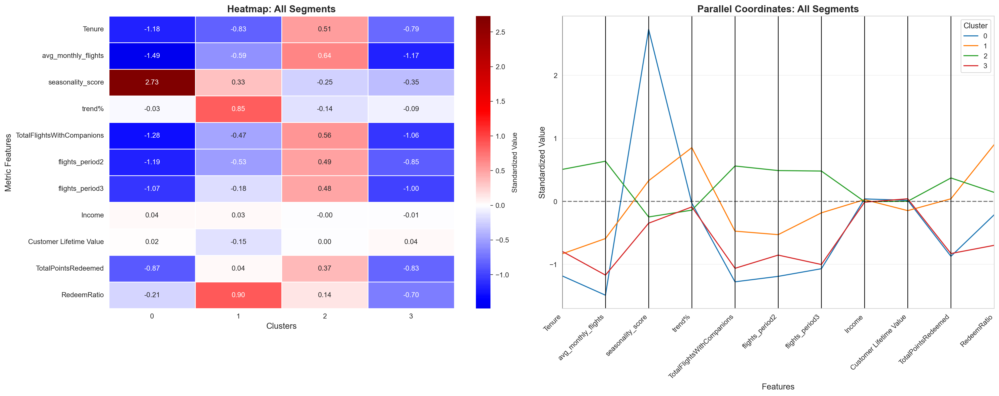

In [185]:
all_segments = sorted(df_merged_clusters['merged_labels'].unique())
df_all_centroids = df_merged_clusters.groupby('merged_labels')[metric_features].mean()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

sns.heatmap(
    df_all_centroids.T,
    ax=ax1,
    annot=True,
    fmt='.2f',
    cmap='seismic',
    center=0,
    linewidths=1,
    linecolor='white',
    cbar_kws={'label': 'Standardized Value'}
)
ax1.set_title('Heatmap: All Segments', fontsize=14, fontweight='bold')
ax1.set_ylabel('Metric Features', fontsize=12)
ax1.set_xlabel('Clusters', fontsize=12)
ax1.grid(False)

plt.sca(ax2)
pd.plotting.parallel_coordinates(
    df_all_centroids.reset_index(),
    'merged_labels',
    color=sns.color_palette('tab10', n_colors=len(all_segments)),
    ax=ax2
)
ax2.axhline(y=0, color='black', linestyle='--', alpha=0.5, linewidth=1.5)
ax2.set_title('Parallel Coordinates: All Segments', fontsize=14, fontweight='bold')
ax2.set_ylabel('Standardized Value', fontsize=12)
ax2.set_xlabel('Features', fontsize=12)
ax2.tick_params(axis='x', rotation=45)
plt.setp(ax2.xaxis.get_majorticklabels(), rotation=45, ha='right')
ax2.legend(title='Cluster', loc='best', title_fontsize=11)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [186]:
cluster_pct = (
    df_merged_clusters["merged_labels"]
    .value_counts(normalize=True)
    .sort_index()
    .mul(100)
    .round(2)
)

cluster_dist = pd.DataFrame({
    "count": df_merged_clusters["merged_labels"].value_counts().sort_index(),
    "pct_%": cluster_pct
})

cluster_dist

,count,pct_%
merged_labels,,
0,1249,7.48
1,1309,7.84
2,10626,63.68
3,3503,20.99


**Cluster 0: New, Seasonal Solo Travelers (1,249 customers)**
* **Behavioral:**
   * **Tenure**: -1.18 (very low) -> Newer customers
   * **avg_monthly_flights**: -1.49 (very low) -> Minimal flight frequency
   * **seasonality_score**: **+2.73 (extremely high)** -> Extreme seasonal concentration
   * **trend%**: -0.03 (stagnant) -> No growth
   * **TotalFlightsWithCompanions**: -1.28 (very low) -> Solo travelers
   * **flights_period2/3**: -1.19/-1.07 (very low) -> Consistently low activity
* **Value:**
   * **Income**: +0.04 (average)
   * **CLV**: +0.02 (average)
   * **TotalPointsRedeemed**: -0.87 (very low)
   * **RedeemRatio**: -0.21 (low)
* **Profile:** Vacation-only travelers with extreme periodicity. Low engagement with loyalty program despite earning points. Budget leisure segment with minimal revenue potential.

**Cluster 1: Emerging High-Growth Segment (1309 customers)**
* **Behavioral:**
   * **Tenure**: -0.83 (low) -> Recent members
   * **avg_monthly_flights**: -0.59 (below average) -> Moderate activity
   * **seasonality_score**: +0.33 (low) -> Minimal seasonal patterns
   * **trend%**: **+0.85 (high)** -> Strong growth trajectory
   * **TotalFlightsWithCompanions**: -0.47 (below average) -> Primarily solo
   * **flights_period2/3**: -0.53/-0.18 (mixed) -> Accelerating in recent periods
* **Value:**
   * **Income**: +0.03 (average)
   * **CLV**: -0.15 (below average) -> Not yet monetized
   * **TotalPointsRedeemed**: +0.04 (average)
   * **RedeemRatio**: **+0.90 (very high)** -> Heavy program users
* **Profile:** High-potential emerging customers with rapid engagement growth. Active loyalty program participants leveraging points strategically. Highest future ROI potential despite current moderate CLV.

**Cluster 2: Established Active Core (10,626 customers)**
* **Behavioral:**
   * **Tenure**: +0.51 (moderate-high) -> Established members
   * **avg_monthly_flights**: **+0.64 (high)** -> Regular flight activity
   * **seasonality_score**: -0.25 (low) -> Year-round consistency
   * **trend%**: -0.14 (stable) -> Mature, predictable engagement
   * **TotalFlightsWithCompanions**: **+0.56 (high)** -> Frequent group/family travel
   * **flights_period2/3**: +0.49/+0.48 (moderate-high) -> Sustained activity
* **Value:**
   * **Income**: -0.00 (average)
   * **CLV**: +0.00 (average)
   * **TotalPointsRedeemed**: **+0.37 (high)**
   * **RedeemRatio**: +0.14 (above average)
* **Profile:** Largest segment (64% of base). Core customer base with consistent year-round travel, frequent companion bookings, and active loyalty program engagement. Stable revenue contributors representing the business backbone.

**Cluster 3: At-Risk Low-Engagement (3,503 customers)**
* **Behavioral:**
   * **Tenure**: -0.79 (low) -> Newer members
   * **avg_monthly_flights**: -1.17 (very low) -> Minimal activity
   * **seasonality_score**: -0.35 (low) -> No seasonal patterns
   * **trend%**: -0.09 (negative) -> Declining engagement
   * **TotalFlightsWithCompanions**: -1.06 (very low) -> Solo, infrequent
   * **flights_period2/3**: -0.85/-1.00 (very low) -> Consistently minimal
* **Value:**
   * **Income**: -0.01 (average)
   * **CLV**: **+0.04 (above average)** -> Surprisingly positive despite low activity
   * **TotalPointsRedeemed**: -0.83 (very low)
   * **RedeemRatio**: **-0.70 (very low)** -> Minimal program engagement
* **Profile:** At-risk segment with minimal engagement from the start. Despite low activity, maintains slightly positive CLV. Critical churn intervention priority to prevent high-value customer loss.

**Key Insights:**

1. **Cluster 2 dominates (63.7%)**: Established Active Core represents business stability
2. **Seasonality defines Cluster 0**: Extreme +2.73 creates distinct vacation-only niche
3. **Growth trajectory separates Cluster 1**: +0.85 trend identifies high-potential emerging customers
4. **Redemption paradox**: Cluster 1 (emerging) has highest RedeemRatio (+0.90) despite lowest CLV, while Cluster 2 (core) balances moderate redemption with stable CLV
5. **At-Risk heterogeneity**: Cluster 3 combines low-value dormant accounts with high-value premium churners, requiring differentiated retention strategies

---

**Strategic Priority Framework**

**Tier 1: Protect & Grow (High Value + High Potential)**

**Cluster 2 - Established Active Core (10,626 customers, 63.7%)**
- **Priority**: Retention & Loyalty Deepening
- **Actions**:
  - Maintain fresh redemption options and exclusive family/group travel benefits
  - Introduce companion bonus programs and multi-traveler discounts
  - Launch VIP recognition for tenure milestones
- **KPIs**: Retention rate, companion booking frequency, redemption satisfaction

**Cluster 1 - Emerging High-Growth (1309 customers, 7.8%)**
- **Priority**: Acceleration & Lock-In
- **Actions**:
  - Fast-track status upgrades and early VIP benefits
  - Bonus point multipliers for next 6 months
  - Personalized growth milestone rewards
  - Referral incentives to leverage program enthusiasm
- **KPIs**: Month-over-month flight growth, CLV progression, program engagement rate

**Tier 2: Activate & Convert**

**Cluster 0 - New, Seasonal Solo Travelers (1,249 customers, 7.5%)**
- **Priority**: Off-Peak Activation
- **Actions**:
  - Seasonal redemption bonuses (double points during peak periods)
  - Off-peak flash sales and exclusive vacation packages
  - Bundled solo traveler offers (hotel + flight)
- **KPIs**: Off-peak conversion rate, points redemption frequency, booking diversification

**Tier 3: Rescue & Recover (Critical Intervention)**

**Cluster 3 - At-Risk Low-Engagement Premium (3,503 customers, 21%)**
- **Priority**: Churn Prevention & Segmented Reactivation
- **Actions**:
  - **Premium subset (732)**: Immediate personal outreach, service recovery, exclusive win-back offers
  - **Low-value subset (2,771)**: Automated reactivation campaigns, point expiration warnings, limited-time incentives
  - Identify root causes through surveys (service issues, competitor switching, life changes)
- **KPIs**: Reactivation rate by value tier, churn rate reduction, win-back ROI

**Resource Allocation Recommendation:**

- **60% resources -> Cluster 2**: Protect revenue backbone, maximize lifetime value
- **20% resources -> Cluster 1**: Invest in high-ROI growth acceleration
- **15% resources -> Cluster 3**: Focus on Premium subset rescue (732 customers)
- **5% resources -> Cluster 0**: Maintain seasonal touchpoints, minimal investment

**Cross-Cluster Opportunities:**

1. **Cluster 1 -> Cluster 2 pipeline**: Track migration success rate, optimize onboarding
2. **Cluster 0 frequency expansion**: Test off-peak conversion campaigns
3. **Cluster 3 segmentation**: Separate dormant accounts from savable premium customers

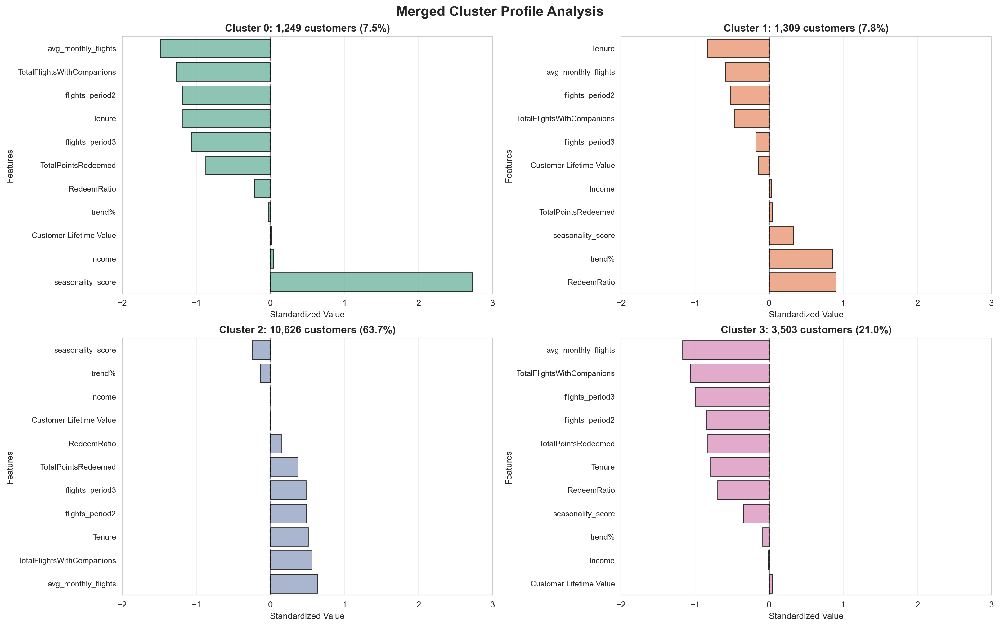

In [188]:
data = df_merged_clusters[metric_features + ["merged_labels"]]
clusters = sorted(data["merged_labels"].unique())

cluster_sizes = data["merged_labels"].value_counts().sort_index()
total_size = len(data)
cluster_percentages = (cluster_sizes / total_size) * 100

hc_profile = data.groupby("merged_labels").mean()

n_clusters = len(clusters)
n_cols = 2
n_rows = (n_clusters + n_cols - 1) // n_cols

fig, axes = plt.subplots(
    n_rows, n_cols,
    figsize=(16, 5 * n_rows),
    constrained_layout=True
)
axes = axes.flatten() if n_clusters > 1 else [axes]

palette = sns.color_palette("Set2", n_clusters)

for idx, cluster in enumerate(clusters):
    ax = axes[idx]

    mean_profile = (
        hc_profile.loc[cluster]
        .sort_values()
        .reset_index()
        .rename(columns={"index": "Feature", cluster: "Value"})
    )

    sns.barplot(
        data=mean_profile,
        x=mean_profile.columns[1],
        y="Feature",
        color=palette[idx],
        edgecolor="black",
        alpha=0.8,
        ax=ax
    )

    ax.set_title(
        f"Cluster {cluster}: {cluster_sizes[cluster]:,} customers "
        f"({cluster_percentages[cluster]:.1f}%)",
        fontsize=12,
        fontweight="bold"
    )
    ax.set_xlabel("Standardized Value", fontsize=10)
    ax.set_ylabel("Features", fontsize=10)
    ax.tick_params(axis="y", labelsize=9)

    ax.axvline(0, color="black", linestyle="--", alpha=0.5, linewidth=1.5)
    ax.grid(True, axis="x", alpha=0.3)
    ax.set_xlim(-2, 3)

for ax in axes[len(clusters):]:
    ax.set_visible(False)

fig.suptitle("Merged Cluster Profile Analysis", fontsize=16, fontweight="bold")
plt.show()

With features sorted by importance (value) within each cluster, it becomes much easier to visually identify:

1. **Defining features of each cluster** - longest bars (extremes) appear at top/bottom
2. **Distinct patterns between clusters** - direct visual comparison of dominant characteristics
3. **Hierarchy of importance** - descending/ascending order shows priorities within each profile

Much more intuitive than alphabetical or fixed feature ordering across all subplots.

### 4.2 Profiling using Categorical Features

Now, we will use the categorical variables that were not used in the clustering to profile our final clusters. We have the following:

**Demographic:**
- `Gender` - Gender distribution
- `Education` - Education level composition
- `Marital Status` - Marital status breakdown
- `Province or State` - Geographic distribution
- `Location Code` - Location type analysis

**Program-Related:**
- `LoyaltyStatus` - Loyalty tier distribution
- `EnrollmentType` - How customers enrolled
- `IsActive` - Active vs. inactive proportion


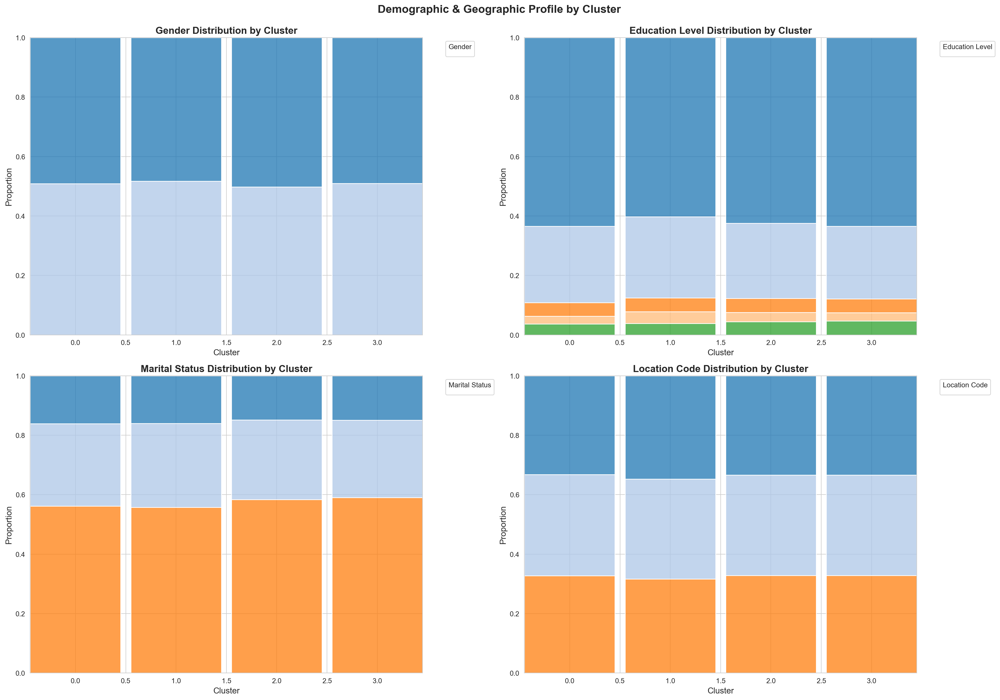

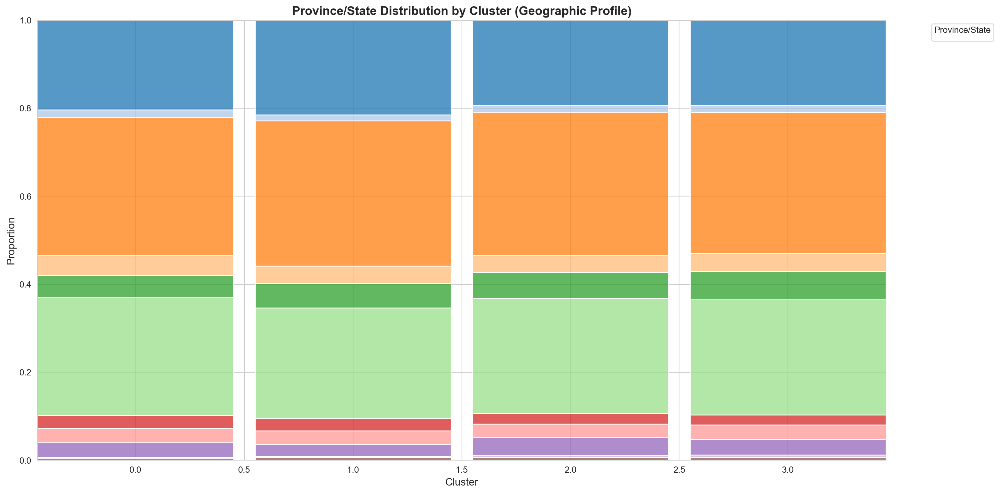

In [189]:
df["merged_labels"] = df_merged_clusters["merged_labels"].values

fig, axes = plt.subplots(2, 2, figsize=(20, 14))

plots = [
    ("Gender", axes[0, 0], "Gender"),
    ("Education", axes[0, 1], "Education Level"),
    ("Marital Status", axes[1, 0], "Marital Status"),
    ("Location Code", axes[1, 1], "Location Code"),
]

for col, ax, leg_title in plots:
    sns.histplot(
        data=df.dropna(subset=["merged_labels", col]),
        x="merged_labels",
        hue=col,
        multiple="fill",
        discrete=True,
        shrink=0.9,
        palette="tab20",
        ax=ax,
        legend=True
    )
    ax.set_title(f"{leg_title} Distribution by Cluster", fontsize=14, fontweight="bold")
    ax.set_xlabel("Cluster", fontsize=12)
    ax.set_ylabel("Proportion", fontsize=12)
    ax.tick_params(axis="x", rotation=0)

    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles, labels=labels, title=leg_title, bbox_to_anchor=(1.05, 1), loc="upper left")

fig.suptitle("Demographic & Geographic Profile by Cluster", fontsize=16, fontweight="bold", y=0.995)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(figsize=(16, 8))

sns.histplot(
    data=df.dropna(subset=["merged_labels", "Province or State"]),
    x="merged_labels",
    hue="Province or State",
    multiple="fill",
    discrete=True,
    shrink=0.9,
    palette="tab20",
    ax=ax,
    legend=True
)

ax.set_title("Province/State Distribution by Cluster (Geographic Profile)", fontsize=14, fontweight="bold")
ax.set_xlabel("Cluster", fontsize=12)
ax.set_ylabel("Proportion", fontsize=12)
ax.tick_params(axis="x", rotation=0)

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels, title="Province/State", bbox_to_anchor=(1.05, 1), loc="upper left", ncol=3, fontsize=8)

plt.tight_layout()
plt.show()

All four clusters show **remarkably similar demographic patterns**.

Demographics do **not** distinguish these clusters. Segmentation is driven by **behavioral patterns** (flight frequency, seasonality, companion travel) and **value metrics** (CLV, redemption), not by who customers are but how they behave.

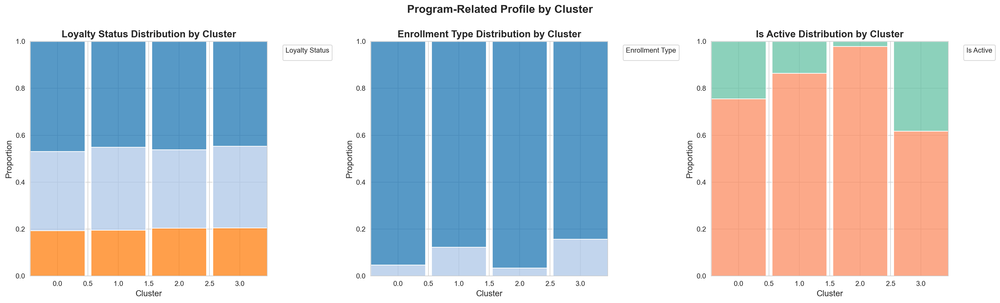

In [190]:
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

plots = [
    ("LoyaltyStatus", axes[0], "Loyalty Status"),
    ("EnrollmentType", axes[1], "Enrollment Type"),
    ("IsActive", axes[2], "Is Active"),
]

for col, ax, leg_title in plots:
    sns.histplot(
        data=df.dropna(subset=["merged_labels", col]),
        x="merged_labels",
        hue=col,
        multiple="fill",
        discrete=True,
        shrink=0.9,
        palette="tab20" if col != "IsActive" else "Set2",
        ax=ax,
        legend=True
    )

    ax.set_title(f"{leg_title} Distribution by Cluster", fontsize=14, fontweight="bold")
    ax.set_xlabel("Cluster", fontsize=12)
    ax.set_ylabel("Proportion", fontsize=12)
    ax.tick_params(axis="x", rotation=0)

    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles, labels,
        title=leg_title,
        bbox_to_anchor=(1.05, 1),
        loc="upper left"
    )

fig.suptitle(
    "Program-Related Profile by Cluster",
    fontsize=16,
    fontweight="bold",
    y=1.00
)

plt.tight_layout()
plt.show()

**Program-Related Profiling: Significant Differentiation**

Unlike demographics, program-related characteristics show **meaningful variation across clusters**, validating behavioral segmentation:

**Loyalty Status:** Not much variation across clusters.

**Enrollment Type:**
- **Cluster 0 & 2 (Seasonal & Established)**: Predominantly Standard enrollment (~95-98%) - organic long-term members
- **Cluster 1 & 3 (High-Growth & At-Risk)**: Higher 2021 Promotion enrollment (~12-15%)
  - **Cluster 1**: Recent acquisition campaigns successfully capturing high-potential customers
  - **Cluster 3**: Same campaigns also attracting customers who failed to activate - acquisition quality issue

**Active Status (Critical Validation):**
- **Cluster 0 (Seasonal Solo)**: ~75% active - reflects seasonal engagement patterns (active during travel periods, dormant off-season)
- **Cluster 1 (Emerging High-Growth)**: ~88% active - validates rapid engagement growth (+0.85 trend%)
- **Cluster 2 (Established Active Core)**: **~97% active** - directly confirms behavioral classification as "Active" segment
- **Cluster 3 (At-Risk)**: **~60% active** - validates "Low-Engagement" classification with 40% inactive/churning

**Key Insights:**

1. **Active Status perfectly validates behavioral segmentation**: Cluster 2's 97% active vs. Cluster 3's 60% active directly confirms clustering accuracy
2. **Enrollment patterns reveal acquisition challenges**: 2021 Promotion captured both high-potential (Cluster 1) and high-risk (Cluster 3) customers - requires campaign refinement
3. **Loyalty tier progression blocked**: Despite high activity, Cluster 2 (Established Active) shows only moderate Star tier representation (~46%) - suggests tier advancement barriers or redemption-focused behavior preventing accumulation
4. **Program metrics > Demographics**: Unlike uniform demographic patterns, program characteristics successfully differentiate segments and validate behavioral archetypes

**Strategic Implications:**

- **Cluster 3 reactivation urgency**: 40% inactive rate requires immediate intervention to prevent full churn
- **2021 Promotion review**: High representation in both best (Cluster 1) and worst (Cluster 3) segments suggests poor targeting - refine acquisition criteria
- **Tier progression analysis**: Investigate why Cluster 2 (highest activity) doesn't dominate Aurora tier - potential program design issue

### 4.3 Profiling using Feature Importance

#### 4.3.1 Feature Importances

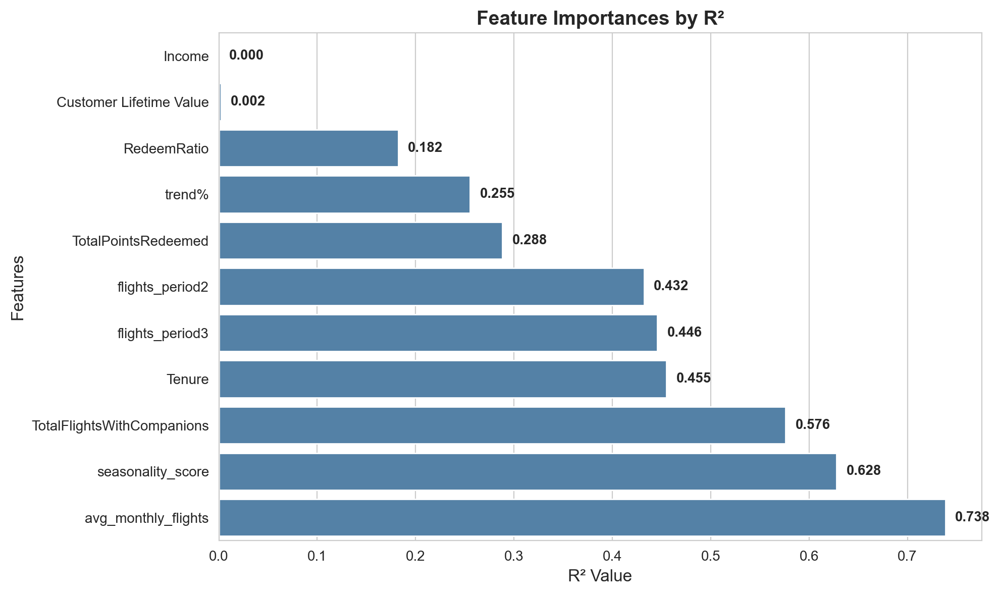

In [ ]:
r2_feats = (
    r2_variables(df[metric_features + ["merged_labels"]], "merged_labels")
    .drop("merged_labels")
    .sort_values()
    .reset_index()
)
r2_feats.columns = ["Feature", "R2"]

plt.figure(figsize=(10, 6))

ax = sns.barplot(
    data=r2_feats,
    x="R2",
    y="Feature",
    color="steelblue"
)

for i, v in enumerate(r2_feats["R2"]):
    ax.text(
        v + 0.01,
        i,
        f"{v:.3f}",
        va="center",
        fontsize=10,
        fontweight="bold"
    )

plt.title("Feature Importances by R²", fontsize=14, fontweight="bold")
plt.xlabel("R² Value", fontsize=12)
plt.ylabel("Features", fontsize=12)
plt.tight_layout()
plt.show()

**Top Tier: Primary Drivers (R² > 0.55)**

1. **avg_monthly_flights (0.74)**: Strongest discriminator - flight frequency is the backbone
2. **seasonality_score (0.63)**: Separates vacation-only (Cluster 0) from year-round travelers (Cluster 2)
3. **TotalFlightsWithCompanions (0.58)**: Distinguishes group/family (Cluster 2) from solo travelers

**Mid Tier: Supporting Dimensions (R² 0.40-0.55)**

4. **Tenure (0.45)**: Separates established (Cluster 2) from newer members
5. **flights_period3 (0.45)** and **flights_period2 (0.43)**: Historical activity validates patterns

**Lower Tier: Moderate Contributors (R² 0.18-0.30)**

6. **TotalPointsRedeemed (0.29)**: Loyalty engagement
7. **trend% (0.26)**: Identifies high-growth Cluster 1
8. **RedeemRatio (0.18)**: Strategic program users

**Negligible: Non-Discriminating (R² < 0.01)**

9. **CLV (0.00)**: No clustering power
10. **Income (0.00)**: Demographics irrelevant

**Key Insights:**

1. **Behavioral features dominate**: Top 6 features (R² > 0.40) are all behavioral
2. **Value orthogonal to behavior**: CLV and Income contribute nothing (R² < 0.01), validating dual-segmentation approach
3. **Three-dimensional structure**: Frequency (0.74) + Seasonality (0.63) + Companions (0.58) form primary clustering axes
4. **Program engagement secondary**: Redemption metrics moderate contributors (0.18-0.29)

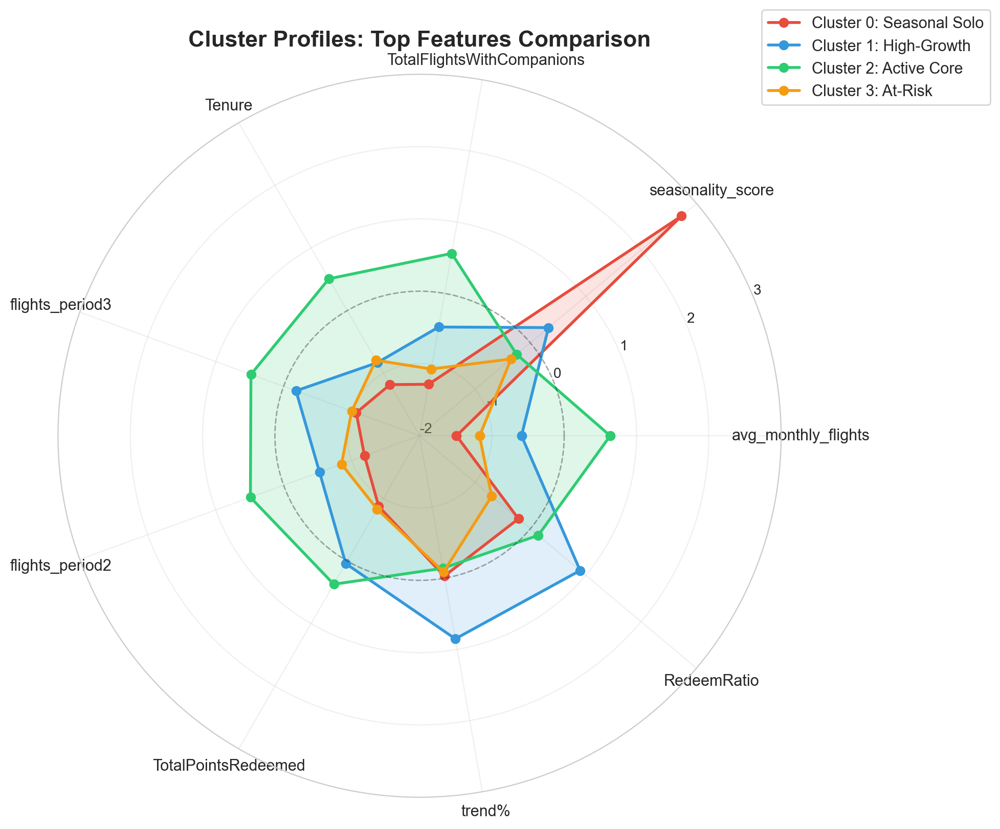

In [193]:
top_features = [
    'avg_monthly_flights',
    'seasonality_score', 
    'TotalFlightsWithCompanions',
    'Tenure',
    'flights_period3',
    'flights_period2',
    'TotalPointsRedeemed',
    'trend%',
    "RedeemRatio"
]

radar_data = df_all_centroids[top_features]

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))

num_vars = len(top_features)
angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
angles += angles[:1]  # Complete the circle

colors = ['#e74c3c', '#3498db', '#2ecc71', '#f39c12']
cluster_names = [
    'Cluster 0: Seasonal Solo',
    'Cluster 1: High-Growth', 
    'Cluster 2: Active Core',
    'Cluster 3: At-Risk'
]

for idx, cluster in enumerate(sorted(radar_data.index)):
    values = radar_data.loc[cluster].tolist()
    values += values[:1]  # Complete the circle
    
    ax.plot(angles, values, 'o-', linewidth=2, 
            label=cluster_names[idx], color=colors[idx])
    ax.fill(angles, values, alpha=0.15, color=colors[idx])

ax.set_xticks(angles[:-1])
ax.set_xticklabels(top_features, size=11)
ax.set_ylim(-2, 3)  # Adjust based on your standardized range
ax.set_yticks([-2, -1, 0, 1, 2, 3])
ax.set_yticklabels(['-2', '-1', '0', '1', '2', '3'], size=10)
ax.axhline(y=0, color='black', linestyle='--', alpha=0.3, linewidth=1)

ax.set_title('Cluster Profiles: Top Features Comparison', 
             size=16, fontweight='bold', pad=20)
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=11)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

The radar plot effectively visualizes the four cluster profiles in a single compact view, making behavioral differences immediately apparent:

- **Cluster 0's seasonality spike** instantly stands out as the defining characteristic
- **Cluster 2's expansive profile** clearly shows dominance across most dimensions
- **Clusters 1 and 3** are easily distinguishable despite both having lower overall values
- **Overlapping shapes** are minimal, confirming good cluster separation

**Key Advantage:**

The radar format condenses 9 features × 4 clusters into one intuitive visualization, enabling quick pattern recognition without parsing numbers. Particularly effective for executive presentations where visual impact matters.

#### 4.3.2 Decision Tree Classification & Outlier Assignment

In [194]:
X = df_merged_clusters[metric_features]
y = df_merged_clusters['merged_labels']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)

train_score = dt.score(X_train, y_train)
test_score = dt.score(X_test, y_test)

print(f"Decision Tree Classifier Performance:")
print(f"  Training accuracy: {train_score*100:.2f}%")
print(f"  Test accuracy: {test_score*100:.2f}%")

Decision Tree Classifier Performance:
  Training accuracy: 90.44%
  Test accuracy: 90.20%


**90.20% test accuracy** with minimal overfitting (0.24% gap). High accuracy validates that merged clusters are well-separated and represent distinct customer segments, enabling reliable classification of new customers for targeted interventions.

In [195]:
feature_importance = pd.DataFrame({
    'feature': metric_features,
    'importance': dt.feature_importances_
}).sort_values('importance', ascending=False)

print(f"\nFeature Importance (Gini):")
display(feature_importance)


Feature Importance (Gini):


,feature,importance
1,avg_monthly_flights,0.665388
2,seasonality_score,0.199846
10,RedeemRatio,0.088297
0,Tenure,0.026685
5,flights_period2,0.019784
3,trend%,0.000000
4,TotalFlightsWithCompanions,0.000000
6,flights_period3,0.000000
7,Income,0.000000
8,Customer Lifetime Value,0.000000


Decision Tree relies heavily on **3 features** for classification: avg_monthly_flights (66.5%), seasonality_score (20.0%), and RedeemRatio (8.8%). These capture 95% of the tree's splitting decisions. Seven features contribute nothing (0.0%), including Income, CLV, and trend%, confirming behavioral frequency and seasonality are sufficient to distinguish clusters.

In [196]:
outlier_predictions = dt.predict(df_outliers_multivariate[metric_features])
outlier_probabilities = dt.predict_proba(df_outliers_multivariate[metric_features])

df_outliers_multivariate['predicted_cluster'] = outlier_predictions
df_outliers_multivariate['prediction_confidence'] = outlier_probabilities.max(axis=1)

print(f"\nOutlier Classification Results:")
print(f"  Total outliers: {len(df_outliers_multivariate)}")
print(f"\nPredicted cluster distribution:")
print(df_outliers_multivariate['predicted_cluster'].value_counts().sort_index())
print(f"\nAverage prediction confidence: {df_outliers_multivariate['prediction_confidence'].mean():.2%}")

print(f"\nSample of classified outliers:")
display(df_outliers_multivariate[['predicted_cluster', 'prediction_confidence']].head(10))


Outlier Classification Results:
  Total outliers: 50

Predicted cluster distribution:
predicted_cluster
1    14
2     2
3    34
Name: count, dtype: int64

Average prediction confidence: 81.43%

Sample of classified outliers:


,predicted_cluster,prediction_confidence
Loyalty#,,
458199,3,0.836918
465095,1,0.808349
579283,1,0.808349
830818,1,0.808349
611029,1,0.808349
952532,1,0.808349
347515,3,0.836918
308144,3,0.836918
443198,3,0.836918


The Decision Tree classified **50 multivariate outliers** with 81.43% average confidence. Distribution: 34 assigned to Cluster 3 (At-Risk), 14 to Cluster 1 (High-Growth), and only 2 to Cluster 2 (Active Core). The dominance of At-Risk assignments (68%) suggests most outliers exhibit declining or minimal engagement patterns despite their unusual feature combinations.

# 5. Merged Clusters Visualization

## 5.1. Principal Component Analysis (PCA)

**Principal Component Analysis (PCA): Dimensionality Reduction for Visualization**

To visualize the merged clusters in a comprehensible 2D space, Principal Component Analysis (PCA) is applied to reduce the 11-dimensional feature space. PCA transforms the original features into uncorrelated principal components ranked by variance explained, enabling cluster visualization while preserving as much information as possible.

The following analysis evaluates the trade-off between dimensionality reduction (number of components) and information retention (variance explained) to determine the optimal number of components for visualization purposes.

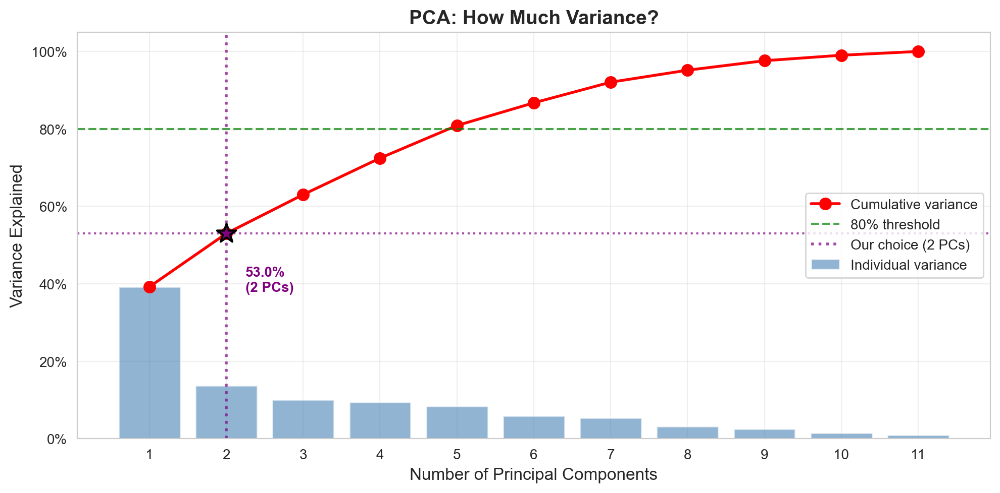


Variance Explained by Each Component:
  PC1:  39.2% | Cumulative:  39.2%
  PC2:  13.8% | Cumulative:  53.0%
  PC3:  10.0% | Cumulative:  63.0%
  PC4:   9.4% | Cumulative:  72.5%
  PC5:   8.4% | Cumulative:  80.9%
  PC6:   5.9% | Cumulative:  86.7%
  PC7:   5.3% | Cumulative:  92.1%
  PC8:   3.1% | Cumulative:  95.2%
  PC9:   2.4% | Cumulative:  97.6%
  PC10:   1.4% | Cumulative:  99.0%
  PC11:   1.0% | Cumulative: 100.0%

2 components capture 53.0% of variance
Trade-off: Simplicity (2D visualization) vs. Information loss (47.0%)


In [197]:
pca_full = PCA(n_components=len(metric_features), random_state=42)
pca_full.fit(df[metric_features])

cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)

fig, ax = plt.subplots(figsize=(10, 5))

ax.bar(range(1, len(metric_features) + 1), 
       pca_full.explained_variance_ratio_,
       alpha=0.6, color='steelblue', label='Individual variance')

ax.plot(range(1, len(metric_features) + 1), 
        cumulative_variance, 
        marker='o', color='red', linewidth=2, markersize=8,
        label='Cumulative variance')

ax.axhline(y=0.80, color='green', linestyle='--', linewidth=1.5, alpha=0.7, label='80% threshold')

ax.axhline(y=cumulative_variance[1], color='purple', linestyle=':', linewidth=1.5, alpha=0.7, )
ax.axvline(x=2, color='purple', linestyle=':', linewidth=2, alpha=0.7, label='Our choice (2 PCs)')
ax.scatter(2, cumulative_variance[1], s=200, c='purple', marker='*', zorder=10, 
           edgecolors='black', linewidths=1.5)

ax.text(2.25, cumulative_variance[1] - 0.15, 
        f'{cumulative_variance[1]:.1%}\n(2 PCs)', 
        ha='left', fontsize=10, weight='bold', color='purple')

ax.set_xlabel('Number of Principal Components', fontsize=12)
ax.set_ylabel('Variance Explained', fontsize=12)
ax.set_title('PCA: How Much Variance?', fontsize=14, weight='bold')
ax.set_xticks(range(1, len(metric_features) + 1))
ax.set_ylim(0, 1.05)
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y:.0%}'))
ax.grid(True, alpha=0.3)
ax.legend(loc='center right', fontsize=10)

plt.tight_layout()
plt.show()

print(f"\n{'='*60}")
print("Variance Explained by Each Component:")
print(f"{'='*60}")
for i, (var, cum_var) in enumerate(zip(pca_full.explained_variance_ratio_, cumulative_variance)):
    print(f"  PC{i+1}: {var:6.1%} | Cumulative: {cum_var:6.1%}")
print(f"{'='*60}")
print(f"\n2 components capture {cumulative_variance[1]:.1%} of variance")
print(f"Trade-off: Simplicity (2D visualization) vs. Information loss ({1-cumulative_variance[1]:.1%})")

**PCA Component Selection: n_components=2**

**2 components capture 53.0% variance** - acceptable for visualization despite 47.0% information loss. PCA is a visualization tool only; marketing strategies derive from cluster profiling (behavioral + value features), not principal components. 2D simplicity enables stakeholder communication.

In [198]:
pca = PCA(random_state=42, n_components=2)
pca_result = pca.fit_transform(df[metric_features])

df['PCA1'] = pca_result[:, 0]
df['PCA2'] = pca_result[:, 1]

print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
print(f"Total variance explained: {sum(pca.explained_variance_ratio_):.2%}")

Explained variance ratio: [0.39231613 0.13763661]
Total variance explained: 53.00%


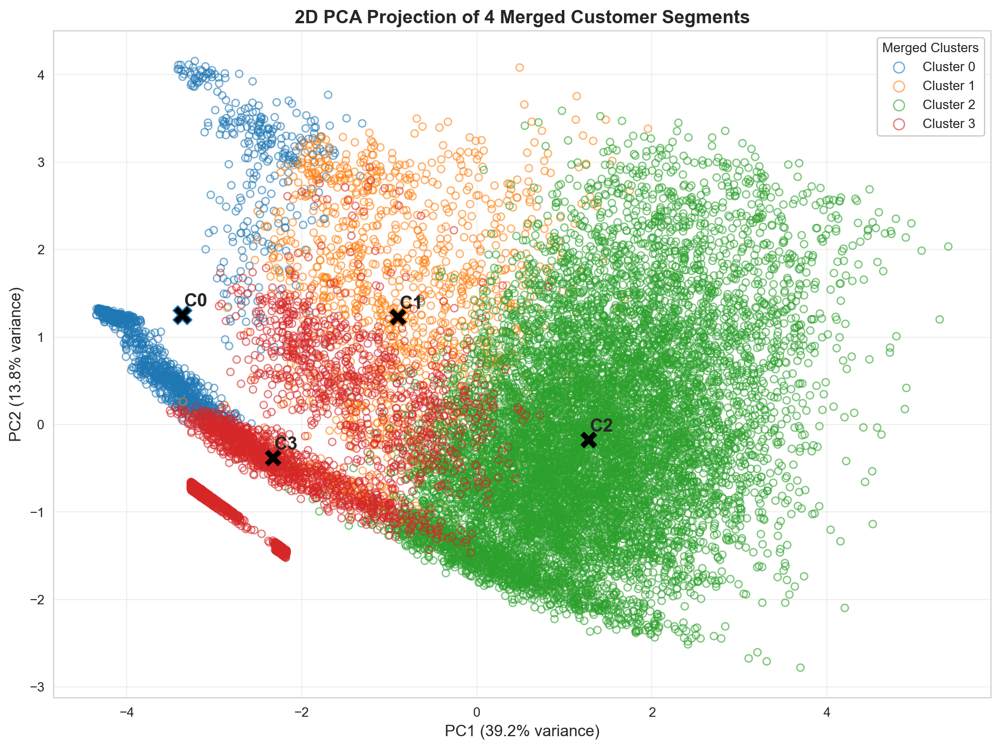

In [199]:
df_pca = pd.DataFrame(pca_result, columns=['pca_1', 'pca_2'])
df_pca['merged_labels'] = df['merged_labels'].values

var_explained = pca.explained_variance_ratio_

fig, ax = plt.subplots(figsize=(12, 8))
colors = cm.tab10(np.linspace(0, 1, 10))

for label in sorted(df_pca['merged_labels'].unique()):
    cluster_data = df_pca[df_pca['merged_labels'] == label]
    ax.scatter(
        cluster_data['pca_1'],
        cluster_data['pca_2'],
        c='none',
        edgecolors=[colors[label]],
        alpha=0.6,
        s=30,
        label=f'Cluster {label}'
    )

for label in sorted(df_pca['merged_labels'].unique()):
    cluster_data = df_pca[df_pca['merged_labels'] == label]
    centroid_x = cluster_data['pca_1'].mean()
    centroid_y = cluster_data['pca_2'].mean()
    ax.scatter(centroid_x, centroid_y, c='black', marker='X', s=200, 
               edgecolors=colors[label], linewidths=1, zorder=10)
    ax.annotate(f'C{label}', (centroid_x+0.15, centroid_y+0.15), 
                fontsize=14, weight='bold', ha='center', va='center', zorder=20)

ax.legend(loc='best', framealpha=1, title='Merged Clusters', fontsize=10, markerscale=1.5)
ax.set_xlabel(f'PC1 ({var_explained[0]:.1%} variance)', fontsize=12)
ax.set_ylabel(f'PC2 ({var_explained[1]:.1%} variance)', fontsize=12)
ax.set_title(f'2D PCA Projection of {df_pca["merged_labels"].nunique()} Merged Customer Segments', 
             fontsize=14, weight='bold')
ax.grid(True, alpha=0.3)
ax.set_aspect('equal')
plt.tight_layout()
plt.show()

**2D PCA Projection Analysis:**

**Segments Better Separated by Each Component:**

**PC1 (39.2% variance - horizontal):**
- Best separates Cluster 0 (Blue, left) from Cluster 2 (Green, right)

**PC2 (13.8% variance - vertical):**
- Best separates Cluster 3 (Red, bottom) from Cluster 0 (Blue, top)

**Significant Overlap:**

- Cluster 1 (Orange) overlaps with Clusters 0 and 2
- Clusters 0 and 3 partially overlap on PC1, separated by PC2
- Cluster 2 (Green) shows internal spread

**Does Overlap Mean Poor Segmentation?**

**No:**

1. **2D limitation**: 47% information loss - clusters well-separated in 11D space
2. **Centroids distinct**: Black stars clearly separated despite individual overlap
3. **Validation**: 90.20% classification accuracy confirms distinguishable clusters
4. **Natural transitions**: Overlap represents behavioral continuity between segments

**Conclusion:** Overlap reflects compression artifacts, not segmentation failure. Clusters remain distinct and actionable.

In [200]:
loadings = pd.DataFrame(
    pca.components_.T,
    columns=['PC1', 'PC2'],
    index=metric_features
)

print("PCA Component Loadings (Feature Contributions):\n")
print(loadings.round(3))

PCA Component Loadings (Feature Contributions):

                              PC1    PC2
Tenure                      0.325 -0.232
avg_monthly_flights         0.461 -0.157
seasonality_score          -0.198  0.359
trend%                     -0.042  0.052
TotalFlightsWithCompanions  0.435 -0.029
flights_period2             0.368 -0.151
flights_period3             0.372 -0.125
Income                     -0.002  0.002
Customer Lifetime Value    -0.001 -0.026
TotalPointsRedeemed         0.361  0.496
RedeemRatio                 0.220  0.710


In [201]:
df['pca_1'] = pca_result[:, 0]
df['pca_2'] = pca_result[:, 1]

pc_corr = df[metric_features + ['pca_1', 'pca_2']].corr().round(3)
pc_corr = pc_corr.loc[metric_features, ['pca_1', 'pca_2']]

pc_corr

,pca_1,pca_2
Tenure,0.652,-0.276
avg_monthly_flights,0.926,-0.186
seasonality_score,-0.396,0.426
trend%,-0.162,0.120
TotalFlightsWithCompanions,0.872,-0.034
flights_period2,0.738,-0.180
flights_period3,0.746,-0.148
Income,-0.005,0.002
Customer Lifetime Value,-0.003,-0.031
TotalPointsRedeemed,0.724,0.589


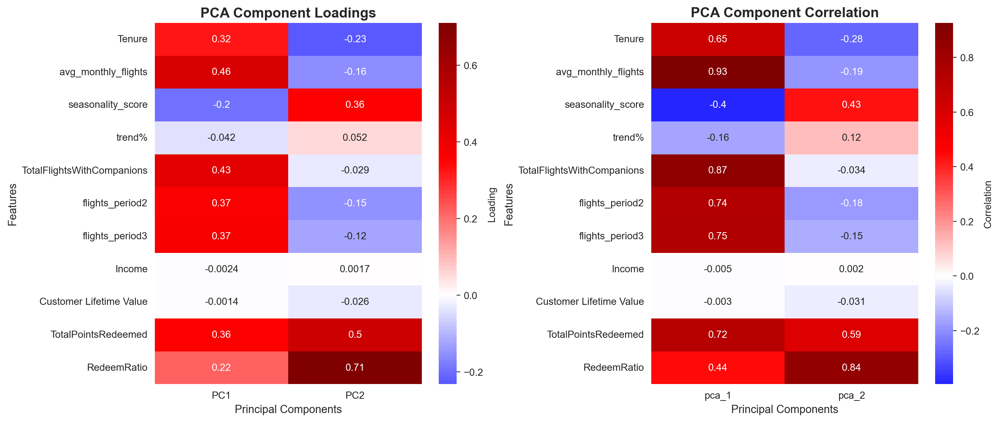

In [202]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

sns.heatmap(loadings, annot=True, cmap='seismic', center=0, ax=axes[0], 
            cbar_kws={'label': 'Loading'})
axes[0].set_title('PCA Component Loadings', fontsize=14, weight='bold')
axes[0].set_xlabel('Principal Components', fontsize=11)
axes[0].set_ylabel('Features', fontsize=11)

sns.heatmap(pc_corr, annot=True, cmap='seismic', center=0, ax=axes[1],
            cbar_kws={'label': 'Correlation'})
axes[1].set_title('PCA Component Correlation', fontsize=14, weight='bold')
axes[1].set_xlabel('Principal Components', fontsize=11)
axes[1].set_ylabel('Features', fontsize=11)

plt.tight_layout()
plt.show()

**PCA Component Interpretation: Customer Positioning**

The two principal components define a 2D behavioral space where customer position reveals engagement patterns:

**PC1 (39.2% variance)** measures **engagement intensity** - high values indicate frequent, established, active customers while low values indicate minimal activity.

**PC2 (13.8% variance)** measures **engagement style** - high values indicate strategic, seasonal, redemption-focused behavior while low values indicate year-round consistent patterns.

Together, PC1 and PC2 create a coordinate system that translates 11 behavioral features into an interpretable map: a customer's (PC1, PC2) position immediately reveals both their activity level and how they engage with the airline.

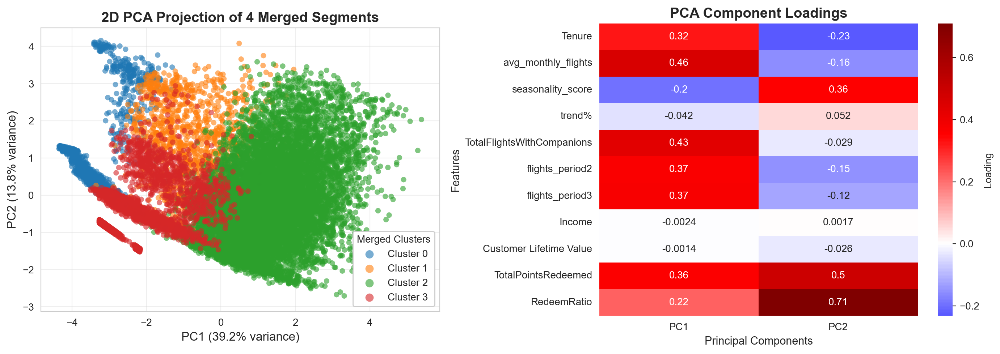

In [203]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

ax = axes[0]
for label in sorted(df_pca['merged_labels'].unique()):
    cluster_data = df_pca[df_pca['merged_labels'] == label]
    ax.scatter(
        cluster_data['pca_1'],
        cluster_data['pca_2'],
        c=[colors[label]],
        alpha=0.6,
        s=30,
        edgecolors='none',
        label=f'Cluster {label}'
    )
ax.set_xlabel(f'PC1 ({var_explained[0]:.1%} variance)', fontsize=12)
ax.set_ylabel(f'PC2 ({var_explained[1]:.1%} variance)', fontsize=12)
ax.legend(loc='best', framealpha=1, title='Merged Clusters', fontsize=10, markerscale=1.5)
ax.set_title(f'2D PCA Projection of {df_pca["merged_labels"].nunique()} Merged Segments', 
             fontsize=14, weight='bold')
ax.grid(True, alpha=0.3)
ax.set_aspect('equal')

ax = axes[1]
sns.heatmap(loadings, annot=True, cmap='seismic', center=0, ax=ax,
            cbar_kws={'label': 'Loading'})
ax.set_title('PCA Component Loadings', fontsize=14, weight='bold')
ax.set_xlabel('Principal Components', fontsize=11)
ax.set_ylabel('Features', fontsize=11)

plt.tight_layout()
plt.show()

The combined visualization reveals how principal components map to cluster characteristics:

|               | **PC1 Low (Low Engagement)**  | **PC1 High (High Engagement)** |
|---------------|-------------------------------|--------------------------------|
| **PC2 High (Strategic/Seasonal)** | Low activity + High seasonality + High redemption | Moderate activity + Strategic program usage |
| **PC2 Low (Consistent/Organic)** | Low activity + Declining patterns + Minimal engagement | High activity + Year-round consistency + Established loyalty |

**Cluster 1 Profile (High-Growth) - Principal Component Description:**

**PC1: Moderate-to-Low (-1 to 0)** - Below-average engagement intensity, reflecting recent membership and moderate current flight frequency.

**PC2: High (+2 to +4)** - Elevated program engagement style, driven by high RedeemRatio (0.71 loading on PC2) and strategic point usage.

**Interpretation:** Cluster 1 occupies the upper-middle region - transitional customers with moderate activity (PC1) but highly strategic program usage (PC2), positioned between low-engagement (left) and established active (right).

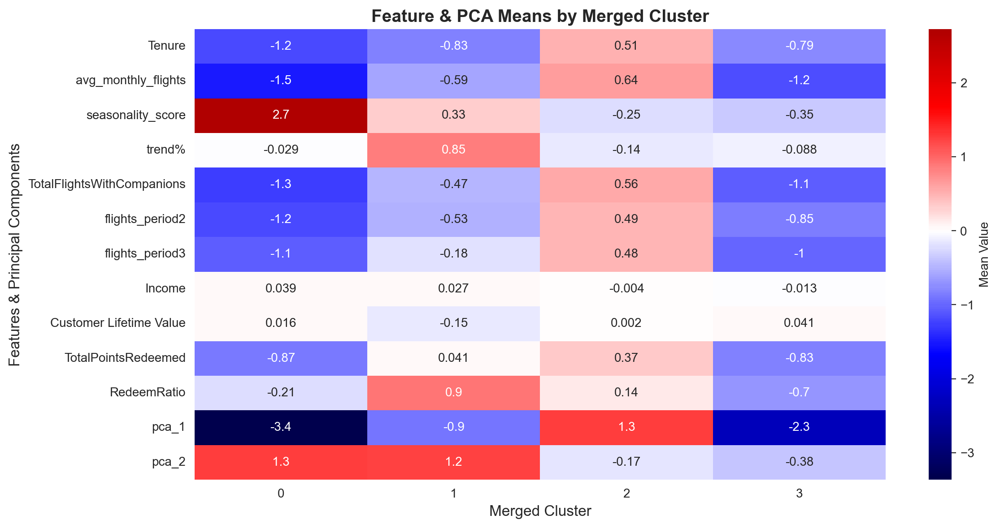

In [205]:
pc_cluster = df[metric_features + ['merged_labels', 'pca_1', 'pca_2']].groupby('merged_labels').mean().round(3).T

fig, ax = plt.subplots(figsize=(12, 6))
sns.heatmap(pc_cluster, annot=True, cmap='seismic', center=0, ax=ax,
            cbar_kws={'label': 'Mean Value'})
ax.set_title('Feature & PCA Means by Merged Cluster', fontsize=14, weight='bold')
ax.set_xlabel('Merged Cluster', fontsize=12)
ax.set_ylabel('Features & Principal Components', fontsize=12)
plt.tight_layout()
plt.show()

The PCA scores perfectly align with cluster behavioral profiles, validating both the clustering and PCA interpretation:

**PC1 (Engagement Intensity) Validation:**

- **Cluster 2** (pca_1 = +1.3): Highest engagement - avg_monthly_flights (+0.64), Tenure (+0.51), TotalFlightsWithCompanions (+0.56). Active Core confirmed.
- **Cluster 1** (pca_1 = -0.90): Moderate-low engagement - avg_monthly_flights (-0.59), Tenure (-0.83). Emerging High-Growth positioning validated.
- **Cluster 3** (pca_1 = -2.3): Very low engagement - avg_monthly_flights (-1.17), Tenure (-0.79). At-Risk profile confirmed.
- **Cluster 0** (pca_1 = -3.4): Lowest engagement - avg_monthly_flights (-1.49), extreme isolation validates Seasonal Solo minimal activity.

**PC2 (Engagement Style) Validation:**

- **Cluster 0** (pca_2 = +1.3): Extreme seasonality_score (+2.73) drives high PC2, confirming seasonal behavior despite low RedeemRatio.
- **Cluster 1** (pca_2 = +1.2): High RedeemRatio (+0.90) drives high PC2, validating strategic program usage style.
- **Cluster 2** (pca_2 = -0.17): Low seasonality_score (-0.25) and moderate RedeemRatio (+0.14) confirm year-round consistent patterns.
- **Cluster 3** (pca_2 = -0.38): Low RedeemRatio (-0.70) reflects minimal program engagement, consistent with at-risk profile.

**Key Insights:**

1. **PC1 separates by activity level**: Clear gradient from Cluster 2 (+1.28) -> Cluster 1 (-0.90) -> Cluster 3 (-2.33) -> Cluster 0 (-3.37)
2. **PC2 separates by engagement type**: Clusters 0 & 1 (strategic/seasonal, +1.2) vs. Clusters 2 & 3 (organic/consistent, negative)
3. **Cluster 0's extreme positioning**: Both lowest PC1 and highest PC2 reflects unique profile - minimal activity but extreme seasonality
4. **CLV-PC1 disconnect confirmed**: Cluster 3 has low PC1 (-2.33) but slightly positive CLV (+0.04), validating that value is independent of behavioral engagement

**Conclusion:** The PCA successfully compresses 11 features into 2 interpretable dimensions that capture the essence of cluster differences. PC1 and PC2 scores serve as reliable proxies for engagement intensity and style.

## 5.2. T-SNE

To display the clusters in a readable 2D space, **t-SNE** is used to reduce the high-dimensional data into two dimensions. This non-linear method focuses on keeping nearby points close together after projection, helping the clusters become visually clearer.

Because t-SNE depends on parameters such as **perplexity** and **learning rate**, different settings can slightly change how the clusters appear. The goal is to find values that create a stable layout where the groups are easy to distinguish without losing important relationships in the data.

In [206]:
'''# t-SNE Grid Search: Testing Perplexity Values
perplexity_values = [2, 30, 50, 100, 200]
tsne_results = {}

print("="*70)
print("t-SNE Grid Search: Testing Perplexity Values")
print("="*70)

for perp in perplexity_values:
    print(f"\nComputing t-SNE with perplexity={perp}...")
    tsne = TSNE(
        n_components=2,
        perplexity=perp,
        random_state=42,
        max_iter=1000,
        learning_rate='auto',
        init='pca'
    )
    X_tsne = tsne.fit_transform(df[metric_features])
    tsne_results[perp] = X_tsne
    
    # Evaluate with silhouette score
    score = silhouette_score(X_tsne, df['merged_labels'])
    print(f"  Silhouette score: {score:.4f}")

# Find best perplexity
print("\n" + "="*70)
best_perp = max(tsne_results.keys(), 
                key=lambda p: silhouette_score(tsne_results[p], df['merged_labels']))
best_score = silhouette_score(tsne_results[best_perp], df['merged_labels'])

print(f"Best perplexity: {best_perp}")
print(f"Best silhouette score: {best_score:.4f}")
print("="*70)

# Visualize perplexity comparison
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

# Get number of unique clusters
n_clusters = df['merged_labels'].nunique()

# Create color map
colors = cm.tab10(np.linspace(0, 1, 10))

for idx, perp in enumerate(perplexity_values):
    ax = axes[idx]
    X_tsne = tsne_results[perp]
    
    # Calculate silhouette score
    score = silhouette_score(X_tsne, df['merged_labels'])
    
    # Plot each cluster separately for legend
    for label in sorted(df['merged_labels'].unique()):
        mask = df['merged_labels'] == label
        ax.scatter(
            X_tsne[mask, 0],
            X_tsne[mask, 1],
            c=[colors[label]],
            alpha=0.6,
            s=20,
            edgecolors='none',
            label=f'Cluster {label}' if idx == 0 else ''  # Only label first subplot
        )
    
    ax.set_title(f't-SNE (perplexity={perp}, silhouette={score:.3f})', 
                 fontsize=12, weight='bold')
    ax.set_xlabel('t-SNE 1')
    ax.set_ylabel('t-SNE 2')
    ax.grid(True, alpha=0.3)

# Add legend to first subplot
axes[0].legend(loc='best', fontsize=9)

# Hide last subplot (6th position for 5 perplexities)
axes[5].set_visible(False)

fig.suptitle('t-SNE Grid Search: Perplexity Comparison', 
             fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()

# Store best result for final visualization
X_tsne_best = tsne_results[best_perp]
df['tsne_1'] = X_tsne_best[:, 0]
df['tsne_2'] = X_tsne_best[:, 1]'''

'# t-SNE Grid Search: Testing Perplexity Values\nperplexity_values = [2, 30, 50, 100, 200]\ntsne_results = {}\n\nprint("="*70)\nprint("t-SNE Grid Search: Testing Perplexity Values")\nprint("="*70)\n\nfor perp in perplexity_values:\n    print(f"\nComputing t-SNE with perplexity={perp}...")\n    tsne = TSNE(\n        n_components=2,\n        perplexity=perp,\n        random_state=42,\n        max_iter=1000,\n        learning_rate=\'auto\',\n        init=\'pca\'\n    )\n    X_tsne = tsne.fit_transform(df[metric_features])\n    tsne_results[perp] = X_tsne\n\n    # Evaluate with silhouette score\n    score = silhouette_score(X_tsne, df[\'merged_labels\'])\n    print(f"  Silhouette score: {score:.4f}")\n\n# Find best perplexity\nprint("\n" + "="*70)\nbest_perp = max(tsne_results.keys(), \n                key=lambda p: silhouette_score(tsne_results[p], df[\'merged_labels\']))\nbest_score = silhouette_score(tsne_results[best_perp], df[\'merged_labels\'])\n\nprint(f"Best perplexity: {best_perp}

Grid search tested five perplexity values (2, 30, 50, 100, 200), evaluated using silhouette scores (the above code is commented, otherwise it would take very long to run. uncomment to run):

- perplexity=2: 0.112
- perplexity=30: 0.143
- perplexity=50: 0.153
- perplexity=100: 0.172
- **perplexity=200: 0.218** 

**Decision:** Perplexity=200 selected based on highest silhouette score (0.218) and clearest visual cluster separation. For large datasets (16,687 customers), higher perplexity values better capture global structure, producing distinct cluster boundaries essential for marketing strategy visualization.

In [207]:
'''# Stability test - multiple runs with best perplexity
random_seeds = [42, 3970266, 109726]
stability_results = {}

print(f"Testing stability with perplexity={best_perp}\n")
print("="*70)

for seed in random_seeds:
    print(f"\nRun with random_state={seed}")
    tsne = TSNE(
        n_components=2,
        perplexity=best_perp,
        random_state=seed,
        max_iter=1000,
        learning_rate='auto',
        init='pca'
    )
    X_tsne = tsne.fit_transform(df[metric_features])
    stability_results[seed] = X_tsne
    
    # Calculate silhouette score
    score = silhouette_score(X_tsne, df['merged_labels'])
    print(f"  Silhouette score: {score:.4f}")

print("\n" + "="*70)

# Visualize stability comparison
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Get number of unique clusters
n_clusters = df['merged_labels'].nunique()

# Create color map
colors = cm.tab10(np.linspace(0, 1, 10))

for idx, seed in enumerate(random_seeds):
    ax = axes[idx]
    X_tsne = stability_results[seed]
    
    # Calculate silhouette score
    score = silhouette_score(X_tsne, df['merged_labels'])
    
    # Plot each cluster separately for legend
    for label in sorted(df['merged_labels'].unique()):
        mask = df['merged_labels'] == label
        ax.scatter(
            X_tsne[mask, 0],
            X_tsne[mask, 1],
            c=[colors[label]],
            alpha=0.6,
            s=20,
            edgecolors='none',
            label=f'Cluster {label}' if idx == 0 else ''  # Only label first subplot
        )
    
    ax.set_title(f't-SNE Run {idx+1} (seed={seed})\nSilhouette={score:.3f}', 
                 fontsize=12, weight='bold')
    ax.set_xlabel('t-SNE 1')
    ax.set_ylabel('t-SNE 2')
    ax.grid(True, alpha=0.3)

# Add legend to first subplot
axes[0].legend(loc='best', fontsize=9)

fig.suptitle(f't-SNE Stability Test (perplexity={best_perp})', 
             fontsize=14, weight='bold')

plt.tight_layout()
plt.show()'''

'# Stability test - multiple runs with best perplexity\nrandom_seeds = [42, 3970266, 109726]\nstability_results = {}\n\nprint(f"Testing stability with perplexity={best_perp}\n")\nprint("="*70)\n\nfor seed in random_seeds:\n    print(f"\nRun with random_state={seed}")\n    tsne = TSNE(\n        n_components=2,\n        perplexity=best_perp,\n        random_state=seed,\n        max_iter=1000,\n        learning_rate=\'auto\',\n        init=\'pca\'\n    )\n    X_tsne = tsne.fit_transform(df[metric_features])\n    stability_results[seed] = X_tsne\n\n    # Calculate silhouette score\n    score = silhouette_score(X_tsne, df[\'merged_labels\'])\n    print(f"  Silhouette score: {score:.4f}")\n\nprint("\n" + "="*70)\n\n# Visualize stability comparison\nfig, axes = plt.subplots(1, 3, figsize=(18, 5))\n\n# Get number of unique clusters\nn_clusters = df[\'merged_labels\'].nunique()\n\n# Create color map\ncolors = cm.tab10(np.linspace(0, 1, 10))\n\nfor idx, seed in enumerate(random_seeds):\n    ax =

---

**t-SNE Stability Test Results** (once again, code above is commented)

Three independent runs with different random seeds (42, 3970266, 109726) produce identical results:

**Observations:**

1. **Identical silhouette scores**: All three runs achieve 0.218, confirming consistent cluster separation
2. **Visually identical projections**: Cluster positions, shapes, and spatial relationships are indistinguishable across runs
3. **PCA initialization effective**: init='pca' ensures deterministic starting configuration, producing stable embeddings

**Conclusion:**

t-SNE with perplexity=200 and PCA initialization is highly stable for this dataset. Consistency across random seeds validates that the visualization accurately represents underlying cluster structure rather than stochastic optimization artifacts. The reproducibility confirms perplexity=200 as the optimal choice for customer segmentation visualization.

In [208]:
tsne = TSNE(n_components=2, random_state=42, perplexity=200, max_iter=1000, 
            init='pca', learning_rate='auto')
two_dim = tsne.fit_transform(df[metric_features])

# Add t-SNE components to dataframe
df['tsne_1'] = two_dim[:, 0]
df['tsne_2'] = two_dim[:, 1]

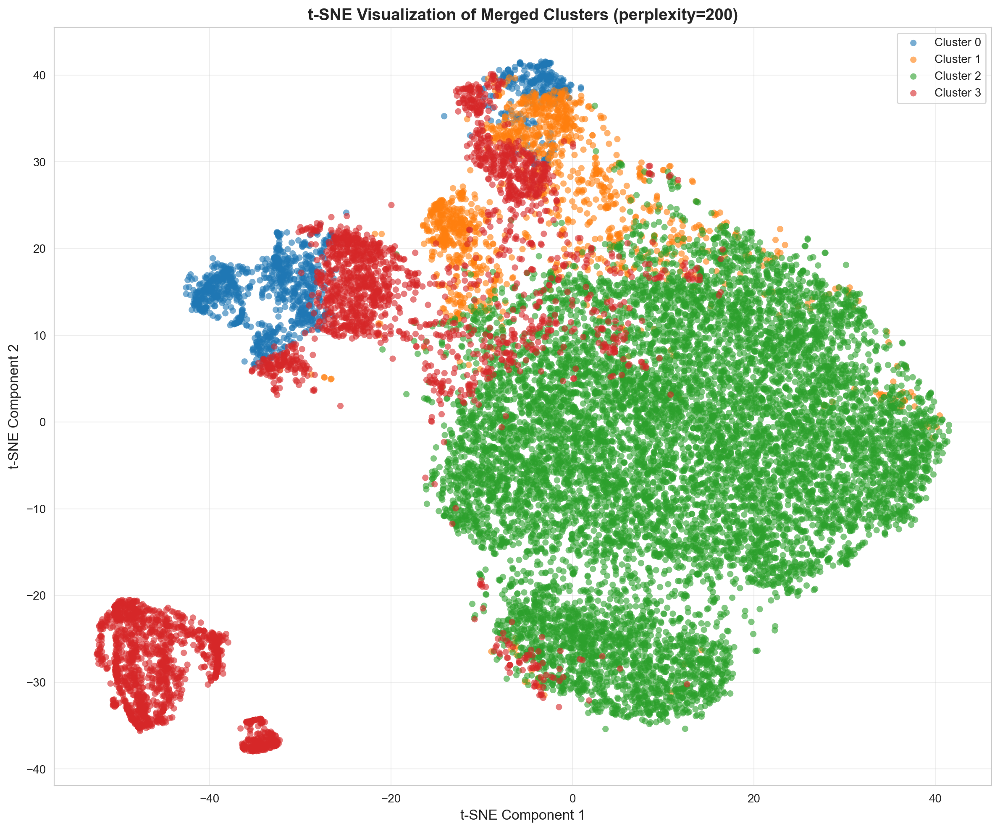

In [209]:
fig, ax = plt.subplots(figsize=(12, 10))

colors = cm.tab10(np.linspace(0, 1, 10))

# Plot each cluster separately for proper legend
for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    ax.scatter(
        df.loc[mask, 'tsne_1'],
        df.loc[mask, 'tsne_2'],
        c=[colors[label]],
        label=f'Cluster {label}',
        alpha=0.6,
        s=30,
        edgecolors='none'
    )

ax.set_xlabel('t-SNE Component 1', fontsize=12)
ax.set_ylabel('t-SNE Component 2', fontsize=12)
ax.set_title(f't-SNE Visualization of Merged Clusters (perplexity={200})', 
             fontsize=14, fontweight='bold')
ax.legend(loc='best', fontsize=10)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

The t-SNE projection shows four spatially distinct clusters: Cluster 2 (green, largest, right side) represents Established Active Core, Cluster 3 (red, fragmented) shows At-Risk customers, Cluster 0 (blue, upper-left) captures Seasonal Solo travelers, and Cluster 1 (orange, center-top) represents High-Growth segment.

**Can we rely on distance between clusters to assess similarity?**

No. t-SNE preserves local structure within clusters but distorts global distances between clusters through non-linear transformation. Clusters appearing close may not be truly similar in the original feature space. Example: Clusters 0 and 1 appear spatially close but have fundamentally different profiles (extreme seasonality vs. high growth trajectory).

## 5.3. U-MAP

To visualize the clusters in a clear 2D space, **UMAP** is applied to reduce the high-dimensional data into two dimensions. This non-linear method aims to preserve both local and global structure, often producing well-separated and stable cluster layouts.

In [210]:
'''#  UMAP with different n_neighbors
n_neighbors_values = [2, 10, 15, 30, 50, 100]
umap_results = {}

print("Running UMAP with different n_neighbors values\n")

for n_neigh in n_neighbors_values:
    print(f"Computing UMAP with n_neighbors={n_neigh}")
    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=n_neigh,
        min_dist=0.1,
        random_state=42,
        n_jobs=-1
    )
    X_umap = reducer.fit_transform(df[metric_features])
    umap_results[n_neigh] = X_umap

# Visualize n_neighbors comparison
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

# Get number of unique clusters
n_clusters = df['merged_labels'].nunique()

# Create color map
colors = cm.tab10(np.linspace(0, 1, 10))

for idx, n_neigh in enumerate(n_neighbors_values):
    ax = axes[idx]
    X_umap = umap_results[n_neigh]
    
    # Calculate silhouette score
    score = silhouette_score(X_umap, df['merged_labels'])
    
    # Plot each cluster separately for legend
    for label in sorted(df['merged_labels'].unique()):
        mask = df['merged_labels'] == label
        ax.scatter(
            X_umap[mask, 0],
            X_umap[mask, 1],
            c=[colors[label]],
            alpha=0.6,
            s=20,
            edgecolors='none',
            label=f'Cluster {label}' if idx == 0 else ''  # Only label first subplot
        )
    
    ax.set_title(f'UMAP (n_neighbors={n_neigh}, silhouette={score:.3f})', 
                 fontsize=12, weight='bold')
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    ax.grid(True, alpha=0.3)

# Add legend to first subplot
axes[0].legend(loc='best', fontsize=9)

fig.suptitle('UMAP Grid Search: n_neighbors Comparison', 
             fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()'''

'#  UMAP with different n_neighbors\nn_neighbors_values = [2, 10, 15, 30, 50, 100]\numap_results = {}\n\nprint("Running UMAP with different n_neighbors values\n")\n\nfor n_neigh in n_neighbors_values:\n    print(f"Computing UMAP with n_neighbors={n_neigh}")\n    reducer = umap.UMAP(\n        n_components=2,\n        n_neighbors=n_neigh,\n        min_dist=0.1,\n        random_state=42,\n        n_jobs=-1\n    )\n    X_umap = reducer.fit_transform(df[metric_features])\n    umap_results[n_neigh] = X_umap\n\n# Visualize n_neighbors comparison\nfig, axes = plt.subplots(2, 3, figsize=(18, 10))\naxes = axes.flatten()\n\n# Get number of unique clusters\nn_clusters = df[\'merged_labels\'].nunique()\n\n# Create color map\ncolors = cm.tab10(np.linspace(0, 1, 10))\n\nfor idx, n_neigh in enumerate(n_neighbors_values):\n    ax = axes[idx]\n    X_umap = umap_results[n_neigh]\n\n    # Calculate silhouette score\n    score = silhouette_score(X_umap, df[\'merged_labels\'])\n\n    # Plot each cluster sep

---

Grid search tested six n_neighbors values (2, 10, 15, 30, 50, 100), evaluated using silhouette scores (code above commented):

- n_neighbors=2: 0.033 (too local, scattered)
- **n_neighbors=10: 0.273** (best)
- n_neighbors=15: 0.206
- n_neighbors=30: 0.227
- n_neighbors=50: 0.216
- n_neighbors=100: 0.153 (too global, compressed)

**Decision:** n_neighbors=10 selected based on highest silhouette score (0.273) and superior visual cluster separation. This value provides optimal balance between local structure preservation and global topology, producing distinct, well-separated clusters with minimal overlap. Cluster 2 (Established Active Core) forms a clear, compact region while smaller clusters (0, 1, 3) maintain clear boundaries.

In [211]:
'''# UMAP with different min_dist
min_dist_values = [0.0, 0.1, 0.25, 0.5, 0.75, 0.99]
umap_mindist_results = {}

print("Running UMAP with different min_dist values...\n")
print("="*70)

for min_d in min_dist_values:
    print(f"\nComputing UMAP with min_dist={min_d}")
    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=10,  # Using best n_neighbors from previous test
        min_dist=min_d,
        random_state=42,
        n_jobs=-1
    )
    X_umap = reducer.fit_transform(df[metric_features])
    umap_mindist_results[min_d] = X_umap
    
    # Calculate silhouette score
    score = silhouette_score(X_umap, df['merged_labels'])
    print(f"  Silhouette score: {score:.4f}")

print("\n" + "="*70)

# Visualize min_dist comparison
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

# Create color map
colors = cm.tab10(np.linspace(0, 1, 10))

for idx, min_d in enumerate(min_dist_values):
    ax = axes[idx]
    X_umap = umap_mindist_results[min_d]
    
    # Calculate silhouette score
    score = silhouette_score(X_umap, df['merged_labels'])
    
    # Plot each cluster separately for legend
    for label in sorted(df['merged_labels'].unique()):
        mask = df['merged_labels'] == label
        ax.scatter(
            X_umap[mask, 0],
            X_umap[mask, 1],
            c=[colors[label]],
            alpha=0.6,
            s=20,
            edgecolors='none',
            label=f'Cluster {label}' if idx == 0 else ''
        )
    
    ax.set_title(f'UMAP (min_dist={min_d}, silhouette={score:.3f})', 
                 fontsize=12, weight='bold')
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    ax.grid(True, alpha=0.3)

# Add legend to first subplot
axes[0].legend(loc='best', fontsize=9)

fig.suptitle(f'UMAP Grid Search: min_dist Comparison (n_neighbors=10)', 
             fontsize=16, fontweight='bold')

plt.tight_layout()
plt.show()'''

'# UMAP with different min_dist\nmin_dist_values = [0.0, 0.1, 0.25, 0.5, 0.75, 0.99]\numap_mindist_results = {}\n\nprint("Running UMAP with different min_dist values...\n")\nprint("="*70)\n\nfor min_d in min_dist_values:\n    print(f"\nComputing UMAP with min_dist={min_d}")\n    reducer = umap.UMAP(\n        n_components=2,\n        n_neighbors=10,  # Using best n_neighbors from previous test\n        min_dist=min_d,\n        random_state=42,\n        n_jobs=-1\n    )\n    X_umap = reducer.fit_transform(df[metric_features])\n    umap_mindist_results[min_d] = X_umap\n\n    # Calculate silhouette score\n    score = silhouette_score(X_umap, df[\'merged_labels\'])\n    print(f"  Silhouette score: {score:.4f}")\n\nprint("\n" + "="*70)\n\n# Visualize min_dist comparison\nfig, axes = plt.subplots(2, 3, figsize=(18, 10))\naxes = axes.flatten()\n\n# Create color map\ncolors = cm.tab10(np.linspace(0, 1, 10))\n\nfor idx, min_d in enumerate(min_dist_values):\n    ax = axes[idx]\n    X_umap = umap_

Grid search tested six min_dist values (0.0, 0.1, 0.25, 0.5, 0.75, 0.99) with n_neighbors=10, evaluated using silhouette scores (code commented):

- **min_dist=0.0: 0.296** (best) 
- min_dist=0.1: 0.273
- min_dist=0.25: 0.226
- min_dist=0.5: 0.238
- min_dist=0.75: 0.199
- min_dist=0.99: 0.182

**Decision:** min_dist=0.0 selected based on highest silhouette score (0.296) and superior visual cluster compactness. This value allows points within clusters to pack tightly together in the low-dimensional space, producing the most cohesive and well-separated regions.

**Effect of min_dist:** Lower values (0.0-0.1) create compact, tightly-clustered embeddings ideal for visualizing distinct customer segments. Higher values (0.5-0.99) prioritize uniform point distribut

**Final UMAP Configuration:** n_neighbors=10, min_dist=0.0, silhouette=0.296

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


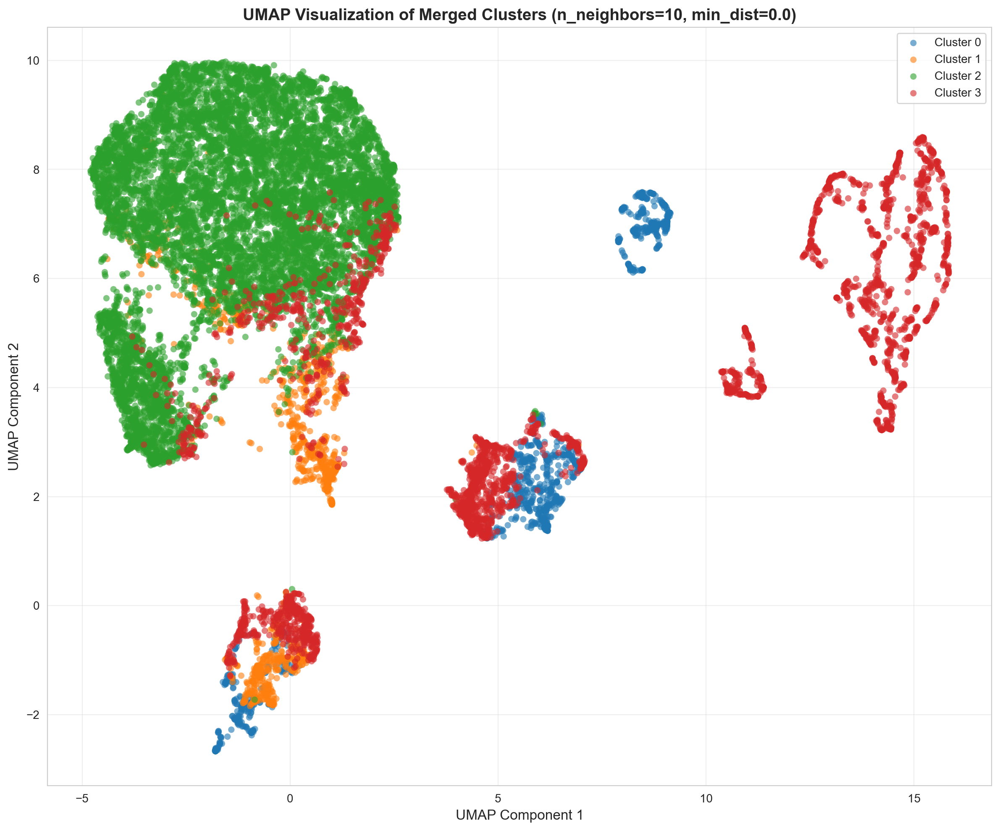

In [212]:
reducer = umap.UMAP(
    n_components=2,
    n_neighbors=10,
    min_dist=0.0,
    random_state=42,
    n_jobs=-1
)
umap_result = reducer.fit_transform(df[metric_features])

df['umap_1'] = umap_result[:, 0]
df['umap_2'] = umap_result[:, 1]

fig, ax = plt.subplots(figsize=(12, 10))

colors = cm.tab10(np.linspace(0, 1, 10))

for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    ax.scatter(
        df.loc[mask, 'umap_1'],
        df.loc[mask, 'umap_2'],
        c=[colors[label]],
        label=f'Cluster {label}',
        alpha=0.6,
        s=30,
        edgecolors='none'
    )

ax.set_xlabel('UMAP Component 1', fontsize=12)
ax.set_ylabel('UMAP Component 2', fontsize=12)
ax.set_title('UMAP Visualization of Merged Clusters (n_neighbors=10, min_dist=0.0)', 
             fontsize=14, fontweight='bold')
ax.legend(loc='best', fontsize=10)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

**UMAP Visualization Analysis**

UMAP (n_neighbors=10, min_dist=0.0, silhouette=0.296) produces highly compact, well-separated clusters superior to t-SNE (silhouette=0.218).

**Cluster Distribution:**
- **Cluster 2 (Green, 63.7%)**: Largest cohesive region, upper-left - Established Active Core
- **Cluster 3 (Red, 21%)**: Fragmented into three regions - At-Risk heterogeneity
- **Cluster 0 (Blue, 7.5%)**: Lower regions, compact - Seasonal Solo
- **Cluster 1 (Orange, 7.8%)**: Left-center, tight - High-Growth

UMAP's superior separation (0.296 vs 0.218 (t-sne)) and compact clusters provide clearer segmentation boundaries for strategic targeting.

---

**3D UMAP Visualization**

Just a cool visualization we wanted to try and to explore!


In [213]:
umap_3d = umap.UMAP(
    n_components=3,
    n_neighbors=10,
    min_dist=0.0,
    random_state=42,
    n_jobs=-1
)
proj_3d = umap_3d.fit_transform(df[metric_features])

df['umap_3d_1'] = proj_3d[:, 0]
df['umap_3d_2'] = proj_3d[:, 1]
df['umap_3d_3'] = proj_3d[:, 2]

colors_hex = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

fig_3d = go.Figure()

for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    fig_3d.add_trace(go.Scatter3d(
        x=proj_3d[mask, 0],
        y=proj_3d[mask, 1],
        z=proj_3d[mask, 2],
        mode='markers',
        name=f'Cluster {label}',
        marker=dict(
            size=3,
            color=colors_hex[label],
            opacity=0.6
        )
    ))

fig_3d.update_layout(
    title='3D UMAP Visualization (n_neighbors=10, min_dist=0.0)',
    scene=dict(
        xaxis_title='UMAP Dimension 1',
        yaxis_title='UMAP Dimension 2',
        zaxis_title='UMAP Dimension 3'
    ),
    height=700,
    width=900
)

fig_3d.show()

## 5.4 Multi-method Comparison

Three dimensionality reduction techniques validate cluster structure: PCA (linear, interpretable), t-SNE (local neighborhoods), and UMAP (balanced local-global topology).

**Why multi-method comparison?** Multiple methods provide validation confidence - consistent patterns across techniques strengthen segmentation quality. This approach avoids over-interpreting single-method artifacts while confirming genuinely distinct customer segments for targeted marketing strategies.

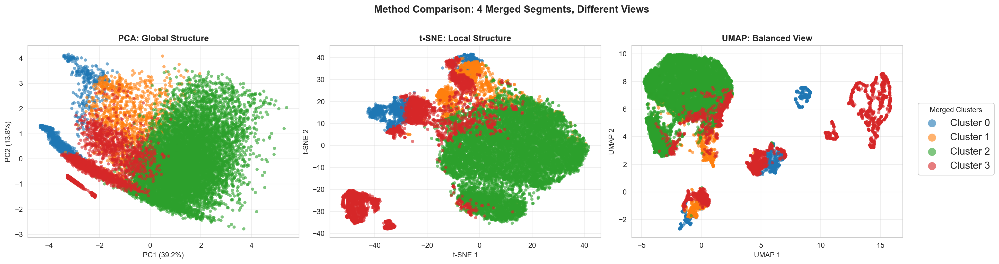

In [214]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))

n_clusters = df['merged_labels'].nunique()

colors = cm.tab10(np.linspace(0, 1, 10))


for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    axes[0].scatter(
        df.loc[mask, 'pca_1'], 
        df.loc[mask, 'pca_2'], 
        c=[colors[label]], 
        alpha=0.6, 
        s=20, 
        edgecolors='none',
        label=f'Cluster {label}'
    )
axes[0].set_title('PCA: Global Structure', fontsize=12, weight='bold')
axes[0].set_xlabel(f'PC1 ({var_explained[0]:.1%})')
axes[0].set_ylabel(f'PC2 ({var_explained[1]:.1%})')
axes[0].grid(True, alpha=0.3)

for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    axes[1].scatter(
        two_dim[mask, 0], 
        two_dim[mask, 1], 
        c=[colors[label]], 
        alpha=0.6, 
        s=20, 
        edgecolors='none'
    )
axes[1].set_title('t-SNE: Local Structure', fontsize=12, weight='bold')
axes[1].set_xlabel('t-SNE 1')
axes[1].set_ylabel('t-SNE 2')
axes[1].grid(True, alpha=0.3)

for label in sorted(df['merged_labels'].unique()):
    mask = df['merged_labels'] == label
    axes[2].scatter(
        umap_result[mask, 0], 
        umap_result[mask, 1], 
        c=[colors[label]], 
        alpha=0.6, 
        s=20, 
        edgecolors='none'
    )
axes[2].set_title('UMAP: Balanced View', fontsize=12, weight='bold')
axes[2].set_xlabel('UMAP 1')
axes[2].set_ylabel('UMAP 2')
axes[2].grid(True, alpha=0.3)

handles, labels_legend = axes[0].get_legend_handles_labels()
fig.legend(handles, labels_legend, loc='center left', bbox_to_anchor=(0.89, 0.5), 
           framealpha=1, title='Merged Clusters', fontsize=14, markerscale=2.5)

plt.suptitle(f'Method Comparison: {n_clusters} Merged Segments, Different Views', 
             fontsize=14, weight='bold', y=1.02)
plt.tight_layout()
plt.subplots_adjust(right=0.88)  # Make room for legend
plt.show()

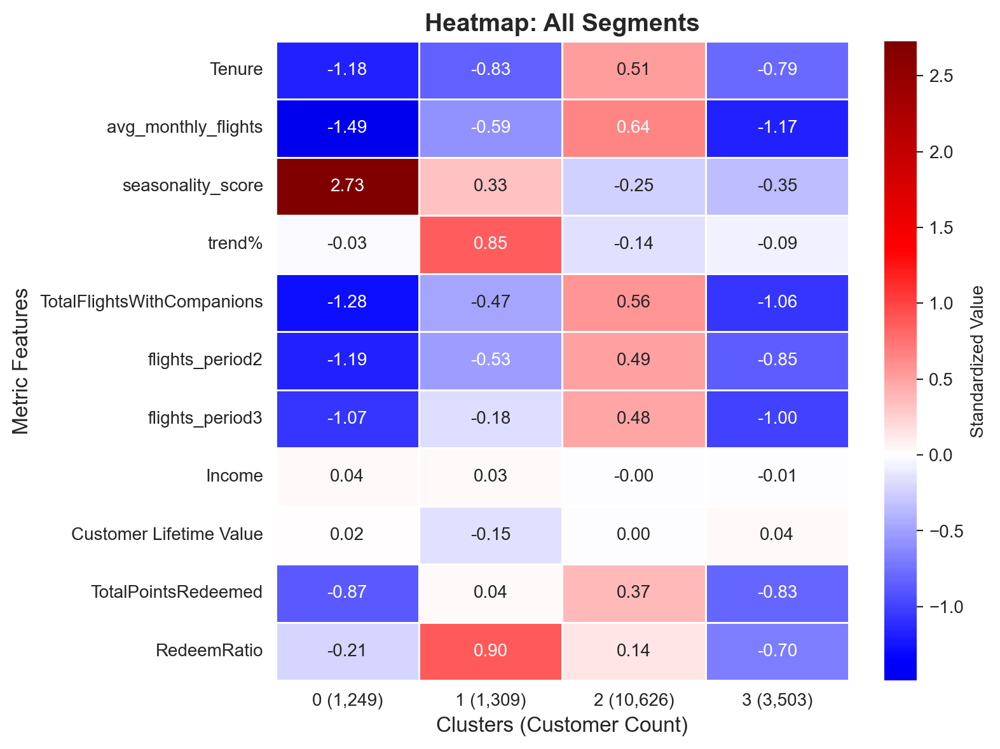

In [ ]:
all_segments = sorted(df_merged_clusters['merged_labels'].unique())
df_all_centroids = df_merged_clusters.groupby('merged_labels')[metric_features].mean()

cluster_sizes = df_merged_clusters['merged_labels'].value_counts().sort_index()

fig, ax = plt.subplots(1, 1, figsize=(8, 6))

sns.heatmap(
    df_all_centroids.T,
    ax=ax,
    annot=True,
    fmt='.2f',
    cmap='seismic',
    center=0,
    linewidths=1,
    linecolor='white',
    cbar_kws={'label': 'Standardized Value'}
)

xticklabels = [f'{cluster} ({cluster_sizes[cluster]:,})' for cluster in all_segments]
ax.set_xticklabels(xticklabels, rotation=0)

ax.set_title('Heatmap: All Segments', fontsize=14, fontweight='bold')
ax.set_ylabel('Metric Features', fontsize=12)
ax.set_xlabel('Clusters (Customer Count)', fontsize=12)
ax.grid(False)

plt.tight_layout()
plt.show()

**Where do methods agree?**

- **Cluster 2 (Green) dominance**: Largest, most cohesive across all methods - Established Active Core (63.7%)
- **Four distinct groups**: All methods maintain cluster separation
- **Cluster 3 (Red) fragmentation**: Multiple isolated regions consistently appear, confirming At-Risk heterogeneity
- **Relative proportions**: Cluster sizes consistent across techniques

**Where do methods disagree?**

- **Cluster compactness**: PCA spread (47% loss), t-SNE moderate, UMAP tightest
- **Spatial positioning**: Clusters 0, 1 appear transitional in PCA, peripheral in t-SNE/UMAP

**Overlap and sub-clusters:**

- **Overlap**: PCA shows significant center mixing, t-SNE moderate, UMAP minimal
- **Sub-clusters**: Cluster 3 consistently fragments into 2-3 regions (failed acquisition, churning premium, dormant low-value)
- **Isolated**: Cluster 0 (Seasonal Solo) most isolated in t-SNE/UMAP

**High vs. low engagement areas:**

**High engagement (right/upper regions):**
- Cluster 2 (avg_monthly_flights +0.64, companions +0.56)

**Low engagement (left/bottom regions):**
- Cluster 0 (avg_monthly_flights -1.49, extreme seasonality +2.73)
- Cluster 3 (avg_monthly_flights -1.17, declining -0.09)

**Upselling targets (buy better):**
- Cluster 0 (1,249): Off-peak conversion, increase flight frequency
- Cluster 2 (10,626): Premium cabin upgrades, increase booking value
- Cluster 1 (1,309): Fast-track to premium tiers, accelerate growth

**Cross-selling targets (buy more):**
- Cluster 2 (10,626): Family packages, group discounts, companion add-ons
- Cluster 1 (1,309): Co-branded credit cards, hotel partnerships, exclusive experiences
- Cluster 0 (1,249): Travel insurance, lounge access, bundled vacation packages

**Avoid:** Cluster 3 (3,503) - retention priority over upselling/cross-selling.

---

To validate that dimensionality reduction methods capture meaningful patterns, we visualize how key features distribute spatially across PCA, t-SNE, and UMAP. 

Four features examined: high-importance behavioral features (avg_monthly_flights, seasonality_score) expected to show clear spatial gradients, and lower-importance features (CLV, RedeemRatio) expected to show dispersed distribution. The R² values were taken from feature importances made on 4.3.1.

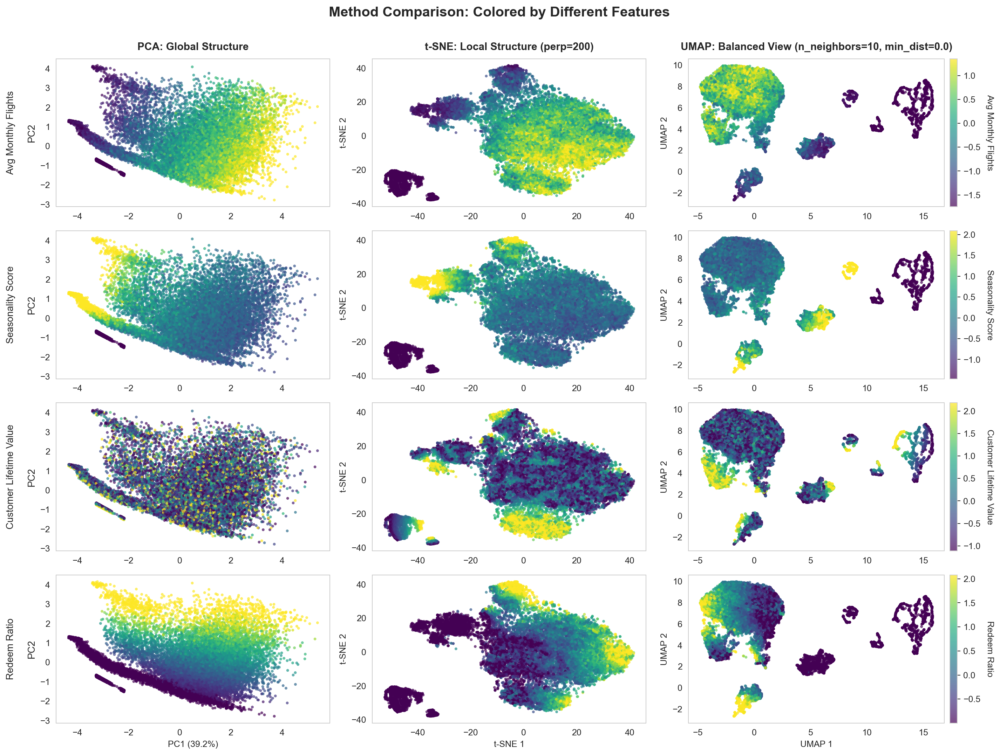

In [216]:
color_features = ['avg_monthly_flights', 'seasonality_score', 'Customer Lifetime Value', 'RedeemRatio']
feature_labels = ['Avg Monthly Flights', 'Seasonality Score', 'Customer Lifetime Value', 'Redeem Ratio']

method_titles = ['PCA: Global Structure',
                 't-SNE: Local Structure (perp=200)',
                 'UMAP: Balanced View (n_neighbors=10, min_dist=0.0)']

fig, axes = plt.subplots(
    len(color_features),
    len(method_titles),
    figsize=(16, 12),   
    dpi=90            
)

methods_data = [
    (df['pca_1'], df['pca_2'], 'PCA'),
    (df['tsne_1'], df['tsne_2'], 't-SNE'),
    (df['umap_1'], df['umap_2'], 'UMAP')
]

pca_full = PCA(n_components=2, random_state=42)
pca_full.fit(df[metric_features])
var_explained = pca_full.explained_variance_ratio_

for row_idx, (feature, feature_label) in enumerate(zip(color_features, feature_labels)):
    feature_values = df[feature]
    vmin, vmax = feature_values.quantile([0.05, 0.95])  

    for col_idx, (x_data, y_data, method_name) in enumerate(methods_data):
        ax = axes[row_idx, col_idx]

        scatter = ax.scatter(
            x_data,
            y_data,
            c=feature_values,
            cmap='viridis',
            alpha=0.7,     
            s=10,       
            edgecolors='none',
            vmin=vmin,
            vmax=vmax
        )

        if row_idx == 0:
            ax.set_title(method_titles[col_idx], fontsize=12, weight='bold', pad=10)

        if col_idx == 0:
            if method_name == 'PCA':
                ax.set_ylabel(f'{feature_label}\n\nPC2', fontsize=11)
            else:
                ax.set_ylabel(f'{feature_label}\n\n{method_name} 2', fontsize=11)
        else:
            ax.set_ylabel(f'{method_name} 2', fontsize=10)

        if row_idx == len(color_features) - 1:  # Bottom row
            if method_name == 'PCA':
                ax.set_xlabel(f'PC1 ({var_explained[0]:.1%})', fontsize=10)
            else:
                ax.set_xlabel(f'{method_name} 1', fontsize=10)

        ax.grid(False)

        if col_idx == 2:
            cbar = fig.colorbar(scatter, ax=ax, pad=0.02, aspect=20, fraction=0.046)
            cbar.set_label(feature_label, fontsize=10, rotation=270, labelpad=15)

plt.suptitle('Method Comparison: Colored by Different Features',
             fontsize=16, weight='bold', y=0.995)
plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.show()


**Avg Monthly Flights (Row 1):** Clear left-to-right gradient (purple -> yellow) across all methods validates high R² (0.74) - flight frequency creates strong spatial structure with yellow concentration in Cluster 2 region (right/upper).

**Seasonality Score (Row 2):** Yellow spikes in isolated left regions (PCA) and bottom clusters (t-SNE/UMAP) confirm extreme seasonal travelers (Cluster 0, +2.73) form distinct spatial pockets, validating high R² (0.63).

**Customer Lifetime Value (Row 3):** Uniform distribution with no spatial gradient across any method confirms near-zero R² (0.00) - CLV spatially dispersed, validating behavioral-value orthogonality.

**Redeem Ratio (Row 4):** Moderate yellow concentration in upper/center regions (Cluster 1 high-growth) shows partial spatial structure consistent with moderate R² (0.18) - program engagement creates weak but visible gradients.

**Key Insights:**

1. **High R² features show clear gradients**: Flight frequency and seasonality display distinct spatial separation across all methods
2. **Low R² features show dispersion**: CLV uniformly distributed, confirming value independence from behavioral clustering
3. **Method consistency**: PCA, t-SNE, UMAP show similar gradient patterns, strengthening cluster validity
4. **UMAP superior**: Tightest clusters create sharpest color boundaries (silhouette=0.296)

**Conclusion:** Methods successfully preserve dimensions that distinguish segments (frequency, seasonality) while demonstrating value-behavior independence.

---

<h1 style="text-align: center;">End of Notebook</h1>

<p style="text-align: center; font-size: 18px;">Thank you for your time.</p>

---